# Import

In [76]:
import numpy as np
from obspy.clients.fdsn import Client
from obspy import read, read_inventory, UTCDateTime
from obspy.signal import PPSD
from obspy.imaging.cm import *
from obspy.clients.fdsn import Client
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap, ListedColormap
import matplotlib.ticker as ticker
import matplotlib.dates as mdates
import pdart.auth as auth
from pdart.util import linear_interpolation, timing_correction
from pdart.extra_plots.plot_timing_divergence import plot_timing
import pandas as pd
import os
from collections import defaultdict
import math 
from datetime import *

client = Client('IRIS')

---
# 아폴로 15호 - 겉보기 태양 데이터 수집 (미사용)

- solar_ephemeris.asc.txt로부터 apparent solar elevation 수집

In [ ]:
df = pd.read_csv('solar_ephemeris.asc.txt', sep = '\s+', header = None)
df['Combined'] = df.apply(lambda row: str(row[0]) + ' ' + str(row[1]), axis=1)
df.drop(0, axis=1, inplace = True)
df.drop(1, axis=1, inplace = True)
df.columns = ['Apparent Solar Azimuth', 'Apparent Solar Elevation', 
              'Change in Azimuth*cos elev', 'Change in Elevation', 'UTCDateTime']
df['UTCDateTime'] = df['UTCDateTime'].map(lambda x: x.replace('Jul', '07'))
df['UTCDateTime'] = df['UTCDateTime'].map(lambda x: x.replace('Aug', '08'))
df['UTCDateTime'] = df['UTCDateTime'].map(lambda x: x.replace('Sep', '09'))
df['UTCDateTime'] = df['UTCDateTime'].map(lambda x: x.replace('Oct', '10'))
df['UTCDateTime'] = df['UTCDateTime'].map(lambda x: x.replace('Nov', '11'))
df['UTCDateTime'] = df['UTCDateTime'].map(lambda x: x.replace('Dec', '12'))
df['UTCDateTime'] = df['UTCDateTime'].map(lambda x: x.replace('Jan', '01'))
df['UTCDateTime'] = df['UTCDateTime'].map(lambda x: x.replace('Feb', '02'))
df['UTCDateTime'] = df['UTCDateTime'].map(lambda x: x.replace('Mar', '03'))
df['UTCDateTime'] = df['UTCDateTime'].map(lambda x: x.replace('Apr', '04'))
df['UTCDateTime'] = df['UTCDateTime'].map(lambda x: x.replace('May', '05'))
df['UTCDateTime'] = df['UTCDateTime'].map(lambda x: x.replace('Jun', '06'))
df['UTCDateTime'] = df['UTCDateTime'].map(lambda x: x.replace('Jun', '06'))
df['UTC'] = df['UTCDateTime'].map(lambda x: UTCDateTime(x).matplotlib_date)

df

---
# 아폴로 15호 - 표면 온도 데이터 불러오기


In [2]:
temperature = pd.read_csv('a15_temperature.txt', sep = ',')
temperature['TC12'] = temperature['TC12'].astype('float')
temperature['TC13'] = temperature['TC13'].astype('float')
temperature['TC14'] = temperature['TC14'].astype('float')

temperature['TC12'] = temperature['TC12'].map(lambda x: x - 273)
temperature['TC12'] = temperature['TC12'].replace(-10272.0, np.nan)
temperature['TC12'] = temperature['TC12'].replace(3003.6997, np.nan)
temperature['TC12'] = temperature['TC12'].replace(1005.500000, np.nan)

#temperature['Time'] = pd.to_datetime(temperature['Time'], unit = 'ms')
temperature['UTC'] = temperature['Time'].map(lambda x: UTCDateTime(x).matplotlib_date)

temperature.head(5)

,Time,TREF,TC11,TC12,TC13,TC14,flags,UTC
0,1971-07-31T19:47:58.000Z,306.50000,306.89996,61.29999,324.19995,292.00000,0,576.824977
1,1971-07-31T19:56:13.000Z,304.19995,306.79999,61.09998,324.29999,290.29999,0,576.830706
2,1971-07-31T20:03:31.000Z,303.89996,307.19995,61.39996,324.59998,289.00000,0,576.835775
3,1971-07-31T21:01:21.000Z,305.00000,307.89996,61.79999,325.19995,279.50000,0,576.875937
4,1971-07-31T21:59:22.000Z,306.19995,308.69995,62.39996,325.89996,273.39996,0,576.916227


c:\Users\neimb\anaconda3\Lib\site-packages\numpy\lib\function_base.py:1242: RuntimeWarning: divide by zero encountered in divide
  a = -(dx2)/(dx1 * (dx1 + dx2))
c:\Users\neimb\anaconda3\Lib\site-packages\numpy\lib\function_base.py:1242: RuntimeWarning: invalid value encountered in divide
  a = -(dx2)/(dx1 * (dx1 + dx2))
c:\Users\neimb\anaconda3\Lib\site-packages\numpy\lib\function_base.py:1243: RuntimeWarning: divide by zero encountered in divide
  b = (dx2 - dx1) / (dx1 * dx2)
c:\Users\neimb\anaconda3\Lib\site-packages\numpy\lib\function_base.py:1243: RuntimeWarning: invalid value encountered in divide
  b = (dx2 - dx1) / (dx1 * dx2)
c:\Users\neimb\anaconda3\Lib\site-packages\numpy\lib\function_base.py:1244: RuntimeWarning: divide by zero encountered in divide
  c = dx1 / (dx2 * (dx1 + dx2))
c:\Users\neimb\anaconda3\Lib\site-packages\numpy\lib\function_base.py:1244: RuntimeWarning: invalid value encountered in divide
  c = dx1 / (dx2 * (dx1 + dx2))
c:\Users\neimb\anaconda3\Lib\site-p

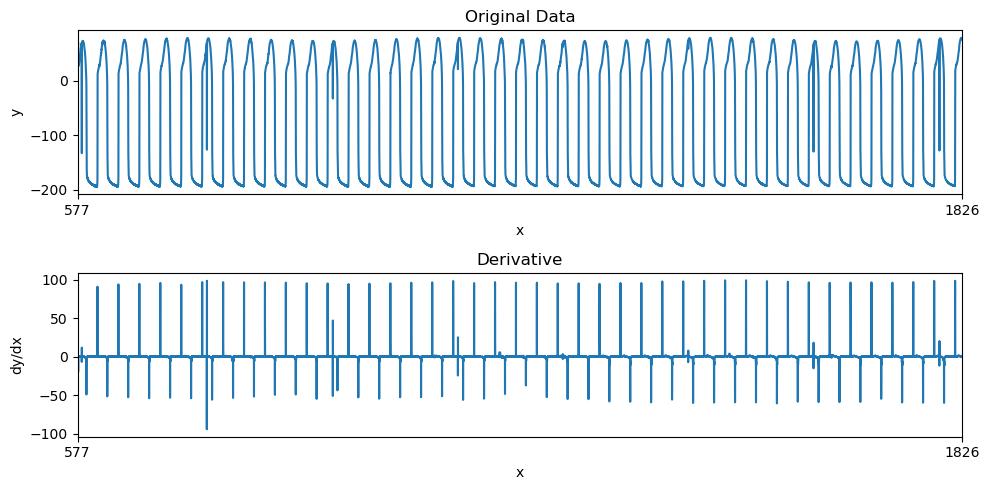

In [256]:
x = temperature.UTC.values
y = temperature.TC12.values
dx = np.gradient(y)
dy_dx = np.gradient(y, dx)

plt.figure(figsize=(10, 5))
plt.subplot(2, 1, 1)
plt.plot(x, y, label='Original Data')
plt.title('Original Data')
plt.xlabel('x')
plt.ylabel('y')
plt.xticks([x[0],x[-1]])
plt.xlim([x[0],x[-1]])

plt.subplot(2, 1, 2)
plt.plot(x, dx, label='Derivative')
plt.title('Derivative')
plt.xlabel('x')
plt.ylabel('dy/dx')
plt.xticks([x[0],x[-1]])
plt.xlim([x[0],x[-1]])

plt.tight_layout()
plt.show()

---
# 데이터 다운

In [41]:
# 일일 데이터 다운로드

def data_downloader(network, station, location, channel, starttime, endtime, number):

    for i in range(number):

        print(starttime, endtime)

        #inv = client.get_stations(starttime=starttime, endtime=endtime, network=network, station=station, location=location, channel=channel, level='response')
        #print(inv)
        
        try:

            st = client.get_waveforms(network, station, location, channel, starttime, endtime)
            timeformat = starttime.strftime('%Y%m%d%H%M')

            '''
            for tr in st:
                linear_interpolation(tr,interpolation_limit=None)
            
            st.merge(fill_value='interpolate')
            '''
            print(st)
            st.write(network + "." + station + "..MH2." + timeformat + ".mseed", format = "MSEED")
            print("hi")
            '''
            if starttime == UTCDateTime('1972-01-01T00:00:00.0'):
                starttime = starttime + (60 * 60 * 24 * 366)
                endtime = endtime + (60 * 60 * 24 * 365)

            elif starttime == UTCDateTime('1976-01-01T00:00:00.0'):
                starttime = starttime + (60 * 60 * 24 * 366)
                endtime = endtime + (60 * 60 * 24 * 365)

            else :
                starttime = starttime + (60 * 60 * 24 * 365)
                endtime = endtime + (60 * 60 * 24 * 365)
            '''
        except :
            print('error')
            if starttime == UTCDateTime('1976-01-01T00:00:00.0'):
                starttime = starttime + (60 * 60 * 24 * 366)
                endtime = endtime + (60 * 60 * 24 * 365)

            else :
                starttime = starttime + (60 * 60 * 24 * 365)
                endtime = endtime + (60 * 60 * 24 * 365)
            continue


In [ ]:
data_downloader(network = 'XA', station = 'S15', location = '*', channel = 'MHZ', 
                starttime = UTCDateTime('1974-01-01T00:00:00.0'), endtime = UTCDateTime('1975-01-01T00:00:00.0'), number = 1)

In [ ]:
# 데이터 전처리 및 병합, PPSD 객체 생성

starttime=UTCDateTime('1972-01-01T00:00:00.0') 
endtime=UTCDateTime('1978-01-01T00:00:00.0')
network='XA'
sta='S15'
loc='*'
channel='MH2'

mseed_list = os.listdir("stream_15_MH2/")

for mseed in mseed_list:

    '''
    if mseed == 'XA.S12..MH2.197001010000.mseed':
        continue

    if mseed == 'XA.S12..MH2.197101010000.mseed':
        continue

    if mseed == 'XA.S12..MH2.197201010000.mseed':
        continue
    
    if mseed == 'XA.S12..MH2.197301010000.mseed':
        continue
    '''
    if mseed == 'XA.S12..MH2.197501010000.mseed':
        break

    
    st = read("stream_15_MH2/" + mseed)
    
    for tr in st:
        linear_interpolation(tr, interpolation_limit = None)
    st.merge(fill_value= 'interpolate')
    print(st)

    '''
    st.write(mseed[12:16] + 'merged.mseed')
    '''
    
    tr = st[0]
    inv = client.get_stations(starttime=starttime, endtime=endtime, network=network, 
                              sta=sta, loc=loc, channel=channel, level="response")
    
    ppsd = PPSD(tr.stats, metadata= inv, skip_on_gaps= True, ppsd_length = 3600 * 144, overlap = 0.5)
    ppsd.add(tr)
    ppsd.save_npz(mseed[12:16] + '144hrmerged')
    
    '''
    for i in [0.5, 0.75, 0.8]:
        ppsd = PPSD(tr.stats, metadata= inv, skip_on_gaps= True, ppsd_length = 3600 * 24 * 2, overlap = i)
        ppsd.add(tr)
        if i == 0.5:
            ppsd.save_npz(mseed[12:16] + '48hrmerged')
        if i == 0.75:
            ppsd.save_npz(mseed[12:16] + '48hr75merged')
        if i == 0.8:
            ppsd.save_npz(mseed[12:16] + '48hr80merged')
    '''
    '''
    tr = st[1]
    inv = client.get_stations(starttime=starttime, endtime=endtime, network=network, 
                              sta=sta, loc=loc, channel=channel, level="response")
    ppsd2 = PPSD(tr.stats, metadata= inv, skip_on_gaps= True, ppsd_length = 3600 * 24)
    ppsd2.add(tr)
    ppsd2.save_npz(mseed[12:16] + 'flat24hrmerged')
    '''

---
# 스펙트로그램

In [3]:
# 스펙트로그램
# from obspy

def plot_spectrogram2(ppsd, cmap=obspy_sequential, clim=None, 
                      grid=True,filename=None, freqmin, freqmax, show=True):
    import matplotlib.pyplot as plt
    from obspy.imaging import util
    plt.style.use(['default'])

    fig, ax = plt.subplots(figsize= (15,5))
    quadmeshes = []


    yedges = 1 / ppsd.period_xedges
    filtered_yedges = yedges[(yedges >= freqmin) & (yedges <= freqmax)]


    for times, psds in ppsd._get_gapless_psd():
        xedges = [t.matplotlib_date for t in times] + \
            [(times[-1] + ppsd.step).matplotlib_date]
        meshgrid_x, meshgrid_y = np.meshgrid(xedges, yedges)
        data = np.array(psds).T
        quadmesh = ax.pcolormesh(meshgrid_x, meshgrid_y, data, cmap=cmap,
                                 zorder=-1)
        quadmeshes.append(quadmesh)

    if clim is None:
        cmin = min(qm.get_clim()[0] for qm in quadmeshes)
        cmax = max(qm.get_clim()[1] for qm in quadmeshes)
        clim = (cmin, cmax)

    for quadmesh in quadmeshes:
        quadmesh.set_clim(*clim)

    cb = plt.colorbar(quadmesh, ax=ax)
    if grid:
        ax.grid()
    if ppsd.special_handling is None:
        cb.ax.set_ylabel('Amplitude [$m^2/s^4/Hz$] [dB]')
    elif ppsd.special_handling == "infrasound":
        ax.set_ylabel('Amplitude [$Pa^2/Hz$] [dB]')
    else:
        cb.ax.set_ylabel('Amplitude [dB]')

    ax.set_ylabel('Frequency [Hz]')

    fig.autofmt_xdate()

    util._set_xaxis_obspy_dates(ax)

    #ax.set_yscale("log")
    ax.set_xlim(ppsd.times_processed[0].matplotlib_date,
                (ppsd.times_processed[-1] + ppsd.step).matplotlib_date)
    ax.set_ylim(yedges[0], yedges[-1])
    ax.invert_yaxis()
    ax.set_yscale("log")
    ax.tick_params(axis='x', labelsize=20)
    ax.tick_params(axis='y', labelsize=20)
    ax.set_xlabel('Time', fontsize=20)
    ax.set_ylabel('Frequency [Hz]', fontsize=20)

    try:
        ax.set_facecolor('0.8')
    # mpl <2 has different API for setting Axes background color
    except AttributeError:
        ax.set_axis_bgcolor('0.8')
    fig.tight_layout()
    if filename is not None:
        plt.savefig(filename)
        plt.close()
    elif show:
        plt.draw()
        plt.show()
    else:
        plt.draw()
        return fig


SyntaxError: non-default argument follows default argument (1477695926.py, line 5)

In [285]:
# 스펙트로그램
# from obspy

def plot_spectrogram3(ppsd, freqmin, freqmax, cmap=obspy_sequential, clim=None, 
                      grid=True, filename=None, show=True):
    import matplotlib.pyplot as plt
    from obspy.imaging import util
    plt.style.use(['default'])

    fig, ax = plt.subplots(figsize= (8,3))
    quadmeshes = []


    yedges = 1 / ppsd.period_xedges
    filtered_yedges = yedges[(yedges >= freqmin) & (yedges <= freqmax)]


    for times, psds in ppsd._get_gapless_psd():
        xedges = [t.matplotlib_date for t in times] + \
            [(times[-1] + ppsd.step).matplotlib_date]
        meshgrid_x, meshgrid_y = np.meshgrid(xedges, yedges)
        data = np.array(psds).T
        quadmesh = ax.pcolormesh(meshgrid_x, meshgrid_y, data, cmap=cmap,
                                 zorder=-1)
        quadmeshes.append(quadmesh)

    if clim is None:
        cmin = min(qm.get_clim()[0] for qm in quadmeshes)
        cmax = max(qm.get_clim()[1] for qm in quadmeshes)
        clim = (cmin, cmax)

    for quadmesh in quadmeshes:
        quadmesh.set_clim(*clim)

    cb = plt.colorbar(quadmesh, ax=ax)
    cb.set_ticks([-190,-180, -170, -160])

    if grid:
        ax.grid()
    if ppsd.special_handling is None:
        cb.ax.set_ylabel('Amplitude [$m^2/s^4/Hz$] [dB]')
    elif ppsd.special_handling == "infrasound":
        ax.set_ylabel('Amplitude [$Pa^2/Hz$] [dB]')
    else:
        cb.ax.set_ylabel('Amplitude [dB]')

    ax.set_ylabel('Frequency [Hz]')

    #fig.autofmt_xdate()

    util._set_xaxis_obspy_dates(ax)

    #ax.set_yscale("log")
    ax.set_xlim(ppsd.times_processed[0].matplotlib_date,
                (ppsd.times_processed[-1] + ppsd.step).matplotlib_date)
    ax.set_ylim(filtered_yedges[0], filtered_yedges[-1])
    ax.invert_yaxis()
    #ax.set_yscale("log")
    ax.tick_params(axis='x', labelsize=13)
    ax.tick_params(axis='y', labelsize=13)
    #ax.set_xlabel('Time', fontsize=20)
    ax.set_ylabel('Frequency [Hz]', fontsize=15)
    ax.set_yticks([0.1,0.5,1.0])

    try:
        ax.set_facecolor('0.8')
    # mpl <2 has different API for setting Axes background color
    except AttributeError:
        ax.set_axis_bgcolor('0.8')
    fig.tight_layout()
    if filename is not None:
        plt.savefig(filename)
        plt.close()
    elif show:
        plt.draw()
        plt.show()
    else:
        plt.draw()
        return fig


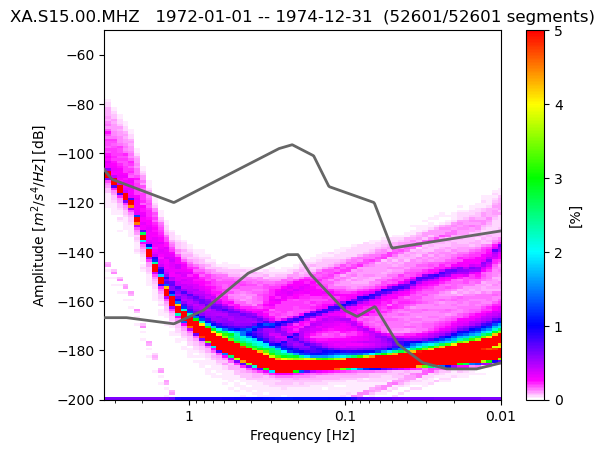

In [308]:
from obspy.imaging.cm import pqlx

ppsd = PPSD.load_npz('./npz_15_MHZ/1972merged.npz')
ppsd.add_npz('./npz_15_MHZ/1973merged.npz')
ppsd.add_npz('./npz_15_MHZ/1974merged.npz')
ppsd.plot(xaxis_frequency=True, period_lim= (3.5, 0.01), max_percentage=5, grid=False, cmap = pqlx, show_coverage = False);

c:\Users\neimb\anaconda3\Lib\site-packages\obspy\imaging\util.py:266: UserWarning: AutoDateLocator was unable to pick an appropriate interval for this date range. It may be necessary to add an interval value to the AutoDateLocator's intervald dictionary. Defaulting to 6.
  plt.setp(ax.get_xticklabels(), fontsize='small')
c:\Users\neimb\anaconda3\Lib\site-packages\obspy\signal\spectral_estimation.py:1655: UserWarning: AutoDateLocator was unable to pick an appropriate interval for this date range. It may be necessary to add an interval value to the AutoDateLocator's intervald dictionary. Defaulting to 6.
  fig.tight_layout()
c:\Users\neimb\anaconda3\Lib\site-packages\obspy\signal\spectral_estimation.py:1661: UserWarning: AutoDateLocator was unable to pick an appropriate interval for this date range. It may be necessary to add an interval value to the AutoDateLocator's intervald dictionary. Defaulting to 6.
  plt.draw()
c:\Users\neimb\anaconda3\Lib\site-packages\IPython\core\pylabtools.py

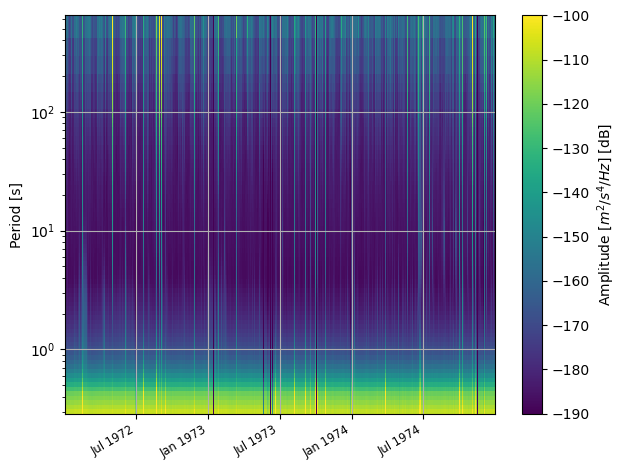

In [206]:
ppsd.plot_spectrogram(clim=(-190,-100));

In [ ]:
# plot spectrogram with original plot_spectrogram from obspy

ppsd.plot_spectrogram(grid=False, cmap='jet', clim = [-500, 0]);

c:\Users\neimb\anaconda3\Lib\site-packages\obspy\imaging\util.py:266: UserWarning: AutoDateLocator was unable to pick an appropriate interval for this date range. It may be necessary to add an interval value to the AutoDateLocator's intervald dictionary. Defaulting to 6.
  plt.setp(ax.get_xticklabels(), fontsize='small')
C:\Users\neimb\AppData\Local\Temp\ipykernel_17548\2628636213.py:70: UserWarning: AutoDateLocator was unable to pick an appropriate interval for this date range. It may be necessary to add an interval value to the AutoDateLocator's intervald dictionary. Defaulting to 6.
  fig.tight_layout()
C:\Users\neimb\AppData\Local\Temp\ipykernel_17548\2628636213.py:75: UserWarning: AutoDateLocator was unable to pick an appropriate interval for this date range. It may be necessary to add an interval value to the AutoDateLocator's intervald dictionary. Defaulting to 6.
  plt.draw()
c:\Users\neimb\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: AutoDateLocator

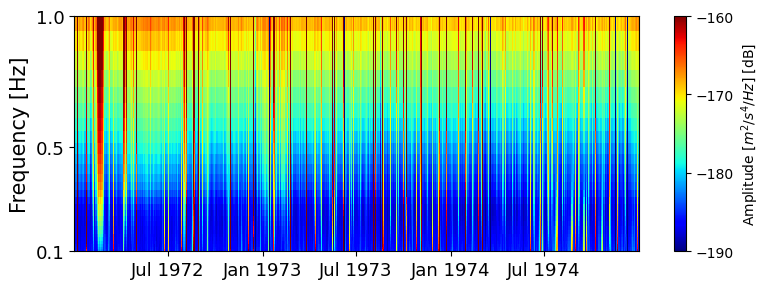

In [286]:
# plotting reversed spectrogram with plot_spectrogram2 function

plot_spectrogram3(ppsd, freqmin = 0.1, freqmax = 1.0, grid=False, cmap='jet', clim = [-190, -160]);

---
# 주기성 그래프

In [7]:
# Diurnal variation of averaged amplitude with each 1-hour windows 

import seaborn as sns
import matplotlib.dates as mdates
from datetime import *

def draw_periodicity(freq_min, freq_max, percentage, ylim_min, ylim_max, xlim_max = 100, xlim_min = 0):

    fre = ppsd.get_percentile()[0]

    freq = np.where((fre < 1 / freq_min) & (fre > 1 / freq_max))
    print(freq)


    avg_amplitude = []
    time = []

    for i in range(len(ppsd.psd_values)):
        if len(str(ppsd._times_processed[i])) == 8:
            time.append(UTCDateTime(0).matplotlib_date)
        else :    
            time.append(UTCDateTime(int(str(ppsd._times_processed[i])[:-9])).matplotlib_date)
        '''
        if str(ppsd._times_processed[i])[0] == '1':
            time.append(UTCDateTime(int(str(ppsd._times_processed[i])[:9]) + 60*30 ).matplotlib_date)
        else :    
            time.append(UTCDateTime(int(str(ppsd._times_processed[i])[:8]) + 60*30 ).matplotlib_date)
        '''
        #avg_amplitude.append(ppsd.psd_values[i][int(freq[0][0]):int(freq[0][-1])].mean())
        avg_amplitude.append(np.percentile(ppsd.psd_values[i][int(freq[0][0]):int(freq[0][-1])], percentage))
        #avg_amplitude.append(np.percentile(ppsd.psd_values[i], 15))

    fig, ax = plt.subplots(figsize = (20, 8))
    ax2 = ax.twinx()

    plt.style.use(['ggplot'])

    line1 = ax2.plot(temperature['Time'], temperature['TC2'], linewidth = 3, color = 'red', label = 'Temperature')
    #line1 = ax2.plot(df.UTC, df['Apparent Solar Elevation'], linewidth = 3, color = 'red', label = 'Apparent Solar Elevation')
    line2 = ax.plot(time, avg_amplitude, linewidth = 5, color= 'black', label = 'Averaged Amplitude')
    ax.tick_params(axis='both', which='major', labelsize=18)
    ax2.tick_params(axis='both', which='major', labelsize=18)

    ax.set_xlabel('UTCDateTime', size = 15, loc='right')
    ax2.set_ylabel('Temperature [˚C]', size = 15)
    #ax2.set_ylabel('Apparent Solar Elevation [degree]', size = 15)
    ax.set_ylabel('Averaged Amplitude [$m^2 / s^4 / Hz$] [$dB$]', size = 15)
    ax.set_title('XA.S15..MH1 [1972-01-01 ~ 1972-12-31]', size = 30, pad = 50)
    ax.set_ylim(ylim_min, ylim_max)
    ax.set_xlim(xlim_min, xlim_max)
    ax2.set_ylim(-250, 150)
    ax.set_xticks([time[7], time[27], time[47], time[67], time[87], time[107]])

    ax.grid(False)
    ax2.grid(False)
    
    '''
    lines = line1 + line2
    labels = [l.get_label() for l in lines]
    ax.legend(lines, labels, loc='upper right')

    '''
    xfmt = mdates.DateFormatter('%Y-%m-%d')
    ax.xaxis.set_major_formatter(xfmt)
    #ax.xaxis.set_minor_locator(AutoMinorLocator(4))

    return avg_amplitude, time

In [8]:
# Diurnal variation of averaged amplitude with each 1-hour windows 

import seaborn as sns
import matplotlib.dates as mdates
from datetime import *

def draw_periodicity2(freq_min, freq_max, percentage, ylim_min, ylim_max, xlim_max = 100, xlim_min = 0):

    fre = ppsd.get_percentile()[0]

    freq = np.where((fre < 1 / freq_min) & (fre > 1 / freq_max))
    print(freq)


    avg_amplitude = []
    time = []

    for i in range(len(ppsd.psd_values)):
        if len(str(ppsd._times_processed[i])) == 8:
            time.append(UTCDateTime(0).matplotlib_date)
        else :    
            time.append(UTCDateTime(int(str(ppsd._times_processed[i])[:-9])).matplotlib_date)
        '''
        if str(ppsd._times_processed[i])[0] == '1':
            time.append(UTCDateTime(int(str(ppsd._times_processed[i])[:9]) + 60*30 ).matplotlib_date)
        else :    
            time.append(UTCDateTime(int(str(ppsd._times_processed[i])[:8]) + 60*30 ).matplotlib_date)
        '''
        #avg_amplitude.append(ppsd.psd_values[i][int(freq[0][0]):int(freq[0][-1])].mean())
        avg_amplitude.append(np.percentile(ppsd.psd_values[i][int(freq[0][0]):int(freq[0][-1])], percentage))
        #avg_amplitude.append(np.percentile(ppsd.psd_values[i], 15))

    fig, ax = plt.subplots(figsize = (15, 8))
    #ax2 = ax.twinx()

    plt.style.use(['ggplot'])

    #line1 = ax2.plot(df.UTC, df['Apparent Solar Elevation'], linewidth = 3, color = 'red', label = 'Apparent Solar Elevation')
    line2 = ax.plot(time, avg_amplitude, linewidth = 5, color= 'black', label = 'Averaged Amplitude')
    ax.tick_params(axis='both', which='major', labelsize=18)
    #ax2.tick_params(axis='both', which='major', labelsize=18)

    ax.set_xlabel('UTCDateTime')
    #ax2.set_ylabel('Apparent Solar Elevation [degree]', size = 15)
    ax.set_ylabel('Averaged Amplitude [$m^2 / s^4 / Hz$] [$dB$]', size = 15)
    ax.set_title('XA.S15..MH1 (0.01Hz ~ 0.1Hz)', size = 20)
    ax.set_ylim(ylim_min, ylim_max)
    ax.set_xlim(xlim_min, xlim_max)

    ax.grid(False)
    #ax2.grid(False)
    
    '''
    lines = line1 + line2
    labels = [l.get_label() for l in lines]
    ax.legend(lines, labels, loc='upper right')

    '''
    xfmt = mdates.DateFormatter('%Y-%m-%d')
    ax.xaxis.set_major_formatter(xfmt)
    #ax.xaxis.set_minor_locator(AutoMinorLocator(4))

    return avg_amplitude, time

In [221]:
# Diurnal variation of averaged amplitude with each 1-hour windows 

import seaborn as sns
import matplotlib.dates as mdates
from datetime import *

def draw_periodicity3(freq_min, freq_max, percentage, ylim_min, ylim_max, xlim_max = 100, xlim_min = 0):

    fre = ppsd.get_percentile()[0]

    freq = np.where((fre < 1 / freq_min) & (fre > 1 / freq_max))
    print(freq)


    avg_amplitude = []
    time = []

    for i in range(len(ppsd.psd_values)):
        if len(str(ppsd._times_processed[i])) == 8:
            time.append(UTCDateTime(0).matplotlib_date)
        else :    
            time.append(UTCDateTime(int(str(ppsd._times_processed[i])[:-9])).matplotlib_date)
        '''
        if str(ppsd._times_processed[i])[0] == '1':
            time.append(UTCDateTime(int(str(ppsd._times_processed[i])[:9]) + 60*30 ).matplotlib_date)
        else :    
            time.append(UTCDateTime(int(str(ppsd._times_processed[i])[:8]) + 60*30 ).matplotlib_date)
        '''
        #avg_amplitude.append(ppsd.psd_values[i][int(freq[0][0]):int(freq[0][-1])].mean())
        avg_amplitude.append(np.percentile(ppsd.psd_values[i][int(freq[0][0]):int(freq[0][-1])], percentage))
        #avg_amplitude.append(np.percentile(ppsd.psd_values[i], 15))

    fig, ax = plt.subplots(figsize = (20, 8))
    ax2 = ax.twinx()

    plt.style.use(['ggplot'])

    line1 = ax2.plot(x, dx, linewidth = 3, color = 'red', label = 'Derivated Temperature')
    #line1 = ax2.plot(df.UTC, df['Apparent Solar Elevation'], linewidth = 3, color = 'red', label = 'Apparent Solar Elevation')
    line2 = ax.plot(time, avg_amplitude, linewidth = 5, color= 'black', label = 'Averaged Amplitude')
    ax.tick_params(axis='both', which='major', labelsize=18)
    ax2.tick_params(axis='both', which='major', labelsize=18)

    ax.set_xlabel('UTCDateTime', size = 15, loc='right')
    ax2.set_ylabel('Derivated Temperature [˚C]', size = 15)
    #ax2.set_ylabel('Apparent Solar Elevation [degree]', size = 15)
    ax.set_ylabel('Averaged Amplitude [$m^2 / s^4 / Hz$] [$dB$]', size = 15)
    ax.set_title('XA.S15..MH1 [1972-01-01 ~ 1972-12-31]', size = 30, pad = 50)
    ax.set_ylim(ylim_min, ylim_max)
    ax.set_xlim(xlim_min, xlim_max)
    ax2.set_ylim(-90, 110)

    ax.set_xticks([time[7], time[27], time[47], time[67], time[87], time[107]])

    ax.grid(False)
    ax2.grid(False)
    
    
    lines = line1 + line2
    labels = [l.get_label() for l in lines]
    ax.legend(lines, labels, loc='upper right')

    
    xfmt = mdates.DateFormatter('%Y-%m-%d')
    ax.xaxis.set_major_formatter(xfmt)
    #ax.xaxis.set_minor_locator(AutoMinorLocator(4))

    return avg_amplitude, time

In [296]:
def noise_sequence_daily(mppsd, freqmin, freqmax, median = True, figsize = (15,8), ylim = (-190,-160), title = "", ax2 = None):

    fre = mppsd.get_percentile()[0]
    freq = np.where((fre < 1 / freqmin) & (fre > 1 / freqmax))
    
    avg_amplitude = []
    avg_amplitude_25 = []
    avg_amplitude_75 = []
    time = []

    time = mppsd.current_times_used
    time = mdates.date2num([UTCDateTime(t).datetime for t in time])

    if median == True:
        for i in range(len(mppsd.psd_values)):
            avg_amplitude.append(np.median(mppsd.psd_values[i][freq[0][0]:freq[0][-1]]))
            avg_amplitude_25.append(np.quantile(mppsd.psd_values[i][freq[0][0]:freq[0][-1]], 0.25))
            avg_amplitude_75.append(np.quantile(mppsd.psd_values[i][freq[0][0]:freq[0][-1]], 0.75))

    if median == False:
        for i in range(len(mppsd.psd_values)):
            avg_amplitude.append(mppsd.psd_values[i][freq[0][0]:freq[0][-1]].mean())

    grouped_amplitudes = defaultdict(list)
    grouped_amplitudes_25 = defaultdict(list)
    grouped_amplitudes_75 = defaultdict(list)

    daily = []
    for idx, t in enumerate(time):
        grouped_amplitudes[math.floor(t)].append(avg_amplitude[idx])
        grouped_amplitudes_25[math.floor(t)].append(avg_amplitude_25[idx])
        grouped_amplitudes_75[math.floor(t)].append(avg_amplitude_75[idx])
        daily.append(math.floor(t))
        
    daily = list(set(daily))
    daily.sort()
    daily_time = daily
    avg_amplitude_median_25 = [np.median(group) for group in grouped_amplitudes_25.values()]
    avg_amplitude_median = [np.median(group) for group in grouped_amplitudes.values()]
    avg_amplitude_median_75 = [np.median(group) for group in grouped_amplitudes_75.values()]

    plt.style.use(['default'])
    fig, ax = plt.subplots(figsize = figsize)

    line1 = ax.plot(daily_time, avg_amplitude_median_25, linewidth = 1, marker = 'o', color = 'blue', label = '25%')
    line2 = ax.plot(daily_time, avg_amplitude_median, linewidth = 1, marker = 'o', color = 'green', label = '50%')
    line3 = ax.plot(daily_time, avg_amplitude_median_75, linewidth = 1, marker = 'o', color = 'red', label = '75%')
    
    ax.tick_params(axis='both', which='major', labelsize=18)
    #ax.set_xticks()
    ax.set_xlim(time[0],time[-1])
    ax.set_ylim(ylim)
    #ax.set_xlabel('UTCDateTime', size = 20, loc='right')
    ax.set_ylabel('Averaged Amplitude [$m^2 / s^4 / Hz$] [$dB$]', size = 15)
    ax.set_title(title, size = 25, pad = 50)
    ax.grid(True)

    ax.legend(loc='upper right')
    
    xfmt = mdates.DateFormatter('%Y-%m-%d')
    ax.xaxis.set_major_formatter(xfmt)
    #ax.xaxis.set_minor_locator(AutoMinorLocator(4))

    plt.show()

    return daily_time, avg_amplitude_median

In [292]:
import numpy as np
import matplotlib.pyplot as plt

def draw_periodicity4(ppsd, freq_min, freq_max, percentage, ylim_min, ylim_max):
    fre = ppsd.get_percentile()[0]

    # Ensure fre is a numpy array
    fre = np.array(fre, dtype=np.float64)

    freq = np.where((fre < 1 / freq_min) & (fre > 1 / freq_max))

    avg_amplitude = []
    time = ppsd.current_times_used
    time = mdates.date2num([UTCDateTime(t).datetime for t in time])

    for i in range(len(ppsd.psd_values)):
        # Ensure ppsd.psd_values[i] is a numpy array
        psd_values = np.array(ppsd.psd_values[i], dtype=np.float64)
        avg_amplitude.append(np.percentile(psd_values[int(freq[0][0]):int(freq[0][-1])], percentage))

    # Remove values from avg_amplitude that are less than -250 and their corresponding times
    filtered_avg_amplitude = [amp for amp in avg_amplitude if amp >= -250]
    filtered_time = [time[i] for i in range(len(avg_amplitude)) if avg_amplitude[i] >= -250]
    avg_amplitude = filtered_avg_amplitude
    time = filtered_time

    # Apply a 24-point moving average filter to avg_amplitude
    avg_amplitude_filtered = np.convolve(avg_amplitude, np.ones(24)/24, mode='valid')
    time_filtered = time[:len(avg_amplitude_filtered)]
  
    fig, ax = plt.subplots(figsize=(15, 8))

    plt.style.use(['default'])
    print(len(time_filtered))
    line1 = ax.plot(time_filtered, avg_amplitude_filtered, linewidth=0.5, color='black', label='median')
    ax.tick_params(axis='both', which='major', labelsize=20)

    #ax.set_xlabel('UTCDateTime', size=20, loc='right')
    ax.set_ylabel('Averaged Amplitude [$m^2 / s^4 / Hz$] [$dB$]', size=20)
    #ax.set_title('XA.S15..MHZ [1972-01-01 ~ 1974-12-31]', size=25)
    ax.set_xlim(time_filtered[0], time_filtered[-1])
    ax.set_ylim(ylim_min, ylim_max)

    ax.grid()

    xfmt = mdates.DateFormatter('%Y-%m-%d')
    ax.xaxis.set_major_formatter(xfmt)
    fig.autofmt_xdate()
    
    return avg_amplitude_filtered, time_filtered

In [125]:
import numpy as np
import matplotlib.pyplot as plt

def draw_periodicity5(ppsd, freq_min, freq_max, percentage, ylim_min, ylim_max):
    fre = ppsd.get_percentile()[0]

    # Ensure fre is a numpy array
    fre = np.array(fre, dtype=np.float64)

    freq = np.where((fre < 1 / freq_min) & (fre > 1 / freq_max))

    avg_amplitude = []
    time = ppsd.current_times_used
    time = mdates.date2num([UTCDateTime(t).datetime for t in time])

    for i in range(len(ppsd.psd_values)):
        # Ensure ppsd.psd_values[i] is a numpy array
        psd_values = np.array(ppsd.psd_values[i], dtype=np.float64)
        avg_amplitude.append(np.percentile(psd_values[int(freq[0][0]):int(freq[0][-1])], percentage))

    # Remove values from avg_amplitude that are less than -250 and their corresponding times
    filtered_avg_amplitude = [amp for amp in avg_amplitude if amp >= -250]
    filtered_time = [time[i] for i in range(len(avg_amplitude)) if avg_amplitude[i] >= -250]
    avg_amplitude = filtered_avg_amplitude
    time = filtered_time

    # Apply a 24-point moving average filter to avg_amplitude
    avg_amplitude_filtered = np.convolve(avg_amplitude, np.ones(48)/48, mode='valid')
    time_filtered = time[:len(avg_amplitude_filtered)]
  
    fig, ax = plt.subplots(figsize=(20, 10))

    plt.style.use(['default'])
    print(len(time_filtered))
    line1 = ax.plot(time_filtered, avg_amplitude_filtered, linewidth=0.5, color='black', label='median')
    ax.tick_params(axis='both', which='major', labelsize=18)

    #ax.set_xlabel('UTCDateTime', size=20, loc='right')
    ax.set_ylabel('Averaged Amplitude [$m^2 / s^4 / Hz$] [$dB$]', size=20)
    ax.set_title('XA.S15..MHZ [1972-01-01 ~ 1974-12-31]', size=25)
    ax.set_xlim(time_filtered[0], time_filtered[-1])
    ax.set_ylim(ylim_min, ylim_max)

    ax.grid()

    xfmt = mdates.DateFormatter('%Y-%m-%d')
    ax.xaxis.set_major_formatter(xfmt)
    fig.autofmt_xdate()
    
    return avg_amplitude_filtered, time_filtered

In [79]:
def noise_sequence_ma(mppsd, target_period, freqmin, freqmax, figsize = (20,8), title = "", ax2 = False, ax2_x = None, ax2_y = None):
    '''
    Moving average for martian background noise sequence
    mppsd : 
    s
    '''
    fre = mppsd.get_percentile()[0]
    freq = np.where((fre < 1 / freqmin) & (fre > 1 / freqmax))
    
    avg_amplitude = []
    avg_amplitude_25 = []
    avg_amplitude_75 = []
    
    time = mppsd.current_times_used
    time = mdates.date2num([UTCDateTime(t).datetime for t in time])

    for i in range(len(mppsd.psd_values)):
        avg_amplitude.append(np.median(mppsd.psd_values[i][freq[0][0]:freq[0][-1]]))
        avg_amplitude_25.append(np.quantile(mppsd.psd_values[i][freq[0][0]:freq[0][-1]], 0.25))
        avg_amplitude_75.append(np.quantile(mppsd.psd_values[i][freq[0][0]:freq[0][-1]], 0.75))

    grouped_amplitudes = defaultdict(list)
    grouped_amplitudes_25 = defaultdict(list)
    grouped_amplitudes_75 = defaultdict(list)
    
    total_avg_amplitude = []
    total_avg_amplitude_25 = []
    total_avg_amplitude_75 = []
    
    combined = []
    combined_25 = []
    combined_75 = []

    for idx, t in enumerate(time):
        grouped_amplitudes[math.floor(t)].append(avg_amplitude[idx])
        grouped_amplitudes_25[math.floor(t)].append(avg_amplitude_25[idx])
        grouped_amplitudes_75[math.floor(t)].append(avg_amplitude_75[idx])

    for idx, i in enumerate(range(int(time[0]), int(time[-2]))):
        if idx % target_period == 1:
            total_avg_amplitude.append(combined)
            total_avg_amplitude_25.append(combined_25)
            total_avg_amplitude_75.append(combined_75)
            combined = []
            combined_25 = []
            combined_75 = []
        combined.append(avg_amplitude[i]) 
        combined_25.append(avg_amplitude_25[i]) 
        combined_75.append(avg_amplitude_75[i]) 

    target_time = np.arange(int(time[0]), int(time[-2]), target_period)
    print(target_time)

    avg_amplitude_median = [np.median(group) for group in total_avg_amplitude]
    avg_amplitude_median_25 = [np.median(group) for group in total_avg_amplitude_25]
    avg_amplitude_median_75 = [np.median(group) for group in total_avg_amplitude_75]
    #avg_amplitude_weekly = [np.mean(group) for group in total_avg_amplitude]

    plt.style.use(['default'])
    fig, ax = plt.subplots(figsize = figsize)

    line1 = ax.plot(target_time, avg_amplitude_median_25, linewidth = 1, marker = 'o', color = 'blue', label = '25%')
    line2 = ax.plot(target_time, avg_amplitude_median, linewidth = 1, marker = 'o', color = 'green', label = '50%')
    line3 = ax.plot(target_time, avg_amplitude_median_75, linewidth = 1, marker = 'o', color = 'red', label = '75%')
    
    ax.tick_params(axis='both', which='major', labelsize=18)
    #ax.set_xticks()
    ax.set_xlim(time[0],time[-1])
    ax.set_ylim(-190, -160)
    ax.set_xlabel('UTCDateTime', size = 20, loc='right')
    ax.set_ylabel('Averaged Amplitude [$m^2 / s^4 / Hz$] [$dB$]', size = 15)
    ax.set_title(title, size = 25, pad = 50)
    ax.grid(True)


    if ax2 == True:
        ax2 = ax.twinx()

        
        line2 = ax2.scatter(ax2_x, ax2_y, linewidth = 3, color = 'red', label = 'Temperature')
        ax2.tick_params(axis='both', which='major', labelsize=18)
        ax2.set_ylabel('Temperature [˚C]', size = 15)
        #ax2.set_xlim(18336,18343)
        ax2.set_xlim(ax.get_xlim())
        #ax2.set_ylim(-20, 20)
        ax2.grid(False)

    
    '''
    lines = line1 + line2
    labels = [l.get_label() for l in lines]
    '''
    ax.legend(loc='best')
    
    
    xfmt = mdates.DateFormatter('%Y-%m-%d')
    ax.xaxis.set_major_formatter(xfmt)
    #ax.xaxis.set_minor_locator(AutoMinorLocator(4))

    plt.show()

    return target_time
    

---
# 푸리에 변환 -> 주기 정량적

In [4]:
def fft(avg_amplitude, time):
    plt.style.use(['bmh'])

    dft = np.fft.rfft(avg_amplitude)
    freqs = np.fft.rfftfreq(len(avg_amplitude), d=time[1]-time[0])

    plt.figure(figsize=(10, 6))
    plt.plot(1/freqs, np.abs(dft))
    plt.title('Period (DFT)', size = 20)
    plt.xlabel('Period (day)', size = 18)
    plt.ylabel('PSD', size = 18)
    #plt.xscale('log')
    #plt.xticks([0.25, 0.50, 0.75, 1.00, 1.25, 1.50, 1.75, 2.00])
    plt.xlim(5, 50)
    plt.grid(True)
    plt.xticks(size = 15)
    plt.yticks(size = 15)
    print(max(np.abs(dft)[5:]))

    '''
    for i in range(len(1/freqs)):
        height = np.abs(dft)[i]
        if height >= max(np.abs(dft)[5:]) / 2: 
            plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='right', va='bottom', size = 20)
    '''
    plt.show()

---
## 달 일일(계절) 데이터 (0.01 ~ 0.1 Hz)

In [218]:
# PSD 일일 단위로 뽑아서 중첩 후 median 도출, 푸리에 급수 피팅을 통해 median 그래프와 비교 (0.1 ~ 1.0Hz)

start= []
end= []

starttime = UTCDateTime("1972-01-01T00:00:00")
endtime = UTCDateTime("1972-01-29T12:44:30")

daily_time = []
daily_data = []

for i in range(35):
    
    ppsd = PPSD.load_npz('./npz_15_MHZ/1972merged.npz')
    ppsd.add_npz('./npz_15_MHZ/1973merged.npz')
    ppsd.add_npz('./npz_15_MHZ/1974merged.npz')
    
    mask = ppsd._stack_selection(starttime=starttime, endtime=endtime)
    ppsd._times_processed = [t for i, t in enumerate(ppsd._times_processed) if mask[i]]
    ppsd._binned_psds = [t for i, t in enumerate(ppsd._binned_psds) if mask[i]]
    #ppsd.plot(xaxis_frequency=True, period_lim= (10, 0.001), max_percentage=5, grid=False)
    
    try:
        fre = ppsd.get_percentile()[0]
    except :
        pass

    # 주파수 선택
    freq = np.where((fre < 1 / 0.01) & (fre > 1 / 0.05))
    avg_amplitude = []
    time = []

    for i in range(len(ppsd.psd_values)):
        time.append(UTCDateTime(int(str(ppsd._times_processed[i])[:10]) + 60*30 ).matplotlib_date)
        avg_amplitude.append(np.median(ppsd.psd_values[i][freq[0][0]:freq[0][-1]]))

    if len(ppsd._binned_psds) == 1417:
        daily_time.append(time)
        daily_data.append(avg_amplitude)
    
    print(f'{starttime, endtime, len(ppsd._binned_psds)}')
    start.append(starttime)
    end.append(endtime)

    
    starttime = endtime
    endtime += ((60 * 60 * 24 * 29) + (60 * 60 * 12) + (60 * 44) + 30)

(UTCDateTime(1972, 1, 1, 0, 0), UTCDateTime(1972, 1, 29, 12, 44, 30), 1370)
(UTCDateTime(1972, 1, 29, 12, 44, 30), UTCDateTime(1972, 2, 28, 1, 29), 1417)
(UTCDateTime(1972, 2, 28, 1, 29), UTCDateTime(1972, 3, 28, 14, 13, 30), 1418)
(UTCDateTime(1972, 3, 28, 14, 13, 30), UTCDateTime(1972, 4, 27, 2, 58), 1417)
(UTCDateTime(1972, 4, 27, 2, 58), UTCDateTime(1972, 5, 26, 15, 42, 30), 1418)
(UTCDateTime(1972, 5, 26, 15, 42, 30), UTCDateTime(1972, 6, 25, 4, 27), 1417)
(UTCDateTime(1972, 6, 25, 4, 27), UTCDateTime(1972, 7, 24, 17, 11, 30), 1418)
(UTCDateTime(1972, 7, 24, 17, 11, 30), UTCDateTime(1972, 8, 23, 5, 56), 1417)
(UTCDateTime(1972, 8, 23, 5, 56), UTCDateTime(1972, 9, 21, 18, 40, 30), 1418)
(UTCDateTime(1972, 9, 21, 18, 40, 30), UTCDateTime(1972, 10, 21, 7, 25), 1417)
(UTCDateTime(1972, 10, 21, 7, 25), UTCDateTime(1972, 11, 19, 20, 9, 30), 1418)
(UTCDateTime(1972, 11, 19, 20, 9, 30), UTCDateTime(1972, 12, 19, 8, 54), 1417)
(UTCDateTime(1972, 12, 19, 8, 54), UTCDateTime(1973, 1, 17, 21,

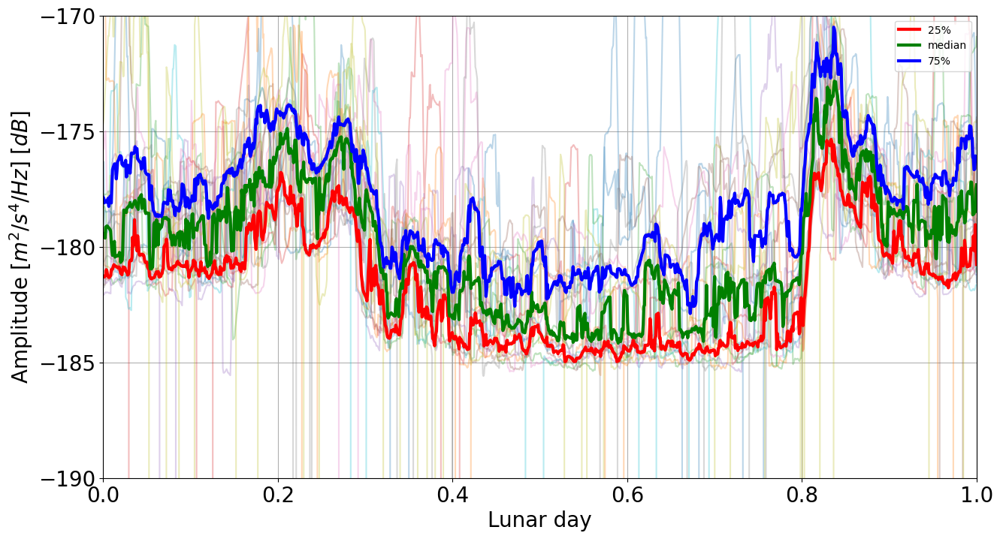

In [219]:
daily_12hour_filter_data = []
for i in range(0, len(daily_data)):
    fil = []
    for j in range(0, len(daily_data[0])):
        fil.append(daily_data[i][j : j+24])
        if j == 1394:
            break
    daily_12hour_filter_data.append(fil)
    
daily_12hour_filter_ma = [] 
for i in range(len(daily_12hour_filter_data)):
    fil = []
    for j in daily_12hour_filter_data[i]:
        fil.append(np.mean(j))

    daily_12hour_filter_ma.append(fil)


plt.figure(figsize=(15,8))
time = np.linspace(0, 1, 1395)

for day in range(len(daily_12hour_filter_ma)):
    plt.plot(time, daily_12hour_filter_ma[day], alpha = 0.3);

percentage_25 = []
median = []
percentage_75 = []
for j in range(len(daily_12hour_filter_ma[0])):
    temp = []
    for i in range(len(daily_12hour_filter_ma)):
        temp.append(daily_12hour_filter_ma[i][j])
    percentage_25.append(np.quantile(temp, 0.25))
    percentage_75.append(np.quantile(temp, 0.75))
    median.append(np.median(temp))
plt.plot(time, percentage_25, linewidth = 3, color = 'r', label = '25%')
plt.plot(time, median, linewidth = 3, color ='g', label = 'median')
plt.plot(time, percentage_75, linewidth = 3, color ='b', label = '75%')

time = np.array(time)

plt.legend(loc='upper right')
plt.xlim(0,1)
plt.ylim(-190, -170)
#plt.xticks([48.67, 48.67*2, 48.67*3, 48.67*4, 48.67*5], [1,2,3,4,5], fontsize = 15)
plt.xticks(fontsize = 20)
plt.yticks([-170, -175, -180, -185, -190], fontsize = 20)
plt.grid()
plt.xlabel('Lunar day', fontsize = 20)
plt.ylabel('Amplitude [$m^2/s^4/Hz$] [$dB$]', fontsize = 20)
plt.show()


C:\Users\neimb\AppData\Local\Temp\ipykernel_17548\636128992.py:15: IntegrationWarning: The maximum number of subdivisions (50) has been achieved.
  If increasing the limit yields no improvement it is advised to analyze 
  the integrand in order to determine the difficulties.  If the position of a 
  local difficulty can be determined (singularity, discontinuity) one will 
  probably gain from splitting up the interval and calling the integrator 
  on the subranges.  Perhaps a special-purpose integrator should be used.
  return (1 / T) * quad(median_func, 0, T)[0]
C:\Users\neimb\AppData\Local\Temp\ipykernel_17548\636128992.py:19: IntegrationWarning: The maximum number of subdivisions (50) has been achieved.
  If increasing the limit yields no improvement it is advised to analyze 
  the integrand in order to determine the difficulties.  If the position of a 
  local difficulty can be determined (singularity, discontinuity) one will 
  probably gain from splitting up the interval and call

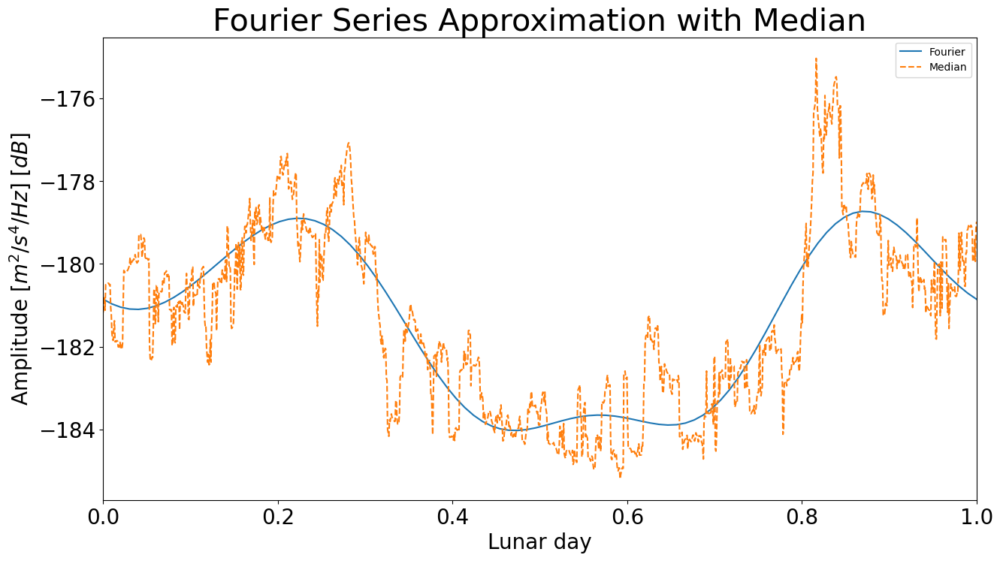

In [167]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import quad

# 주기
T = 1 # 주기 T를 설정

# median 값을 함수로 정의
def median_func(x):
    idx = int(x / T * len(median)) % len(median)
    return median[idx]

# a0 계산 
def a0(T, median_func):
    return (1 / T) * quad(median_func, 0, T)[0]

# an 계산 (n차 푸리에 계수, cos 성분)
def an(n, T, median_func):
    return (2 / T) * quad(lambda x: median_func(x) * np.cos(2 * np.pi * n * x / T), 0, T)[0]

# bn 계산 (n차 푸리에 계수, sin 성분)
def bn(n, T, median_func):
    return (2 / T) * quad(lambda x: median_func(x) * np.sin(2 * np.pi * n * x / T), 0, T)[0]

# 푸리에 급수로 근사한 함수
def fourier_series(x, terms, T, median_func):
    result = a0(T, median_func)
    for n in range(1, terms + 1): # terms는 몇 번 더할건지
        result += an(n, T, median_func) * np.cos(2 * np.pi * n * x / T) + bn(n, T, median_func) * np.sin(2 * np.pi * n * x / T)
    return result


# 푸리에 급수 계산
x_vals = np.linspace(0, T, 100)
y_fourier = [fourier_series(x, 4, T, median_func) for x in x_vals]  # 각 x 값에 대해 푸리에 급수 계산


# 결과 시각화
plt.figure(figsize=(15,8))
plt.plot(x_vals, y_fourier, label='Fourier')
plt.plot(time, median, label='Median', linestyle='--')
plt.legend()
plt.xlabel('Lunar day', fontsize = 20)
plt.ylabel('Amplitude [$m^2/s^4/Hz$] [$dB$]', fontsize = 20)
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.title('Fourier Series Approximation with Median', fontsize = 30)
plt.xlim(time[0], time[-1])
plt.show()

Text(0, 0.5, 'Amplitude [$m^2/s^4/Hz$] [$dB$]')

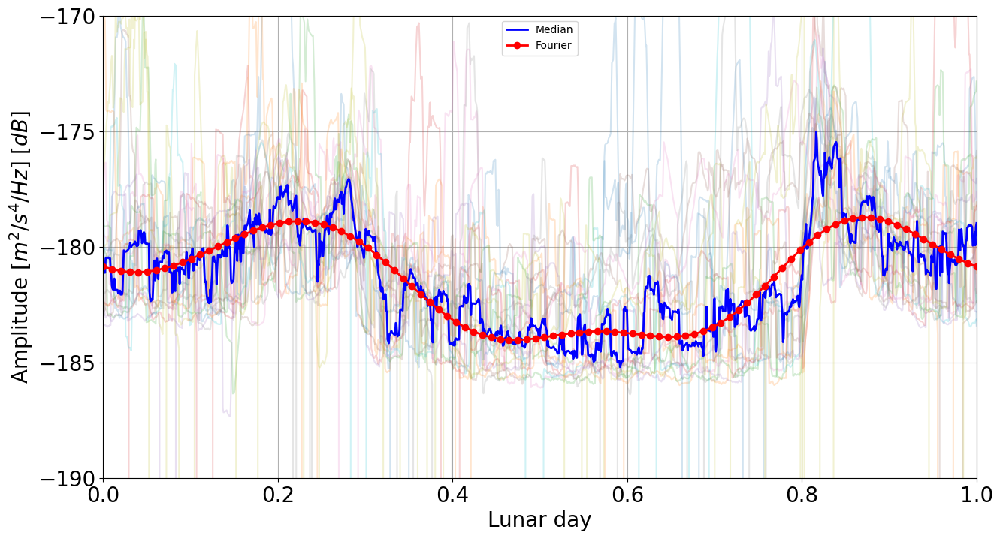

In [168]:
daily_12hour_filter_data = []
for i in range(0, len(daily_data)):
    fil = []
    for j in range(0, len(daily_data[0])):
        fil.append(daily_data[i][j : j+24])
        if j == 1394:
            break
    daily_12hour_filter_data.append(fil)
    
daily_12hour_filter_ma = [] 
for i in range(len(daily_12hour_filter_data)):
    fil = []
    for j in daily_12hour_filter_data[i]:
        fil.append(np.mean(j))

    daily_12hour_filter_ma.append(fil)


plt.figure(figsize=(15,8))
time = np.linspace(0, 1, 1395)


for day in range(len(daily_12hour_filter_ma)):
    plt.plot(time, daily_12hour_filter_ma[day], alpha = 0.2);

percentage_25 = []
median = []
percentage_75 = []
for j in range(len(daily_12hour_filter_ma[0])):
    temp = []
    for i in range(len(daily_12hour_filter_ma)):
        temp.append(daily_12hour_filter_ma[i][j])
    percentage_25.append(np.quantile(temp, 0.25))
    percentage_75.append(np.quantile(temp, 0.75))
    median.append(np.median(temp))
#plt.plot(time, percentage_25, linewidth = 3, color = 'r', label = '25%')
plt.plot(time, median, linewidth = 2, color ='b', label = 'Median')
#plt.plot(time, percentage_75, linewidth = 3, color ='b', label = '75%')
plt.plot(x_vals, y_fourier, linewidth = 2, color ='red',  marker = 'o',label='Fourier')

time = np.array(time)

plt.legend(loc='best')
plt.xlim(0,1)
plt.ylim(-190, -170)
#plt.xticks([48.67, 48.67*2, 48.67*3, 48.67*4, 48.67*5], [1,2,3,4,5], fontsize = 15)
plt.xticks(fontsize = 20)
plt.yticks([-170, -175, -180, -185, -190], fontsize = 20)
plt.grid()
plt.xlabel('Lunar day', fontsize = 20)
plt.ylabel('Amplitude [$m^2/s^4/Hz$] [$dB$]', fontsize = 20)


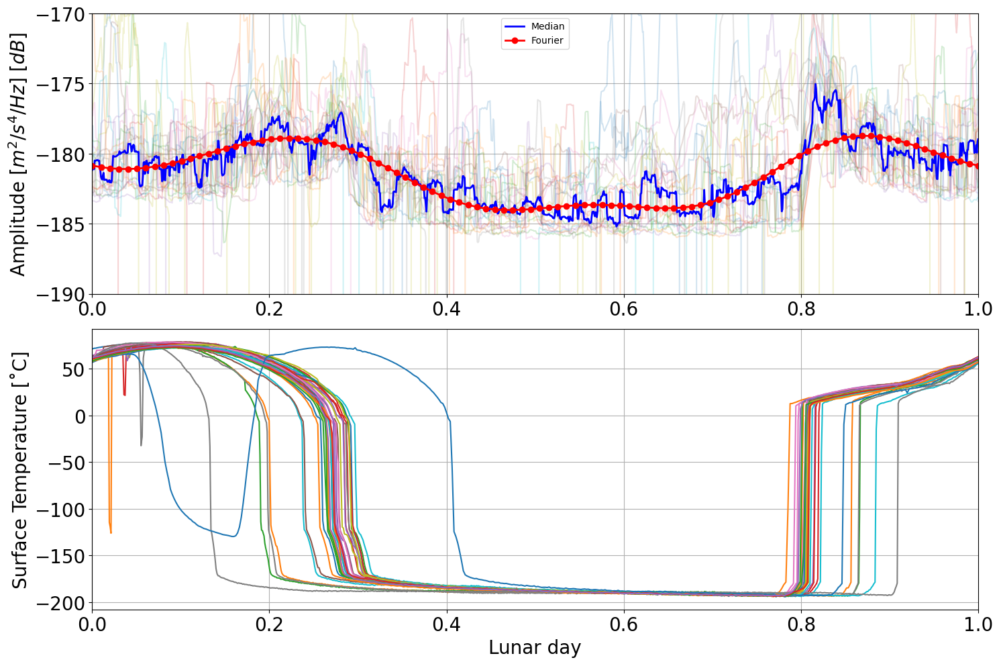

In [175]:
daily_12hour_filter_data = []
for i in range(0, len(daily_data)):
    fil = []
    for j in range(0, len(daily_data[0])):
        fil.append(daily_data[i][j : j+24])
        if j == 1394:
            break
    daily_12hour_filter_data.append(fil)
    
daily_12hour_filter_ma = [] 
for i in range(len(daily_12hour_filter_data)):
    fil = []
    for j in daily_12hour_filter_data[i]:
        fil.append(np.mean(j))
    daily_12hour_filter_ma.append(fil)


fig, axs = plt.subplots(2, 1, figsize=(15, 10))

# 첫 번째 서브플롯: daily_data와 median, Fourier series
time = np.linspace(0, 1, 1395)
for day in range(len(daily_12hour_filter_ma)):
    axs[0].plot(time, daily_12hour_filter_ma[day], alpha=0.2)

percentage_25 = []
median = []
percentage_75 = []
for j in range(len(daily_12hour_filter_ma[0])):
    temp = []
    for i in range(len(daily_12hour_filter_ma)):
        temp.append(daily_12hour_filter_ma[i][j])
    percentage_25.append(np.quantile(temp, 0.25))
    percentage_75.append(np.quantile(temp, 0.75))
    median.append(np.median(temp))

axs[0].plot(time, median, linewidth=2, color='b', label='Median')
axs[0].plot(x_vals, y_fourier, linewidth=2, color='red', marker='o', label='Fourier')

axs[0].legend(loc='best')
axs[0].set_xlim(0, 1)

axs[0].set_ylim(-190, -170)
axs[0].set_ylabel('Amplitude [$m^2/s^4/Hz$] [$dB$]', fontsize=20)
axs[0].tick_params(axis='x', labelsize=20)
axs[0].tick_params(axis='y', labelsize=20)
axs[0].grid()

# 두 번째 서브플롯: lmst_groups의 TC12
lmst_groups = {}

# Iterate over each row in the dataframe
for start_time, end_time in zip(start, end):
    lmst_prefix = start_time.strftime("%Y%m%d")
    if lmst_prefix not in lmst_groups:
        lmst_groups[lmst_prefix] = []

    for index, row in temperature.iterrows():
        if start_time < row['Time'] < end_time:
            lmst_groups[lmst_prefix].append(row)

# Convert lists to DataFrames
for key in lmst_groups:
    lmst_groups[key] = pd.DataFrame(lmst_groups[key])

# Display the grouped data
for key, group in lmst_groups.items():
    time = np.linspace(0, 1, len(group))
    if len(group) != 0:
        axs[1].plot(time, group['TC12'])

axs[1].set_xlim(0, 1)
axs[1].tick_params(axis='x', labelsize=20)
axs[1].tick_params(axis='y', labelsize=20)
axs[1].grid()
axs[1].set_xlabel('Lunar day', fontsize=20)
axs[1].set_ylabel('Surface Temperature [˚C]', fontsize=20)

plt.tight_layout()
plt.show()


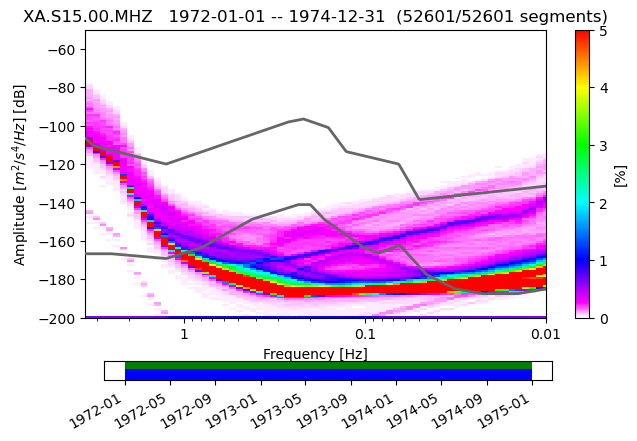

In [172]:
from obspy.imaging.cm import pqlx

ppsd = PPSD.load_npz('./npz_15_MHZ/1972merged.npz')
ppsd.add_npz('./npz_15_MHZ/1973merged.npz')
ppsd.add_npz('./npz_15_MHZ/1974merged.npz')
ppsd.plot(xaxis_frequency=True, period_lim= (3.5, 0.01), max_percentage=5, grid=False, cmap = pqlx);

52242


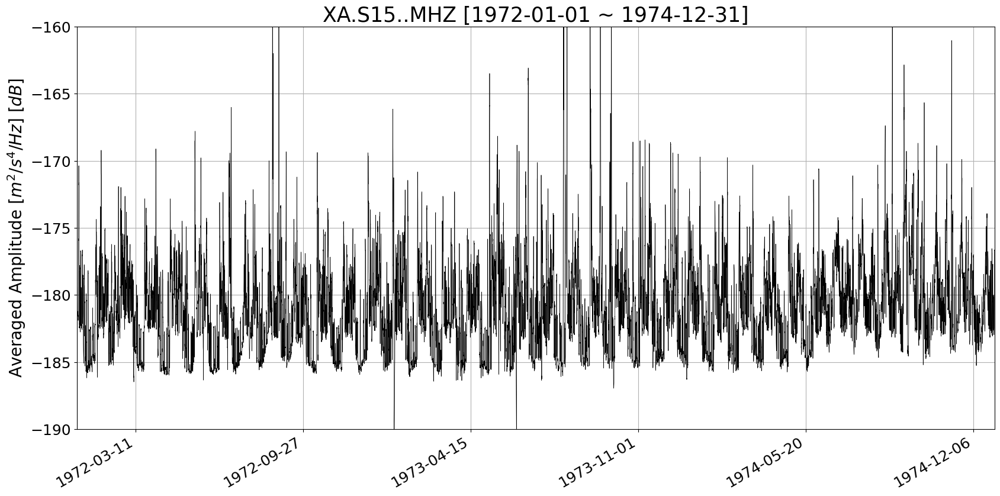

In [173]:
median_amplitude, tt = draw_periodicity4(ppsd, 0.01, 0.1, 50, ylim_min = -190, ylim_max = -160)

52218


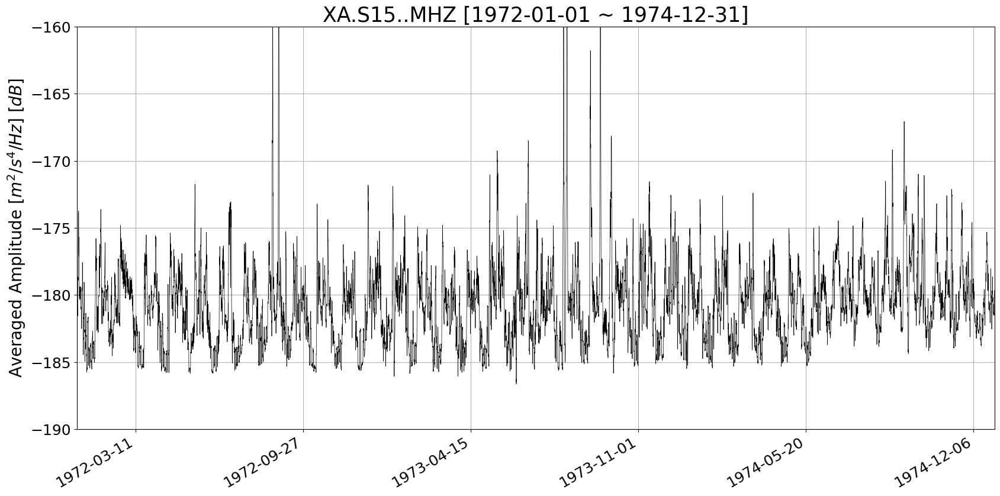

In [147]:
median_amplitude, tt = draw_periodicity5(ppsd, 0.01, 0.1, 50, ylim_min = -190, ylim_max = -160)

In [148]:
1417/len(median_amplitude)

0.027136236546784633

Calculating Fourier Series:   0%|          | 0/1000 [00:00<?, ?it/s]

C:\Users\neimb\AppData\Local\Temp\ipykernel_17548\2348412475.py:18: IntegrationWarning: The maximum number of subdivisions (50) has been achieved.
  If increasing the limit yields no improvement it is advised to analyze 
  the integrand in order to determine the difficulties.  If the position of a 
  local difficulty can be determined (singularity, discontinuity) one will 
  probably gain from splitting up the interval and calling the integrator 
  on the subranges.  Perhaps a special-purpose integrator should be used.
  return (1 / T) * quad(median_func, 0, T)[0]
C:\Users\neimb\AppData\Local\Temp\ipykernel_17548\2348412475.py:22: IntegrationWarning: The maximum number of subdivisions (50) has been achieved.
  If increasing the limit yields no improvement it is advised to analyze 
  the integrand in order to determine the difficulties.  If the position of a 
  local difficulty can be determined (singularity, discontinuity) one will 
  probably gain from splitting up the interval and ca

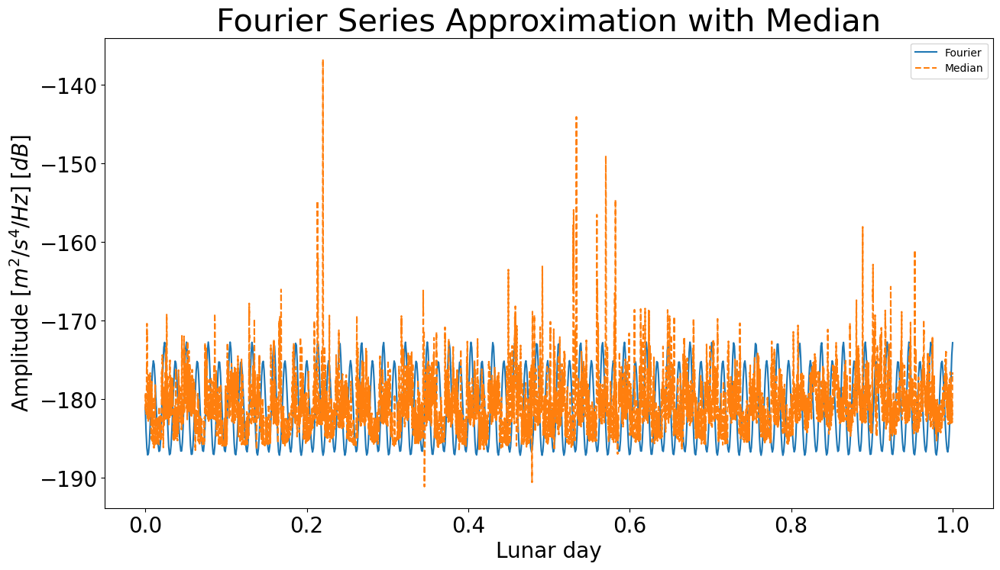

In [174]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import quad
from tqdm import tqdm

median_amplitude = list(median_amplitude)

# 주기
T = 0.02712377014662532 # 주기 T를 설정

# median 값을 함수로 정의
def median_func(x):
    idx = int(x / T * len(median_amplitude)) % len(median_amplitude)
    return median_amplitude[idx]

# a0 계산 
def a0(T, median_func):
    return (1 / T) * quad(median_func, 0, T)[0]

# an 계산 (n차 푸리에 계수, cos 성분)
def an(n, T, median_func):
    return (2 / T) * quad(lambda x: median_func(x) * np.cos(2 * np.pi * n * x / T), 0, T)[0]

# bn 계산 (n차 푸리에 계수, sin 성분)
def bn(n, T, median_func):
    return (2 / T) * quad(lambda x: median_func(x) * np.sin(2 * np.pi * n * x / T), 0, T)[0]

# 푸리에 급수로 근사한 함수
def fourier_series(x, terms, T, median_func):
    result = a0(T, median_func)
    for n in range(1, terms + 1): # terms는 몇 번 더할건지
        result += an(n, T, median_func) * np.cos(2 * np.pi * n * x / T) + bn(n, T, median_func) * np.sin(2 * np.pi * n * x / T)
    return result

# 푸리에 급수 계산
x_vals = np.linspace(0, 1.0, 1000)
y_fourier = [fourier_series(x, 4, T, median_func) for x in tqdm(x_vals, desc="Calculating Fourier Series")]

# tt 0~1사이로 정규화
tt_normalized = (tt - min(tt)) / (max(tt) - min(tt))

# 결과 시각화
plt.figure(figsize=(15,8))
plt.plot(x_vals, y_fourier, label='Fourier')
plt.plot(tt_normalized, median_amplitude, label='Median', linestyle='--')
plt.legend()
plt.xlabel('Lunar day', fontsize = 20)
plt.ylabel('Amplitude [$m^2/s^4/Hz$] [$dB$]', fontsize = 20)
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.title('Fourier Series Approximation with Median', fontsize = 30)
#plt.xlim(time[0], time[-1])
plt.show()


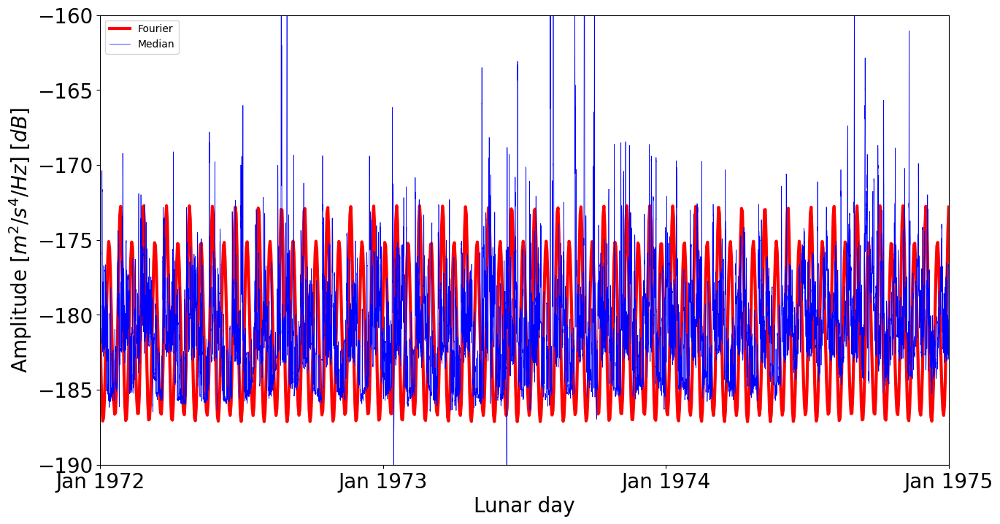

In [175]:
plt.figure(figsize=(15,8))
plt.plot(x_vals, y_fourier, label='Fourier', linewidth = 3, color = 'r')
plt.plot(tt_normalized, median_amplitude, label='Median', linestyle='-', linewidth = 0.5, color = 'b')
plt.legend()
plt.xlabel('Lunar day', fontsize = 20)
plt.ylabel('Amplitude [$m^2/s^4/Hz$] [$dB$]', fontsize = 20)
plt.xticks([0.0, 1/3, 2/3, 1.0], labels = ['Jan 1972', 'Jan 1973', 'Jan 1974', 'Jan 1975'], fontsize = 20)
plt.yticks(fontsize = 20)
#plt.title('Fourier Series Approximation with Median', fontsize = 30)
plt.xlim(tt_normalized[0], tt_normalized[-1])
plt.ylim(-190,-160)
plt.show()

---
## 달 일일(계절) 데이터 (0.1 ~ 1.0 Hz)

In [303]:
# PSD 일일 단위로 뽑아서 중첩 후 median 도출, 푸리에 급수 피팅을 통해 median 그래프와 비교 (0.1 ~ 1.0Hz)

start= []
end= []

starttime = UTCDateTime("1972-01-01T00:00:00")
endtime = UTCDateTime("1972-01-29T12:44:30")

daily_time = []
daily_data = []

for i in range(35):
    
    ppsd = PPSD.load_npz('./npz_15_MHZ/1972merged.npz')
    ppsd.add_npz('./npz_15_MHZ/1973merged.npz')
    ppsd.add_npz('./npz_15_MHZ/1974merged.npz')
    
    mask = ppsd._stack_selection(starttime=starttime, endtime=endtime)
    ppsd._times_processed = [t for i, t in enumerate(ppsd._times_processed) if mask[i]]
    ppsd._binned_psds = [t for i, t in enumerate(ppsd._binned_psds) if mask[i]]
    #U_component.plot(xaxis_frequency=True, period_lim= (10, 0.001), max_percentage=5, grid=False)
    
    
    try:
        fre = ppsd.get_percentile()[0]
    except :
        pass

    # 주파수 선택
    freq = np.where((fre < 1 / 0.3) & (fre > 1 / 0.8))
    avg_amplitude = []
    time = []

    for i in range(len(ppsd.psd_values)):
        time.append(UTCDateTime(int(str(ppsd._times_processed[i])[:10]) + 60*30 ).matplotlib_date)
        avg_amplitude.append(np.median(ppsd.psd_values[i][freq[0][0]:freq[0][-1]]))

    if len(ppsd._binned_psds) == 1417:
        daily_time.append(time)
        daily_data.append(avg_amplitude)
    
    print(f'{starttime, endtime, len(ppsd._binned_psds)}')
    start.append(starttime)
    end.append(endtime)

    
    starttime = endtime
    endtime += ((60 * 60 * 24 * 29) + (60 * 60 * 12) + (60 * 44) + 30)



(UTCDateTime(1972, 1, 1, 0, 0), UTCDateTime(1972, 1, 29, 12, 44, 30), 1370)
(UTCDateTime(1972, 1, 29, 12, 44, 30), UTCDateTime(1972, 2, 28, 1, 29), 1417)
(UTCDateTime(1972, 2, 28, 1, 29), UTCDateTime(1972, 3, 28, 14, 13, 30), 1418)
(UTCDateTime(1972, 3, 28, 14, 13, 30), UTCDateTime(1972, 4, 27, 2, 58), 1417)
(UTCDateTime(1972, 4, 27, 2, 58), UTCDateTime(1972, 5, 26, 15, 42, 30), 1418)
(UTCDateTime(1972, 5, 26, 15, 42, 30), UTCDateTime(1972, 6, 25, 4, 27), 1417)
(UTCDateTime(1972, 6, 25, 4, 27), UTCDateTime(1972, 7, 24, 17, 11, 30), 1418)
(UTCDateTime(1972, 7, 24, 17, 11, 30), UTCDateTime(1972, 8, 23, 5, 56), 1417)
(UTCDateTime(1972, 8, 23, 5, 56), UTCDateTime(1972, 9, 21, 18, 40, 30), 1418)
(UTCDateTime(1972, 9, 21, 18, 40, 30), UTCDateTime(1972, 10, 21, 7, 25), 1417)
(UTCDateTime(1972, 10, 21, 7, 25), UTCDateTime(1972, 11, 19, 20, 9, 30), 1418)
(UTCDateTime(1972, 11, 19, 20, 9, 30), UTCDateTime(1972, 12, 19, 8, 54), 1417)
(UTCDateTime(1972, 12, 19, 8, 54), UTCDateTime(1973, 1, 17, 21,

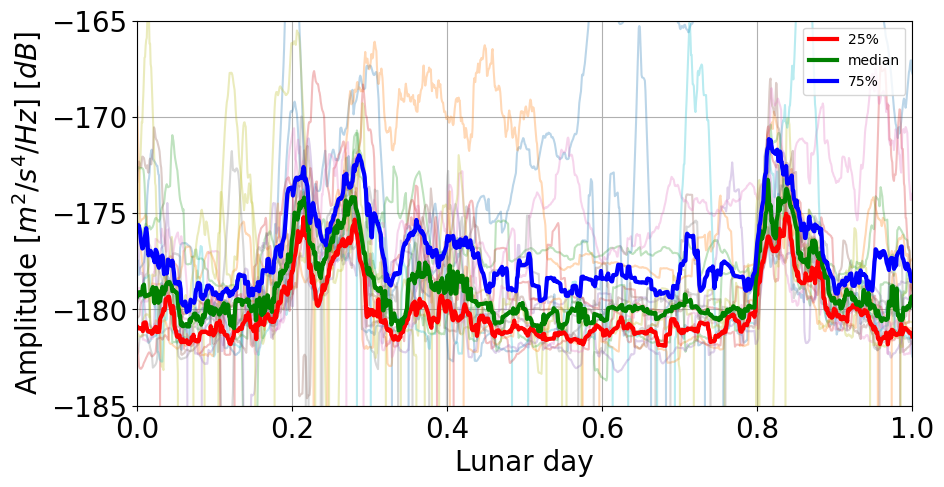

In [304]:
daily_12hour_filter_data = []
for i in range(0, len(daily_data)):
    fil = []
    for j in range(0, len(daily_data[0])):
        fil.append(daily_data[i][j : j+24])
        if j == 1394:
            break
    daily_12hour_filter_data.append(fil)
    
daily_12hour_filter_ma = [] 
for i in range(len(daily_12hour_filter_data)):
    fil = []
    for j in daily_12hour_filter_data[i]:
        fil.append(np.mean(j))

    daily_12hour_filter_ma.append(fil)


plt.figure(figsize=(10,5))
time = np.linspace(0, 1, 1395)

for day in range(len(daily_12hour_filter_ma)):
    plt.plot(time, daily_12hour_filter_ma[day], alpha = 0.3);

percentage_25 = []
median = []
percentage_75 = []
for j in range(len(daily_12hour_filter_ma[0])):
    temp = []
    for i in range(len(daily_12hour_filter_ma)):
        temp.append(daily_12hour_filter_ma[i][j])
    percentage_25.append(np.quantile(temp, 0.25))
    percentage_75.append(np.quantile(temp, 0.75))
    median.append(np.median(temp))
plt.plot(time, percentage_25, linewidth = 3, color = 'r', label = '25%')
plt.plot(time, median, linewidth = 3, color ='g', label = 'median')
plt.plot(time, percentage_75, linewidth = 3, color ='b', label = '75%')

time = np.array(time)

plt.legend(loc='upper right')
plt.xlim(0,1)
plt.ylim(-185, -165)
#plt.xticks([48.67, 48.67*2, 48.67*3, 48.67*4, 48.67*5], [1,2,3,4,5], fontsize = 15)
plt.xticks(fontsize = 20)
plt.yticks([-165, -170, -175, -180, -185], fontsize = 20)
plt.grid()
plt.xlabel('Lunar day', fontsize = 20)
plt.ylabel('Amplitude [$m^2/s^4/Hz$] [$dB$]', fontsize = 20)
plt.show()


C:\Users\neimb\AppData\Local\Temp\ipykernel_17548\636128992.py:15: IntegrationWarning: The maximum number of subdivisions (50) has been achieved.
  If increasing the limit yields no improvement it is advised to analyze 
  the integrand in order to determine the difficulties.  If the position of a 
  local difficulty can be determined (singularity, discontinuity) one will 
  probably gain from splitting up the interval and calling the integrator 
  on the subranges.  Perhaps a special-purpose integrator should be used.
  return (1 / T) * quad(median_func, 0, T)[0]
C:\Users\neimb\AppData\Local\Temp\ipykernel_17548\636128992.py:19: IntegrationWarning: The maximum number of subdivisions (50) has been achieved.
  If increasing the limit yields no improvement it is advised to analyze 
  the integrand in order to determine the difficulties.  If the position of a 
  local difficulty can be determined (singularity, discontinuity) one will 
  probably gain from splitting up the interval and call

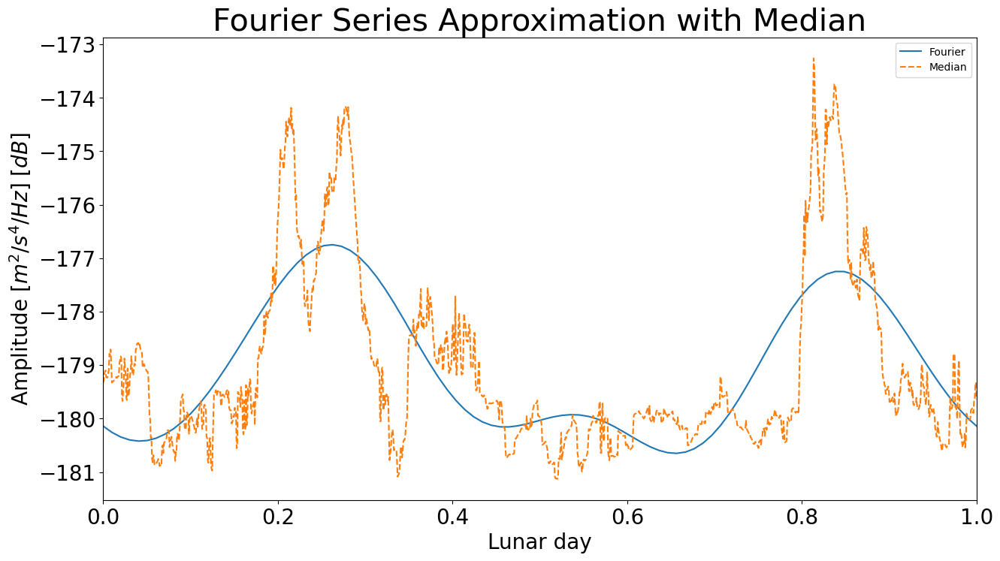

In [305]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import quad

# 주기
T = 1 # 주기 T를 설정

# median 값을 함수로 정의
def median_func(x):
    idx = int(x / T * len(median)) % len(median)
    return median[idx]

# a0 계산 
def a0(T, median_func):
    return (1 / T) * quad(median_func, 0, T)[0]

# an 계산 (n차 푸리에 계수, cos 성분)
def an(n, T, median_func):
    return (2 / T) * quad(lambda x: median_func(x) * np.cos(2 * np.pi * n * x / T), 0, T)[0]

# bn 계산 (n차 푸리에 계수, sin 성분)
def bn(n, T, median_func):
    return (2 / T) * quad(lambda x: median_func(x) * np.sin(2 * np.pi * n * x / T), 0, T)[0]

# 푸리에 급수로 근사한 함수
def fourier_series(x, terms, T, median_func):
    result = a0(T, median_func)
    for n in range(1, terms + 1): # terms는 몇 번 더할건지
        result += an(n, T, median_func) * np.cos(2 * np.pi * n * x / T) + bn(n, T, median_func) * np.sin(2 * np.pi * n * x / T)
    return result


# 푸리에 급수 계산
x_vals = np.linspace(0, T, 100)
y_fourier = [fourier_series(x, 4, T, median_func) for x in x_vals]  # 각 x 값에 대해 푸리에 급수 계산


# 결과 시각화
plt.figure(figsize=(15,8))
plt.plot(x_vals, y_fourier, label='Fourier')
plt.plot(time, median, label='Median', linestyle='--')
plt.legend()
plt.xlabel('Lunar day', fontsize = 20)
plt.ylabel('Amplitude [$m^2/s^4/Hz$] [$dB$]', fontsize = 20)
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.title('Fourier Series Approximation with Median', fontsize = 30)
plt.xlim(time[0], time[-1])
plt.show()

Text(0, 0.5, 'Amplitude [$m^2/s^4/Hz$] [$dB$]')

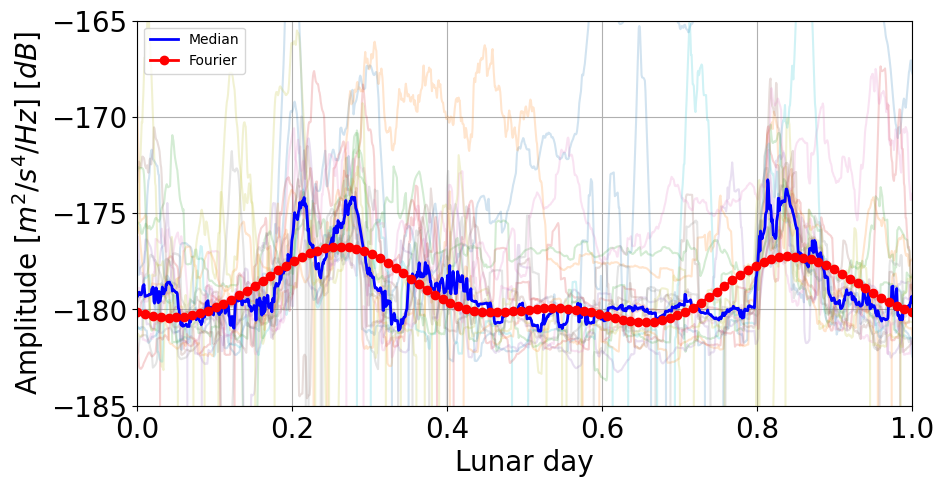

In [306]:
daily_12hour_filter_data = []
for i in range(0, len(daily_data)):
    fil = []
    for j in range(0, len(daily_data[0])):
        fil.append(daily_data[i][j : j+24])
        if j == 1394:
            break
    daily_12hour_filter_data.append(fil)
    
daily_12hour_filter_ma = [] 
for i in range(len(daily_12hour_filter_data)):
    fil = []
    for j in daily_12hour_filter_data[i]:
        fil.append(np.mean(j))

    daily_12hour_filter_ma.append(fil)


plt.figure(figsize=(10,5))
time = np.linspace(0, 1, 1395)


for day in range(len(daily_12hour_filter_ma)):
    plt.plot(time, daily_12hour_filter_ma[day], alpha = 0.2);

percentage_25 = []
median = []
percentage_75 = []
for j in range(len(daily_12hour_filter_ma[0])):
    temp = []
    for i in range(len(daily_12hour_filter_ma)):
        temp.append(daily_12hour_filter_ma[i][j])
    percentage_25.append(np.quantile(temp, 0.25))
    percentage_75.append(np.quantile(temp, 0.75))
    median.append(np.median(temp))
#plt.plot(time, percentage_25, linewidth = 3, color = 'r', label = '25%')
plt.plot(time, median, linewidth = 2, color ='b', label = 'Median')
#plt.plot(time, percentage_75, linewidth = 3, color ='b', label = '75%')
plt.plot(x_vals, y_fourier, linewidth = 2, color ='red',  marker = 'o',label='Fourier')

time = np.array(time)

plt.legend(loc='best')
plt.xlim(0,1)
plt.ylim(-185, -165)
#plt.xticks([48.67, 48.67*2, 48.67*3, 48.67*4, 48.67*5], [1,2,3,4,5], fontsize = 15)
plt.xticks(fontsize = 20)
plt.yticks([-165, -170, -175, -180, -185], fontsize = 20)
plt.grid()
plt.xlabel('Lunar day', fontsize = 20)
plt.ylabel('Amplitude [$m^2/s^4/Hz$] [$dB$]', fontsize = 20)


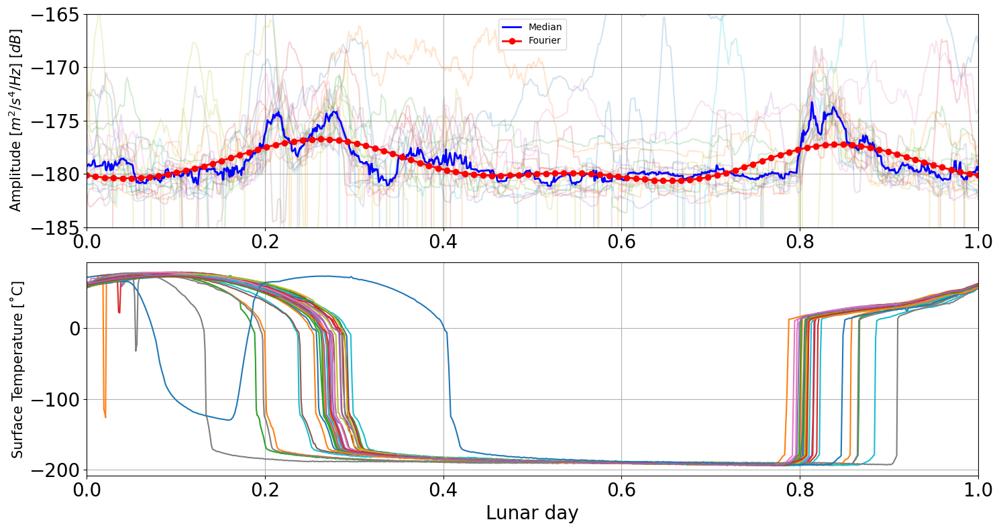

In [277]:
daily_12hour_filter_data = []
for i in range(0, len(daily_data)):
    fil = []
    for j in range(0, len(daily_data[0])):
        fil.append(daily_data[i][j : j+24])
        if j == 1394:
            break
    daily_12hour_filter_data.append(fil)
    
daily_12hour_filter_ma = [] 
for i in range(len(daily_12hour_filter_data)):
    fil = []
    for j in daily_12hour_filter_data[i]:
        fil.append(np.mean(j))
    daily_12hour_filter_ma.append(fil)


fig, axs = plt.subplots(2, 1, figsize=(15, 8))

# 첫 번째 서브플롯: daily_data와 median, Fourier series
time = np.linspace(0, 1, 1395)
for day in range(len(daily_12hour_filter_ma)):
    axs[0].plot(time, daily_12hour_filter_ma[day], alpha=0.2)

percentage_25 = []
median = []
percentage_75 = []
for j in range(len(daily_12hour_filter_ma[0])):
    temp = []
    for i in range(len(daily_12hour_filter_ma)):
        temp.append(daily_12hour_filter_ma[i][j])
    percentage_25.append(np.quantile(temp, 0.25))
    percentage_75.append(np.quantile(temp, 0.75))
    median.append(np.median(temp))

axs[0].plot(time, median, linewidth=2, color='b', label='Median')
axs[0].plot(x_vals, y_fourier, linewidth=2, color='red', marker='o', label='Fourier')

axs[0].legend(loc='best')
axs[0].set_xlim(0, 1)

axs[0].set_ylim(-185, -165)
axs[0].set_ylabel('Amplitude [$m^2/s^4/Hz$] [$dB$]', fontsize=15)
axs[0].tick_params(axis='x', labelsize=20)
axs[0].tick_params(axis='y', labelsize=20)
axs[0].grid()

# 두 번째 서브플롯: lmst_groups의 TC12
lmst_groups = {}

# Iterate over each row in the dataframe
for start_time, end_time in zip(start, end):
    lmst_prefix = start_time.strftime("%Y%m%d")
    if lmst_prefix not in lmst_groups:
        lmst_groups[lmst_prefix] = []

    for index, row in temperature.iterrows():
        if start_time < row['Time'] < end_time:
            lmst_groups[lmst_prefix].append(row)

# Convert lists to DataFrames
for key in lmst_groups:
    lmst_groups[key] = pd.DataFrame(lmst_groups[key])

# Display the grouped data
for key, group in lmst_groups.items():
    time = np.linspace(0, 1, len(group))
    if len(group) != 0:
        axs[1].plot(time, group['TC12'])

axs[1].set_xlim(0, 1)
axs[1].tick_params(axis='x', labelsize=20)
axs[1].tick_params(axis='y', labelsize=20)
axs[1].grid()
axs[1].set_xlabel('Lunar day', fontsize=20)
axs[1].set_ylabel('Surface Temperature [˚C]', fontsize=15)

plt.tight_layout()
plt.show()


52241


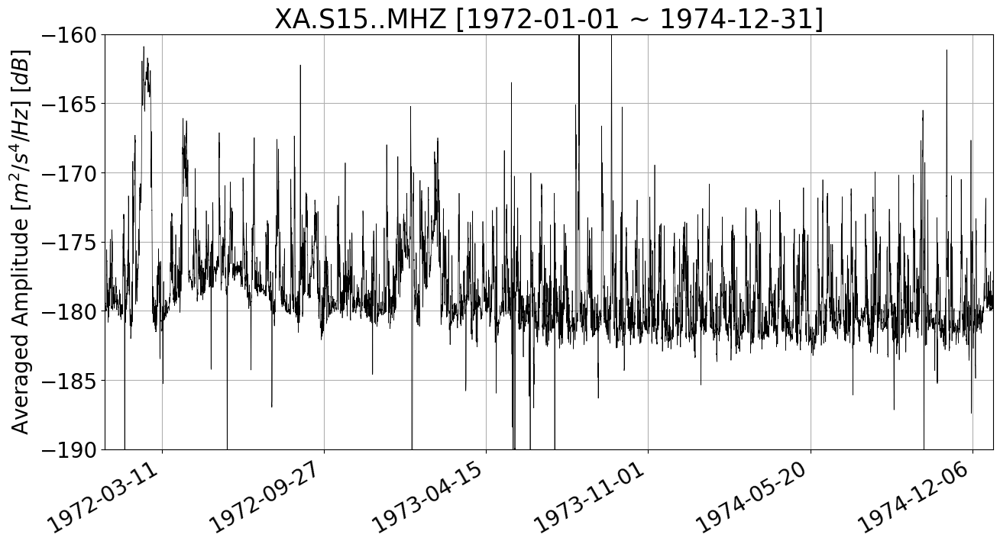

In [229]:
median_amplitude, tt = draw_periodicity4(ppsd, 0.3, 0.8, 50, ylim_min = -190, ylim_max = -160)

52217


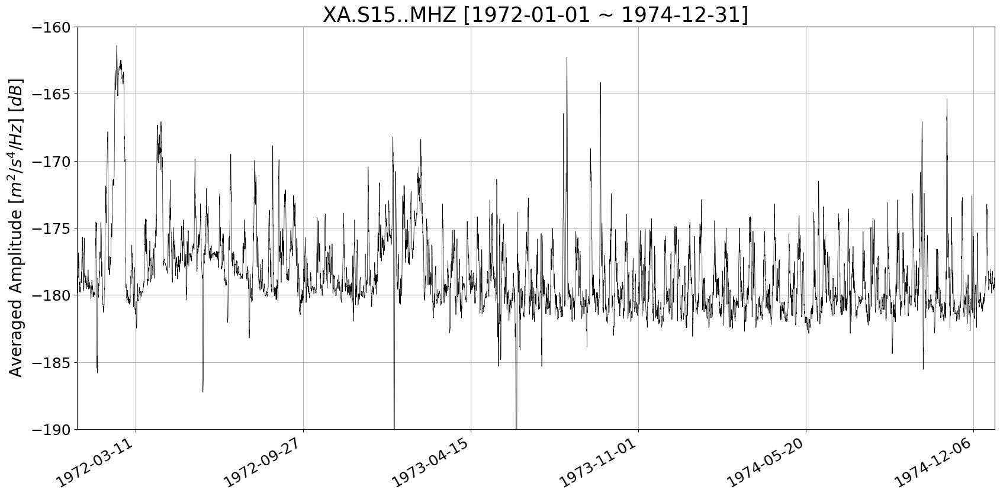

In [309]:
median_amplitude, tt = draw_periodicity5(ppsd, 0.3, 0.8, 50, ylim_min = -190, ylim_max = -160)

Calculating Fourier Series:   0%|          | 0/1000 [00:00<?, ?it/s]

C:\Users\neimb\AppData\Local\Temp\ipykernel_17548\1550714797.py:19: IntegrationWarning: The maximum number of subdivisions (50) has been achieved.
  If increasing the limit yields no improvement it is advised to analyze 
  the integrand in order to determine the difficulties.  If the position of a 
  local difficulty can be determined (singularity, discontinuity) one will 
  probably gain from splitting up the interval and calling the integrator 
  on the subranges.  Perhaps a special-purpose integrator should be used.
  return (1 / T) * quad(median_func, 0, T)[0]
C:\Users\neimb\AppData\Local\Temp\ipykernel_17548\1550714797.py:23: IntegrationWarning: The maximum number of subdivisions (50) has been achieved.
  If increasing the limit yields no improvement it is advised to analyze 
  the integrand in order to determine the difficulties.  If the position of a 
  local difficulty can be determined (singularity, discontinuity) one will 
  probably gain from splitting up the interval and ca

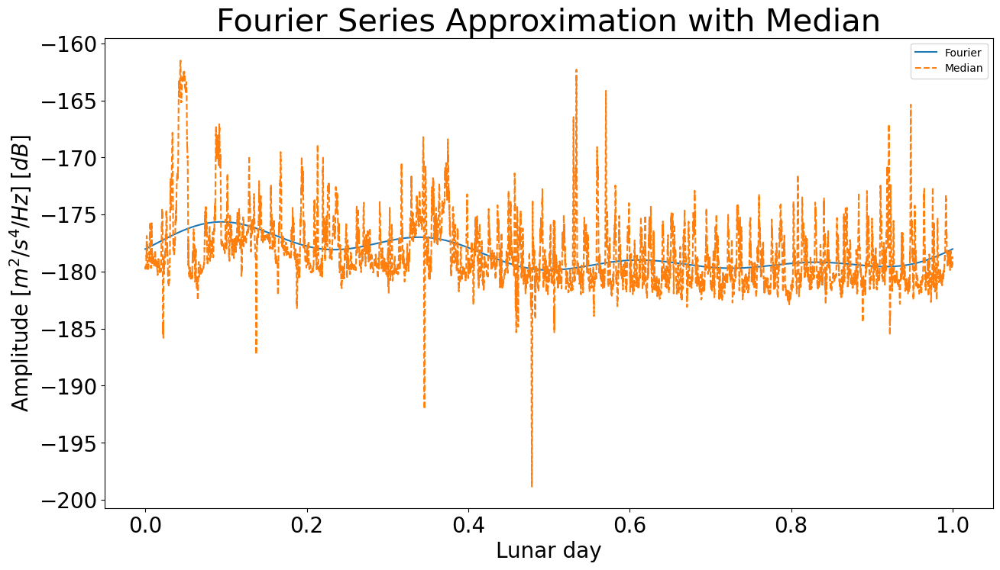

In [310]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import quad
from tqdm import tqdm

#median_amplitude = list(median_amplitude)

# 주기
#T = 0.02712377014662532 # 주기 T를 설정
T = 1

# median 값을 함수로 정의
def median_func(x):
    idx = int(x / T * len(median_amplitude)) % len(median_amplitude)
    return median_amplitude[idx]

# a0 계산 
def a0(T, median_func):
    return (1 / T) * quad(median_func, 0, T)[0]

# an 계산 (n차 푸리에 계수, cos 성분)
def an(n, T, median_func):
    return (2 / T) * quad(lambda x: median_func(x) * np.cos(2 * np.pi * n * x / T), 0, T)[0]

# bn 계산 (n차 푸리에 계수, sin 성분)
def bn(n, T, median_func):
    return (2 / T) * quad(lambda x: median_func(x) * np.sin(2 * np.pi * n * x / T), 0, T)[0]

# 푸리에 급수로 근사한 함수
def fourier_series(x, terms, T, median_func):
    result = a0(T, median_func)
    for n in range(1, terms + 1): # terms는 몇 번 더할건지
        result += an(n, T, median_func) * np.cos(2 * np.pi * n * x / T) + bn(n, T, median_func) * np.sin(2 * np.pi * n * x / T)
    return result

# 푸리에 급수 계산
x_vals = np.linspace(0, 1.0, 1000)
y_fourier = [fourier_series(x, 4, T, median_func) for x in tqdm(x_vals, desc="Calculating Fourier Series")]

# tt 0~1사이로 정규화
tt_normalized = (tt - min(tt)) / (max(tt) - min(tt))

# 결과 시각화
plt.figure(figsize=(15,8))
plt.plot(x_vals, y_fourier, label='Fourier')
plt.plot(tt_normalized, median_amplitude, label='Median', linestyle='--')
plt.legend()
plt.xlabel('Lunar day', fontsize = 20)
plt.ylabel('Amplitude [$m^2/s^4/Hz$] [$dB$]', fontsize = 20)
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.title('Fourier Series Approximation with Median', fontsize = 30)
#plt.xlim(time[0], time[-1])
plt.show()


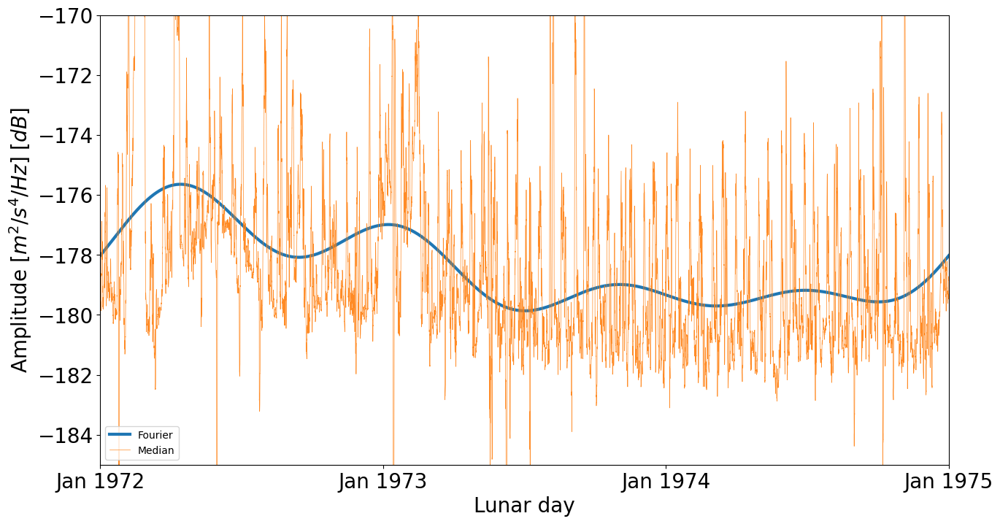

In [311]:
plt.figure(figsize=(15,8))
plt.plot(x_vals, y_fourier, label='Fourier', linewidth = 3)
plt.plot(tt_normalized, median_amplitude, label='Median', linestyle='-', linewidth = 0.5, alpha = 0.9)
plt.legend()
plt.xlabel('Lunar day', fontsize = 20)
plt.ylabel('Amplitude [$m^2/s^4/Hz$] [$dB$]', fontsize = 20)
plt.xticks([0.0, 1/3, 2/3, 1.0], labels = ['Jan 1972', 'Jan 1973', 'Jan 1974', 'Jan 1975'], fontsize = 20)
plt.yticks(fontsize = 20)
#plt.title('Fourier Series Approximation with Median', fontsize = 30)
plt.xlim(tt_normalized[0], tt_normalized[-1])
plt.ylim(-185,-170)
plt.show()

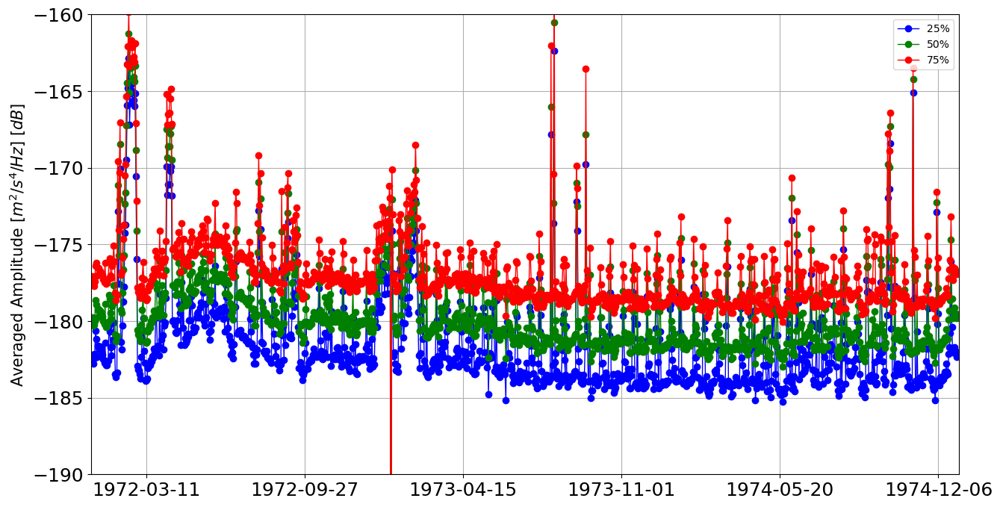

In [297]:
daily_time, daily_avg_amplitude = noise_sequence_daily(ppsd, freqmin = 0.3, freqmax = 0.8, ylim = (-190,-160))


Calculating Fourier Series:   0%|          | 0/500 [00:00<?, ?it/s]

C:\Users\neimb\AppData\Local\Temp\ipykernel_17548\1111575436.py:18: IntegrationWarning: The maximum number of subdivisions (50) has been achieved.
  If increasing the limit yields no improvement it is advised to analyze 
  the integrand in order to determine the difficulties.  If the position of a 
  local difficulty can be determined (singularity, discontinuity) one will 
  probably gain from splitting up the interval and calling the integrator 
  on the subranges.  Perhaps a special-purpose integrator should be used.
  return (1 / T) * quad(median_func, 0, T)[0]
C:\Users\neimb\AppData\Local\Temp\ipykernel_17548\1111575436.py:22: IntegrationWarning: The maximum number of subdivisions (50) has been achieved.
  If increasing the limit yields no improvement it is advised to analyze 
  the integrand in order to determine the difficulties.  If the position of a 
  local difficulty can be determined (singularity, discontinuity) one will 
  probably gain from splitting up the interval and ca

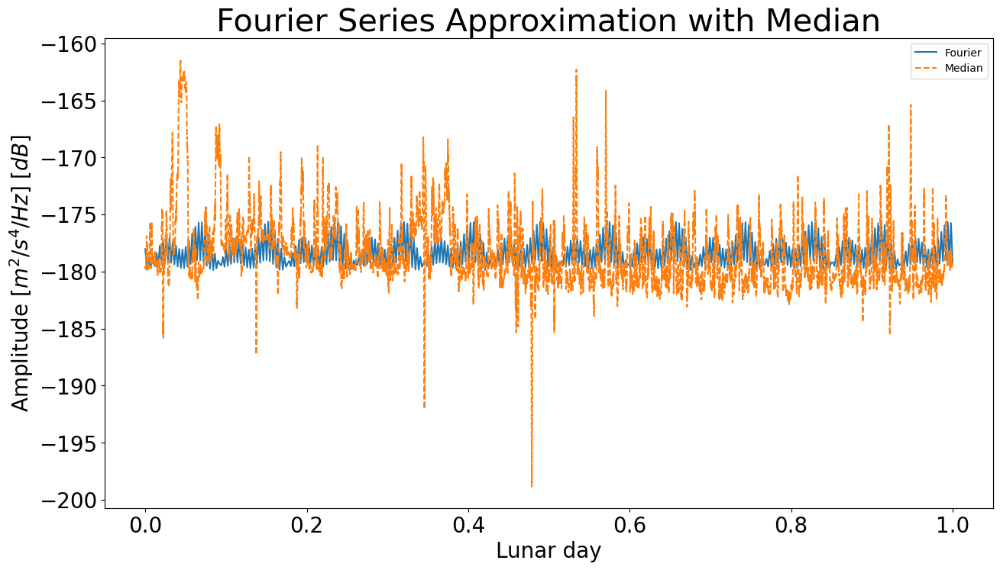

In [255]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import quad
from tqdm import tqdm

#median_amplitude = list(daily_avg_amplitude)

# 주기
T = 30/len(median_amplitude) # 주기 T를 설정

# median 값을 함수로 정의
def median_func(x):
    idx = int(x / T * len(median_amplitude)) % len(median_amplitude)
    return median_amplitude[idx]

# a0 계산 
def a0(T, median_func):
    return (1 / T) * quad(median_func, 0, T)[0]

# an 계산 (n차 푸리에 계수, cos 성분)
def an(n, T, median_func):
    return (2 / T) * quad(lambda x: median_func(x) * np.cos(2 * np.pi * n * x / T), 0, T)[0]

# bn 계산 (n차 푸리에 계수, sin 성분)
def bn(n, T, median_func):
    return (2 / T) * quad(lambda x: median_func(x) * np.sin(2 * np.pi * n * x / T), 0, T)[0]

# 푸리에 급수로 근사한 함수
def fourier_series(x, terms, T, median_func):
    result = a0(T, median_func)
    for n in range(1, terms + 1): # terms는 몇 번 더할건지
        result += an(n, T, median_func) * np.cos(2 * np.pi * n * x / T) + bn(n, T, median_func) * np.sin(2 * np.pi * n * x / T)
    return result

# 푸리에 급수 계산
x_vals = np.linspace(0, 1.0, 500)
y_fourier = [fourier_series(x, 4, T, median_func) for x in tqdm(x_vals, desc="Calculating Fourier Series")]

# tt 0~1사이로 정규화
tt_normalized = (tt - min(tt)) / (max(tt) - min(tt))

# 결과 시각화
plt.figure(figsize=(15,8))
plt.plot(x_vals, y_fourier, label='Fourier')
plt.plot(tt_normalized, median_amplitude, label='Median', linestyle='--')
plt.legend()
plt.xlabel('Lunar day', fontsize = 20)
plt.ylabel('Amplitude [$m^2/s^4/Hz$] [$dB$]', fontsize = 20)
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.title('Fourier Series Approximation with Median', fontsize = 30)
#plt.xlim(time[0], time[-1])
plt.show()


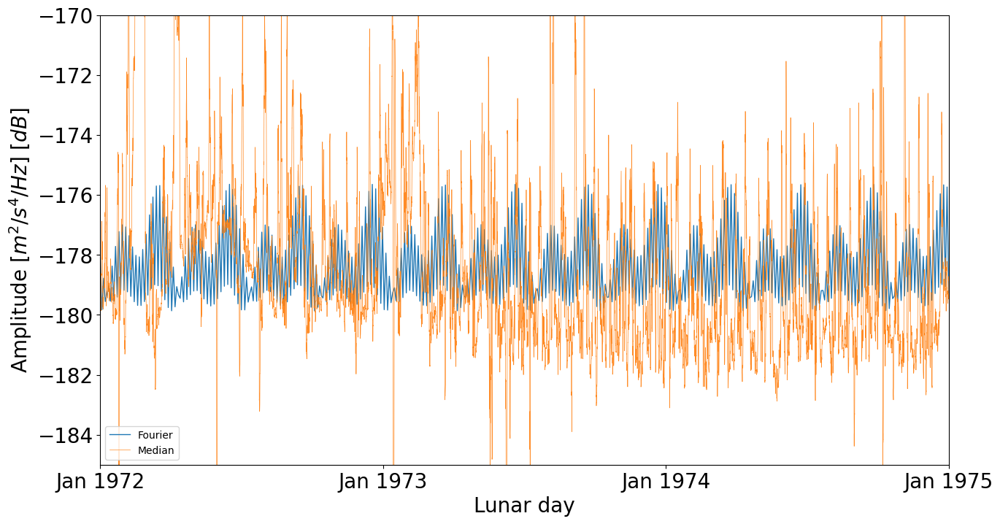

In [256]:
plt.figure(figsize=(15,8))
plt.plot(x_vals, y_fourier, label='Fourier', linewidth = 1)
plt.plot(tt_normalized, median_amplitude, label='Median', linestyle='-', linewidth = 0.5, alpha = 0.9)
plt.legend()
plt.xlabel('Lunar day', fontsize = 20)
plt.ylabel('Amplitude [$m^2/s^4/Hz$] [$dB$]', fontsize = 20)
plt.xticks([0.0, 1/3, 2/3, 1.0], labels = ['Jan 1972', 'Jan 1973', 'Jan 1974', 'Jan 1975'], fontsize = 20)
plt.yticks(fontsize = 20)
#plt.title('Fourier Series Approximation with Median', fontsize = 30)
plt.xlim(tt_normalized[0], tt_normalized[-1])
plt.ylim(-185,-170)
plt.show()

---
## 달 일일(계절) 데이터 (1.0 ~ 3.5 Hz)

In [ ]:
# PSD 일일 단위로 뽑아서 중첩 후 median 도출, 푸리에 급수 피팅을 통해 median 그래프와 비교 (0.1 ~ 1.0Hz)

start= []
end= []

starttime = UTCDateTime("1972-01-01T00:00:00")
endtime = UTCDateTime("1972-01-29T12:44:30")

daily_time = []
daily_data = []

for i in range(35):
    
    ppsd = PPSD.load_npz('./npz_15_MHZ/1972merged.npz')
    ppsd.add_npz('./npz_15_MHZ/1973merged.npz')
    ppsd.add_npz('./npz_15_MHZ/1974merged.npz')
    
    mask = ppsd._stack_selection(starttime=starttime, endtime=endtime)
    ppsd._times_processed = [t for i, t in enumerate(ppsd._times_processed) if mask[i]]
    ppsd._binned_psds = [t for i, t in enumerate(ppsd._binned_psds) if mask[i]]
    #U_component.plot(xaxis_frequency=True, period_lim= (10, 0.001), max_percentage=5, grid=False)
    
    
    try:
        fre = ppsd.get_percentile()[0]
    except :
        pass

    # 주파수 선택
    freq = np.where((fre < 1 / 1.0) & (fre > 1 / 3.5))
    avg_amplitude = []
    time = []

    for i in range(len(ppsd.psd_values)):
        time.append(UTCDateTime(int(str(ppsd._times_processed[i])[:10]) + 60*30 ).matplotlib_date)
        avg_amplitude.append(np.median(ppsd.psd_values[i][freq[0][0]:freq[0][-1]]))

    if len(ppsd._binned_psds) == 1417:
        daily_time.append(time)
        daily_data.append(avg_amplitude)
    
    print(f'{starttime, endtime, len(ppsd._binned_psds)}')
    start.append(starttime)
    end.append(endtime)

    
    starttime = endtime
    endtime += ((60 * 60 * 24 * 29) + (60 * 60 * 12) + (60 * 44) + 30)



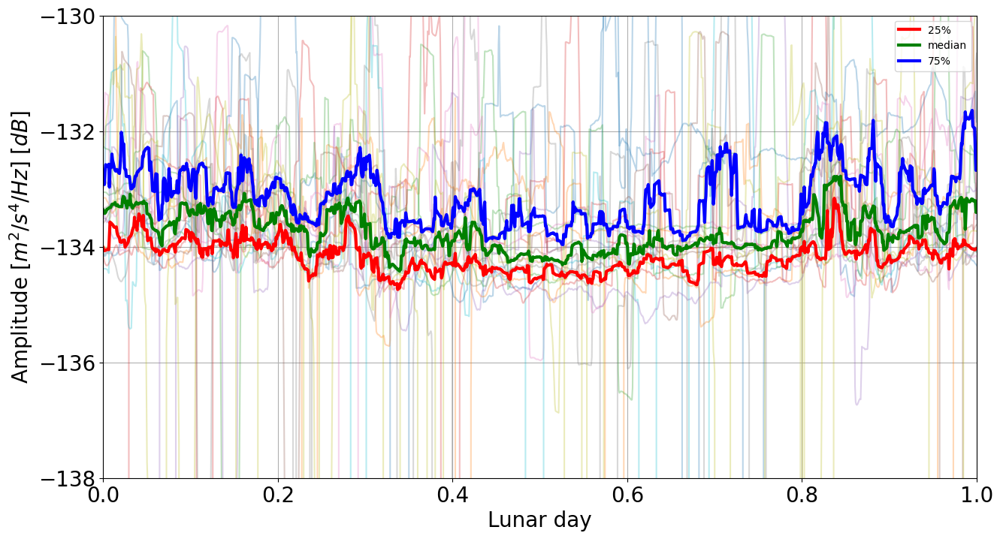

In [189]:
daily_12hour_filter_data = []
for i in range(0, len(daily_data)):
    fil = []
    for j in range(0, len(daily_data[0])):
        fil.append(daily_data[i][j : j+24])
        if j == 1394:
            break
    daily_12hour_filter_data.append(fil)
    
daily_12hour_filter_ma = [] 
for i in range(len(daily_12hour_filter_data)):
    fil = []
    for j in daily_12hour_filter_data[i]:
        fil.append(np.mean(j))

    daily_12hour_filter_ma.append(fil)


plt.figure(figsize=(15,8))
time = np.linspace(0, 1, 1395)

for day in range(len(daily_12hour_filter_ma)):
    plt.plot(time, daily_12hour_filter_ma[day], alpha = 0.3);

percentage_25 = []
median = []
percentage_75 = []
for j in range(len(daily_12hour_filter_ma[0])):
    temp = []
    for i in range(len(daily_12hour_filter_ma)):
        temp.append(daily_12hour_filter_ma[i][j])
    percentage_25.append(np.quantile(temp, 0.25))
    percentage_75.append(np.quantile(temp, 0.75))
    median.append(np.median(temp))
plt.plot(time, percentage_25, linewidth = 3, color = 'r', label = '25%')
plt.plot(time, median, linewidth = 3, color ='g', label = 'median')
plt.plot(time, percentage_75, linewidth = 3, color ='b', label = '75%')

time = np.array(time)

plt.legend(loc='upper right')
plt.xlim(0,1)
plt.ylim(-138, -130)
#plt.xticks([48.67, 48.67*2, 48.67*3, 48.67*4, 48.67*5], [1,2,3,4,5], fontsize = 15)
plt.xticks(fontsize = 20)
plt.yticks([-138, -136, -134, -132, -130], fontsize = 20)
plt.grid()
plt.xlabel('Lunar day', fontsize = 20)
plt.ylabel('Amplitude [$m^2/s^4/Hz$] [$dB$]', fontsize = 20)
plt.show()


C:\Users\neimb\AppData\Local\Temp\ipykernel_22588\636128992.py:15: IntegrationWarning: The maximum number of subdivisions (50) has been achieved.
  If increasing the limit yields no improvement it is advised to analyze 
  the integrand in order to determine the difficulties.  If the position of a 
  local difficulty can be determined (singularity, discontinuity) one will 
  probably gain from splitting up the interval and calling the integrator 
  on the subranges.  Perhaps a special-purpose integrator should be used.
  return (1 / T) * quad(median_func, 0, T)[0]
C:\Users\neimb\AppData\Local\Temp\ipykernel_22588\636128992.py:19: IntegrationWarning: The maximum number of subdivisions (50) has been achieved.
  If increasing the limit yields no improvement it is advised to analyze 
  the integrand in order to determine the difficulties.  If the position of a 
  local difficulty can be determined (singularity, discontinuity) one will 
  probably gain from splitting up the interval and call

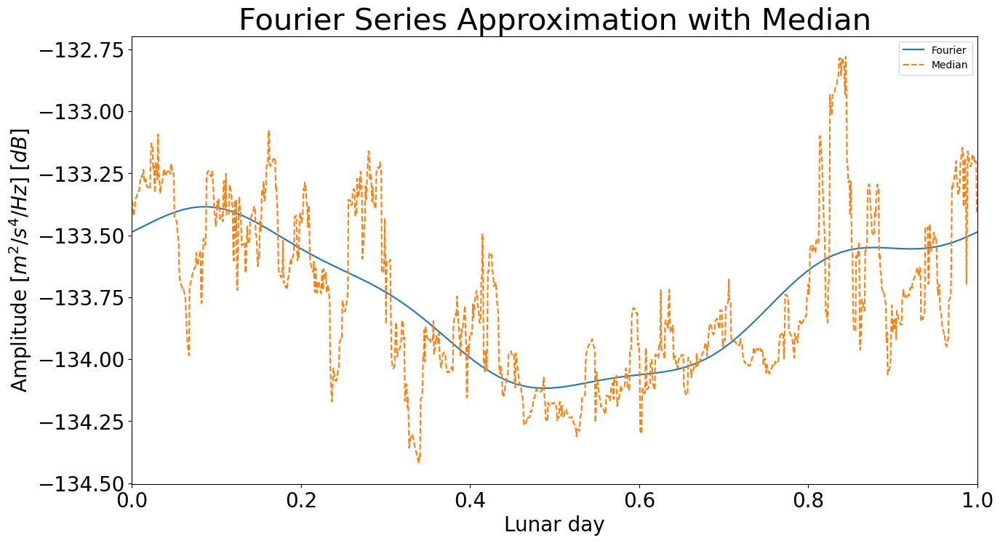

In [190]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import quad

# 주기
T = 1 # 주기 T를 설정

# median 값을 함수로 정의
def median_func(x):
    idx = int(x / T * len(median)) % len(median)
    return median[idx]

# a0 계산 
def a0(T, median_func):
    return (1 / T) * quad(median_func, 0, T)[0]

# an 계산 (n차 푸리에 계수, cos 성분)
def an(n, T, median_func):
    return (2 / T) * quad(lambda x: median_func(x) * np.cos(2 * np.pi * n * x / T), 0, T)[0]

# bn 계산 (n차 푸리에 계수, sin 성분)
def bn(n, T, median_func):
    return (2 / T) * quad(lambda x: median_func(x) * np.sin(2 * np.pi * n * x / T), 0, T)[0]

# 푸리에 급수로 근사한 함수
def fourier_series(x, terms, T, median_func):
    result = a0(T, median_func)
    for n in range(1, terms + 1): # terms는 몇 번 더할건지
        result += an(n, T, median_func) * np.cos(2 * np.pi * n * x / T) + bn(n, T, median_func) * np.sin(2 * np.pi * n * x / T)
    return result


# 푸리에 급수 계산
x_vals = np.linspace(0, T, 100)
y_fourier = [fourier_series(x, 4, T, median_func) for x in x_vals]  # 각 x 값에 대해 푸리에 급수 계산


# 결과 시각화
plt.figure(figsize=(15,8))
plt.plot(x_vals, y_fourier, label='Fourier')
plt.plot(time, median, label='Median', linestyle='--')
plt.legend()
plt.xlabel('Lunar day', fontsize = 20)
plt.ylabel('Amplitude [$m^2/s^4/Hz$] [$dB$]', fontsize = 20)
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.title('Fourier Series Approximation with Median', fontsize = 30)
plt.xlim(time[0], time[-1])
plt.show()

Text(0, 0.5, 'Amplitude [$m^2/s^4/Hz$] [$dB$]')

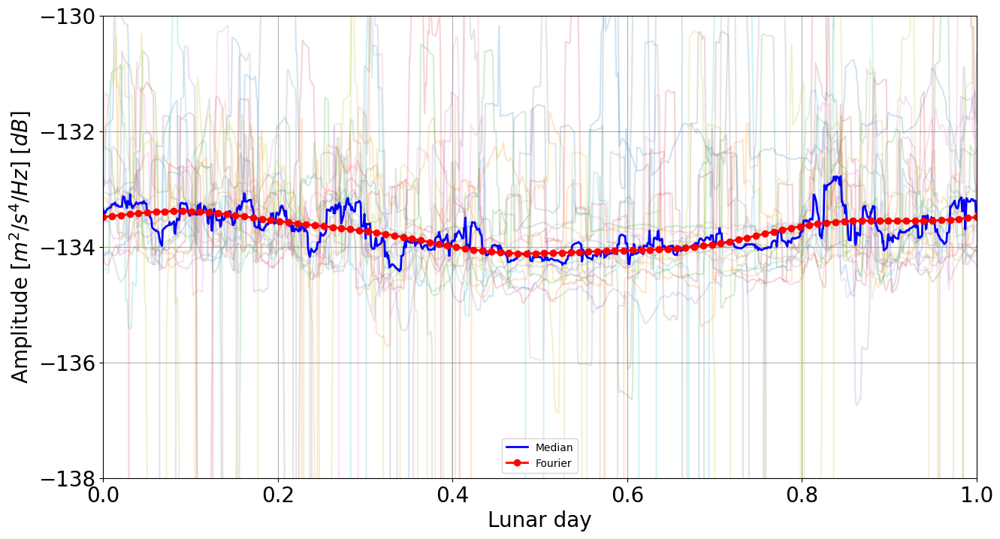

In [191]:
daily_12hour_filter_data = []
for i in range(0, len(daily_data)):
    fil = []
    for j in range(0, len(daily_data[0])):
        fil.append(daily_data[i][j : j+24])
        if j == 1394:
            break
    daily_12hour_filter_data.append(fil)
    
daily_12hour_filter_ma = [] 
for i in range(len(daily_12hour_filter_data)):
    fil = []
    for j in daily_12hour_filter_data[i]:
        fil.append(np.mean(j))

    daily_12hour_filter_ma.append(fil)


plt.figure(figsize=(15,8))
time = np.linspace(0, 1, 1395)


for day in range(len(daily_12hour_filter_ma)):
    plt.plot(time, daily_12hour_filter_ma[day], alpha = 0.2);

percentage_25 = []
median = []
percentage_75 = []
for j in range(len(daily_12hour_filter_ma[0])):
    temp = []
    for i in range(len(daily_12hour_filter_ma)):
        temp.append(daily_12hour_filter_ma[i][j])
    percentage_25.append(np.quantile(temp, 0.25))
    percentage_75.append(np.quantile(temp, 0.75))
    median.append(np.median(temp))
#plt.plot(time, percentage_25, linewidth = 3, color = 'r', label = '25%')
plt.plot(time, median, linewidth = 2, color ='b', label = 'Median')
#plt.plot(time, percentage_75, linewidth = 3, color ='b', label = '75%')
plt.plot(x_vals, y_fourier, linewidth = 2, color ='red',  marker = 'o',label='Fourier')

time = np.array(time)

plt.legend(loc='best')
plt.xlim(0,1)
plt.ylim(-138, -130)
#plt.xticks([48.67, 48.67*2, 48.67*3, 48.67*4, 48.67*5], [1,2,3,4,5], fontsize = 15)
plt.xticks(fontsize = 20)
plt.yticks([-138, -136, -134, -132, -130], fontsize = 20)
plt.grid()
plt.xlabel('Lunar day', fontsize = 20)
plt.ylabel('Amplitude [$m^2/s^4/Hz$] [$dB$]', fontsize = 20)


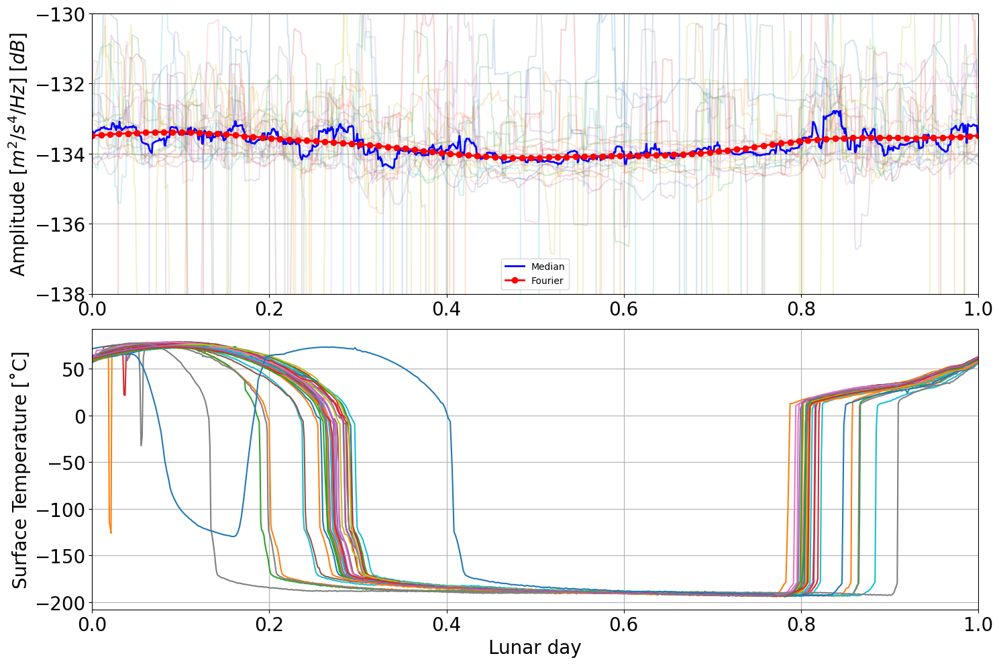

In [192]:
daily_12hour_filter_data = []
for i in range(0, len(daily_data)):
    fil = []
    for j in range(0, len(daily_data[0])):
        fil.append(daily_data[i][j : j+24])
        if j == 1394:
            break
    daily_12hour_filter_data.append(fil)
    
daily_12hour_filter_ma = [] 
for i in range(len(daily_12hour_filter_data)):
    fil = []
    for j in daily_12hour_filter_data[i]:
        fil.append(np.mean(j))
    daily_12hour_filter_ma.append(fil)


fig, axs = plt.subplots(2, 1, figsize=(15, 10))

# 첫 번째 서브플롯: daily_data와 median, Fourier series
time = np.linspace(0, 1, 1395)
for day in range(len(daily_12hour_filter_ma)):
    axs[0].plot(time, daily_12hour_filter_ma[day], alpha=0.2)

percentage_25 = []
median = []
percentage_75 = []
for j in range(len(daily_12hour_filter_ma[0])):
    temp = []
    for i in range(len(daily_12hour_filter_ma)):
        temp.append(daily_12hour_filter_ma[i][j])
    percentage_25.append(np.quantile(temp, 0.25))
    percentage_75.append(np.quantile(temp, 0.75))
    median.append(np.median(temp))

axs[0].plot(time, median, linewidth=2, color='b', label='Median')
axs[0].plot(x_vals, y_fourier, linewidth=2, color='red', marker='o', label='Fourier')

axs[0].legend(loc='best')
axs[0].set_xlim(0, 1)

axs[0].set_ylim(-138, -130)
axs[0].set_ylabel('Amplitude [$m^2/s^4/Hz$] [$dB$]', fontsize=20)
axs[0].tick_params(axis='x', labelsize=20)
axs[0].tick_params(axis='y', labelsize=20)
axs[0].grid()

# 두 번째 서브플롯: lmst_groups의 TC12
lmst_groups = {}

# Iterate over each row in the dataframe
for start_time, end_time in zip(start, end):
    lmst_prefix = start_time.strftime("%Y%m%d")
    if lmst_prefix not in lmst_groups:
        lmst_groups[lmst_prefix] = []

    for index, row in temperature.iterrows():
        if start_time < row['Time'] < end_time:
            lmst_groups[lmst_prefix].append(row)

# Convert lists to DataFrames
for key in lmst_groups:
    lmst_groups[key] = pd.DataFrame(lmst_groups[key])

# Display the grouped data
for key, group in lmst_groups.items():
    time = np.linspace(0, 1, len(group))
    if len(group) != 0:
        axs[1].plot(time, group['TC12'])

axs[1].set_xlim(0, 1)
axs[1].tick_params(axis='x', labelsize=20)
axs[1].tick_params(axis='y', labelsize=20)
axs[1].grid()
axs[1].set_xlabel('Lunar day', fontsize=20)
axs[1].set_ylabel('Surface Temperature [˚C]', fontsize=20)

plt.tight_layout()
plt.show()


52244


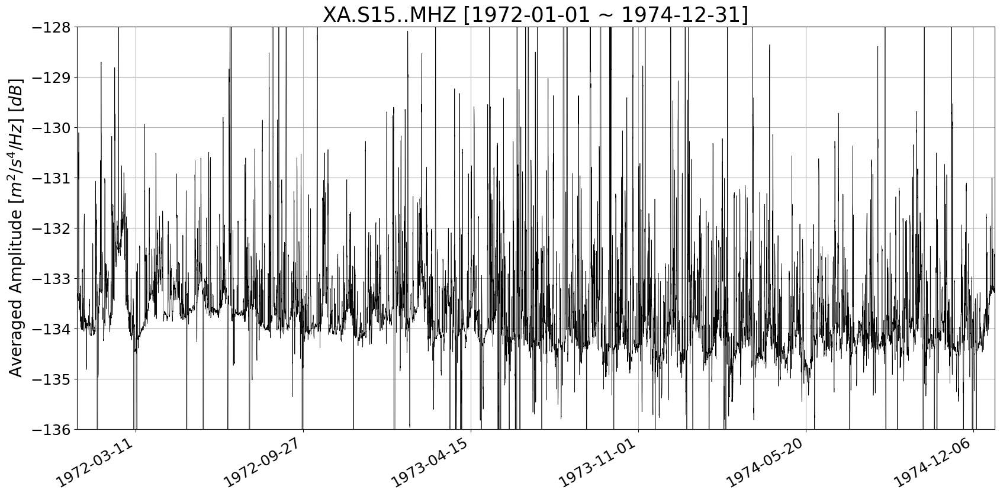

In [191]:
median_amplitude, tt = draw_periodicity4(ppsd, 1.0, 3.5, 50, ylim_min = -136, ylim_max = -128)

52244


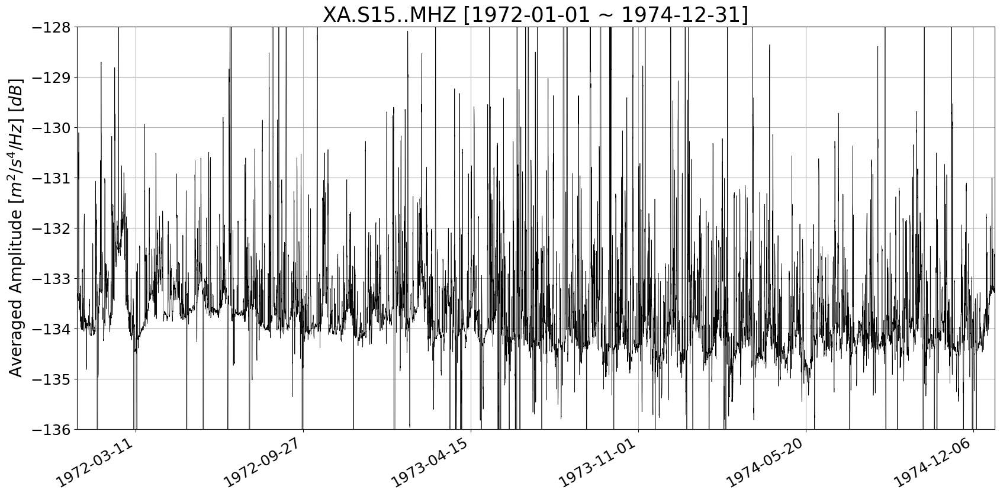

In [199]:
median_amplitude, tt = draw_periodicity4(ppsd, 1.0, 3.5, 50, ylim_min = -136, ylim_max = -128)

In [302]:
1417/  len(median_amplitude)

0.02713675622881437

Calculating Fourier Series:   0%|          | 0/1000 [00:00<?, ?it/s]C:\Users\neimb\AppData\Local\Temp\ipykernel_17548\2348412475.py:18: IntegrationWarning: The maximum number of subdivisions (50) has been achieved.
  If increasing the limit yields no improvement it is advised to analyze 
  the integrand in order to determine the difficulties.  If the position of a 
  local difficulty can be determined (singularity, discontinuity) one will 
  probably gain from splitting up the interval and calling the integrator 
  on the subranges.  Perhaps a special-purpose integrator should be used.
  return (1 / T) * quad(median_func, 0, T)[0]
C:\Users\neimb\AppData\Local\Temp\ipykernel_17548\2348412475.py:22: IntegrationWarning: The maximum number of subdivisions (50) has been achieved.
  If increasing the limit yields no improvement it is advised to analyze 
  the integrand in order to determine the difficulties.  If the position of a 
  local difficulty can be determined (singularity, discontinu

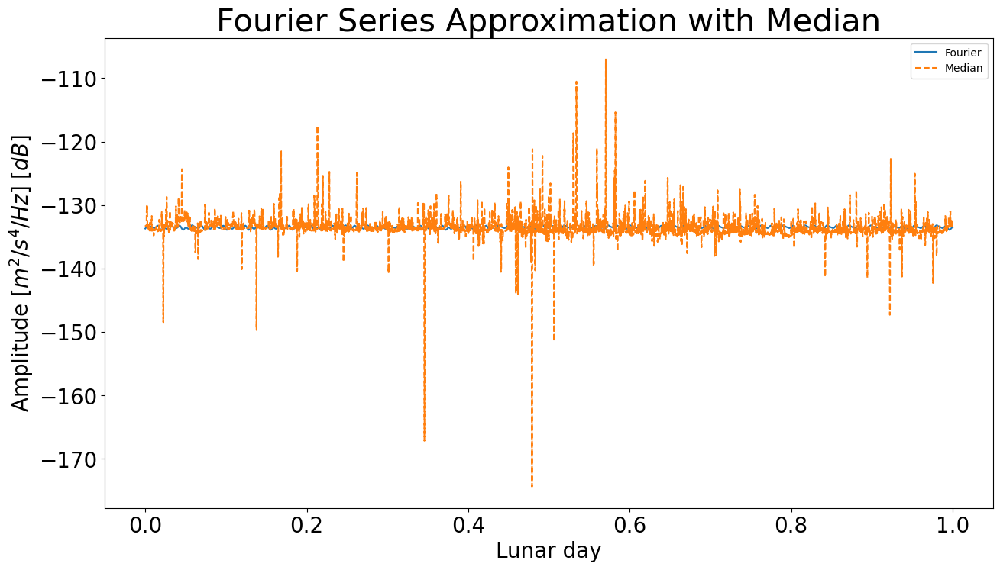

In [197]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import quad
from tqdm import tqdm

median_amplitude = list(median_amplitude)

# 주기
T = 0.02712377014662532 # 주기 T를 설정

# median 값을 함수로 정의
def median_func(x):
    idx = int(x / T * len(median_amplitude)) % len(median_amplitude)
    return median_amplitude[idx]

# a0 계산 
def a0(T, median_func):
    return (1 / T) * quad(median_func, 0, T)[0]

# an 계산 (n차 푸리에 계수, cos 성분)
def an(n, T, median_func):
    return (2 / T) * quad(lambda x: median_func(x) * np.cos(2 * np.pi * n * x / T), 0, T)[0]

# bn 계산 (n차 푸리에 계수, sin 성분)
def bn(n, T, median_func):
    return (2 / T) * quad(lambda x: median_func(x) * np.sin(2 * np.pi * n * x / T), 0, T)[0]

# 푸리에 급수로 근사한 함수
def fourier_series(x, terms, T, median_func):
    result = a0(T, median_func)
    for n in range(1, terms + 1): # terms는 몇 번 더할건지
        result += an(n, T, median_func) * np.cos(2 * np.pi * n * x / T) + bn(n, T, median_func) * np.sin(2 * np.pi * n * x / T)
    return result

# 푸리에 급수 계산
x_vals = np.linspace(0, 1.0, 1000)
y_fourier = [fourier_series(x, 4, T, median_func) for x in tqdm(x_vals, desc="Calculating Fourier Series")]

# tt 0~1사이로 정규화
tt_normalized = (tt - min(tt)) / (max(tt) - min(tt))

# 결과 시각화
plt.figure(figsize=(15,8))
plt.plot(x_vals, y_fourier, label='Fourier')
plt.plot(tt_normalized, median_amplitude, label='Median', linestyle='--')
plt.legend()
plt.xlabel('Lunar day', fontsize = 20)
plt.ylabel('Amplitude [$m^2/s^4/Hz$] [$dB$]', fontsize = 20)
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.title('Fourier Series Approximation with Median', fontsize = 30)
#plt.xlim(time[0], time[-1])
plt.show()


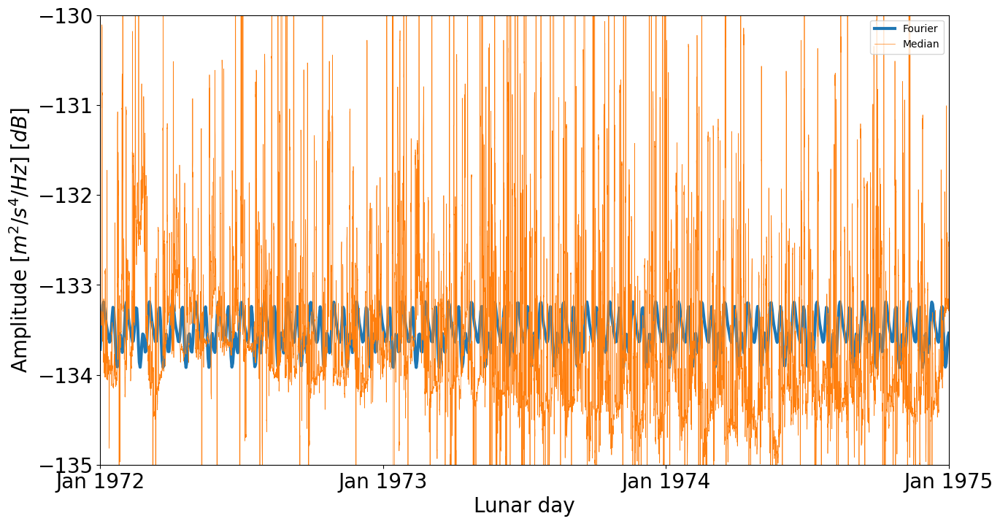

In [198]:
plt.figure(figsize=(15,8))
plt.plot(x_vals, y_fourier, label='Fourier', linewidth = 3)
plt.plot(tt_normalized, median_amplitude, label='Median', linestyle='-', linewidth = 0.5)
plt.legend()
plt.xlabel('Lunar day', fontsize = 20)
plt.ylabel('Amplitude [$m^2/s^4/Hz$] [$dB$]', fontsize = 20)
plt.xticks([0.0, 1/3, 2/3, 1.0], labels = ['Jan 1972', 'Jan 1973', 'Jan 1974', 'Jan 1975'], fontsize = 20)
plt.yticks(fontsize = 20)
#plt.title('Fourier Series Approximation with Median', fontsize = 30)
plt.xlim(tt_normalized[0], tt_normalized[-1])
plt.ylim(-135,-130)
plt.show()

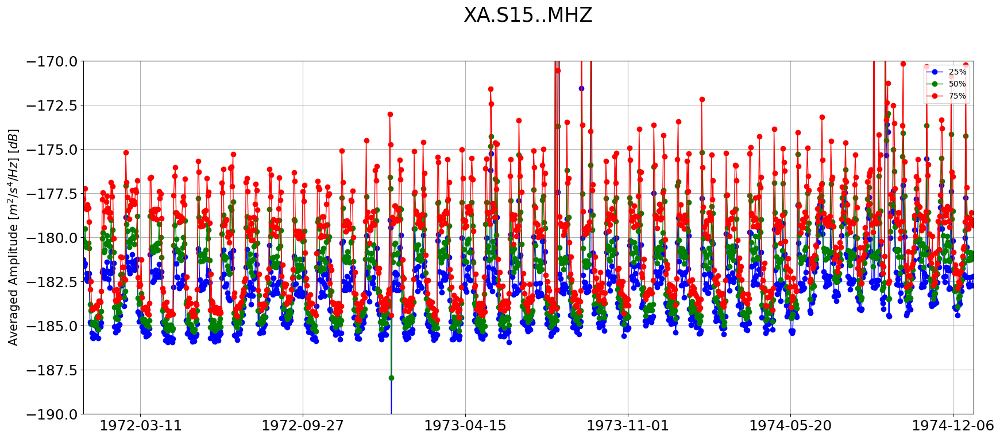

In [212]:
daily_time, daily_avg_amplitude = noise_sequence_daily(ppsd, freqmin = 0.01, freqmax = 0.05, title = 'XA.S15..MHZ', ylim = (-190,-170))

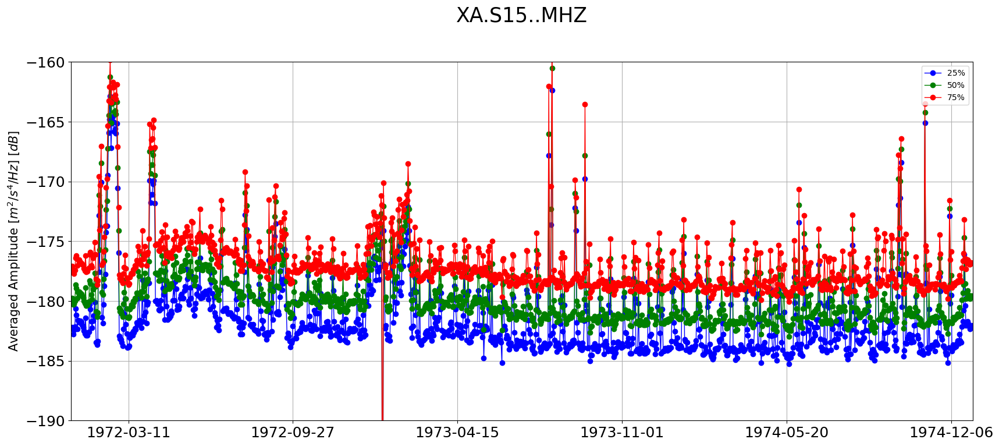

In [214]:
daily_time, daily_avg_amplitude = noise_sequence_daily(ppsd, freqmin = 0.3, freqmax = 0.8, title = 'XA.S15..MHZ', ylim = (-190,-160))

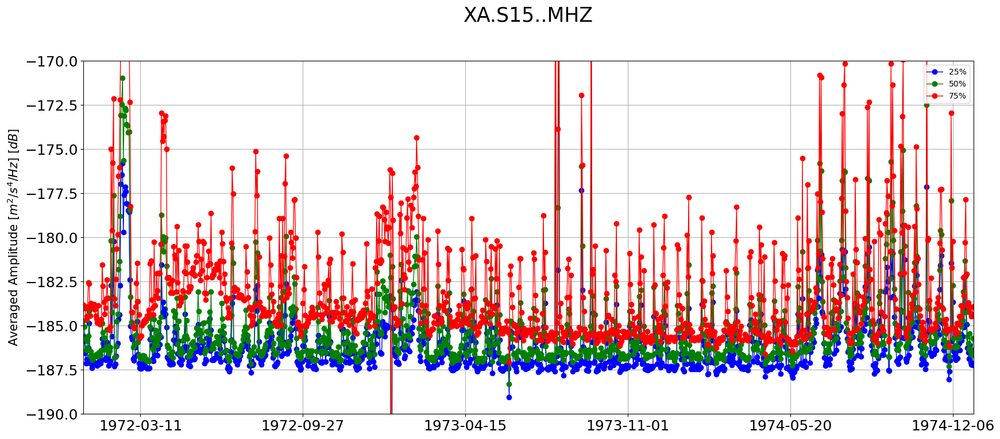

In [216]:
daily_time, daily_avg_amplitude = noise_sequence_daily(ppsd, freqmin = 0.1, freqmax = 0.5, title = 'XA.S15..MHZ', ylim = (-190,-170))

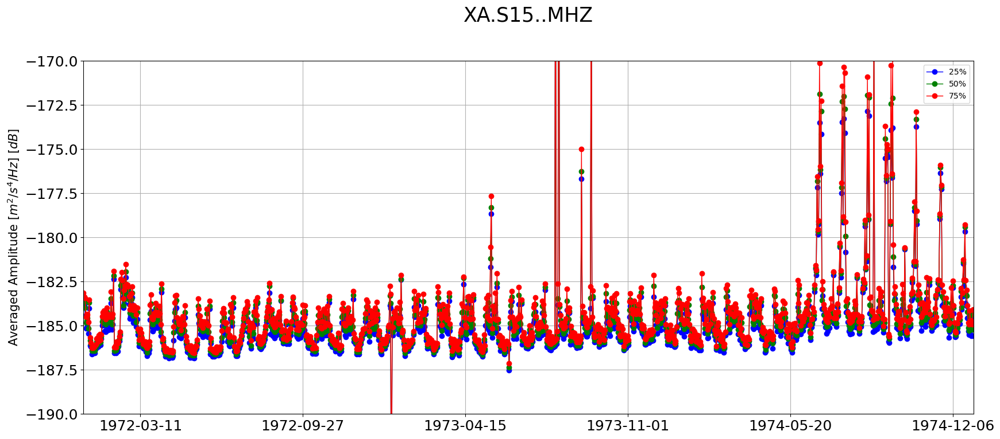

In [217]:
daily_time, daily_avg_amplitude = noise_sequence_daily(ppsd, freqmin = 0.05, freqmax = 0.1, title = 'XA.S15..MHZ', ylim = (-190,-170))

---

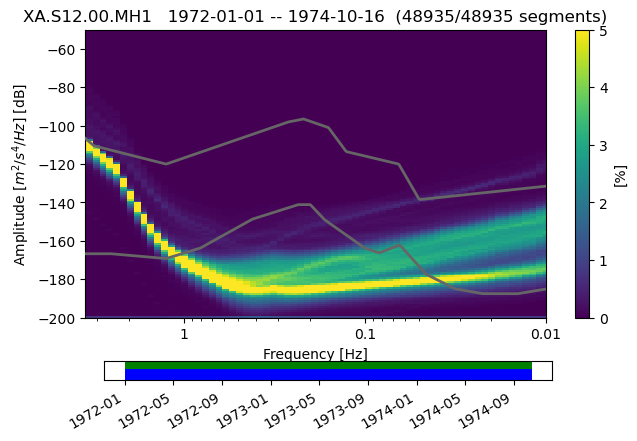

In [26]:
ppsd = PPSD.load_npz('./npz_12_MH1/1972merged.npz')
ppsd.add_npz('./npz_12_MH1/1973merged.npz')
ppsd.add_npz('./npz_12_MH1/1974merged.npz')
ppsd.plot(xaxis_frequency=True, period_lim= (3.5, 0.01), max_percentage=5, grid=False);

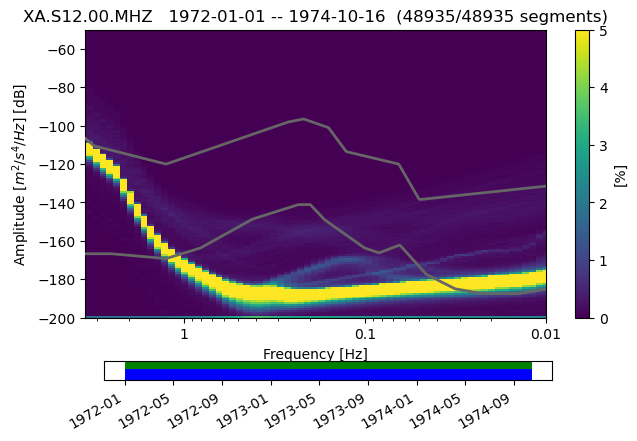

In [38]:
ppsd = PPSD.load_npz('./npz_12_MHZ/1972merged.npz')
ppsd.add_npz('./npz_12_MHZ/1973merged.npz')
ppsd.add_npz('./npz_12_MHZ/1974merged.npz')
ppsd.plot(xaxis_frequency=True, period_lim= (3.5, 0.01), max_percentage=5, grid=False);

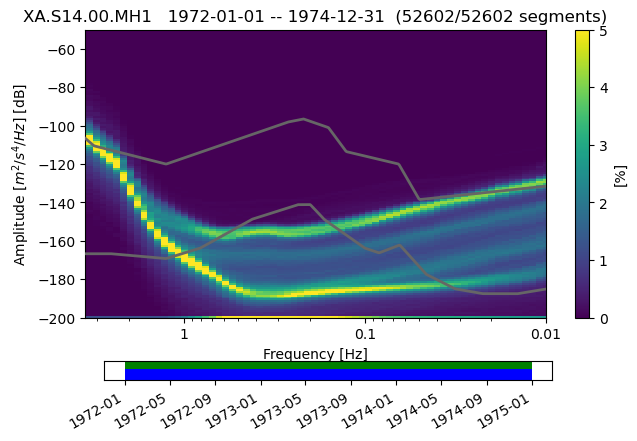

In [29]:
ppsd = PPSD.load_npz('./npz_14_MH1/1972merged.npz')
ppsd.add_npz('./npz_14_MH1/1973merged.npz')
ppsd.add_npz('./npz_14_MH1/1974merged.npz')
ppsd.plot(xaxis_frequency=True, period_lim= (3.5, 0.01), max_percentage=5, grid=False);

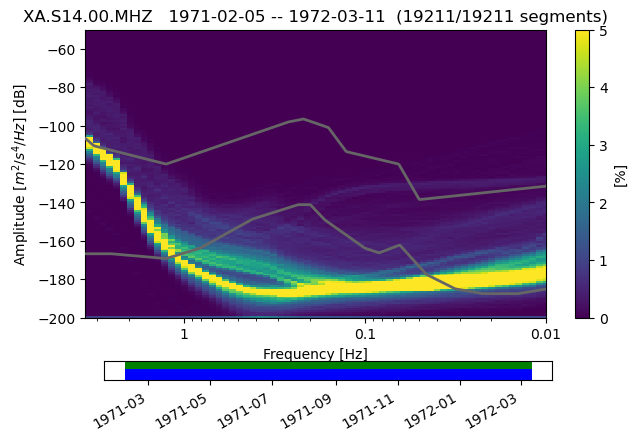

In [30]:
ppsd = PPSD.load_npz('./npz_14_MHZ/1971merged.npz')
ppsd.plot(xaxis_frequency=True, period_lim= (3.5, 0.01), max_percentage=5, grid=False);

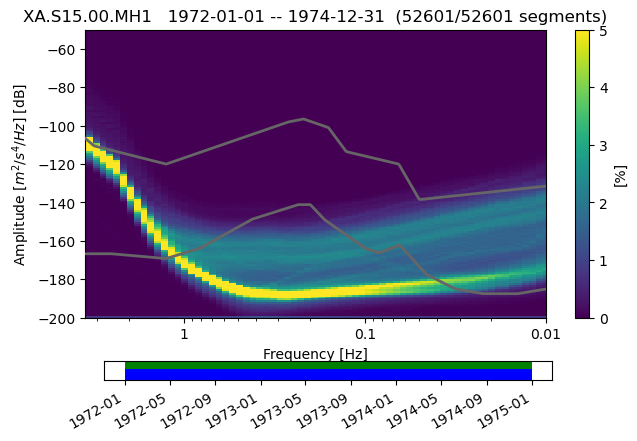

In [31]:
ppsd = PPSD.load_npz('./npz_15_MH1/1972merged.npz')
ppsd.add_npz('./npz_15_MH1/1973merged.npz')
ppsd.add_npz('./npz_15_MH1/1974merged.npz')
ppsd.plot(xaxis_frequency=True, period_lim= (3.5, 0.01), max_percentage=5, grid=False);

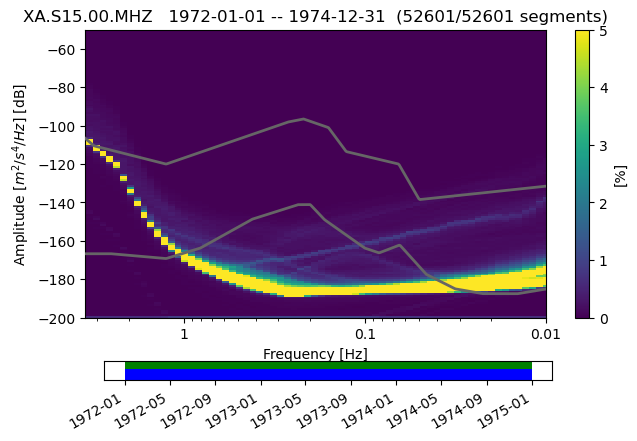

In [179]:
ppsd = PPSD.load_npz('./npz_15_MHZ/1972merged.npz')
ppsd.add_npz('./npz_15_MHZ/1973merged.npz')
ppsd.add_npz('./npz_15_MHZ/1974merged.npz')
ppsd.plot(xaxis_frequency=True, period_lim= (3.5, 0.01), max_percentage=5, grid=False);

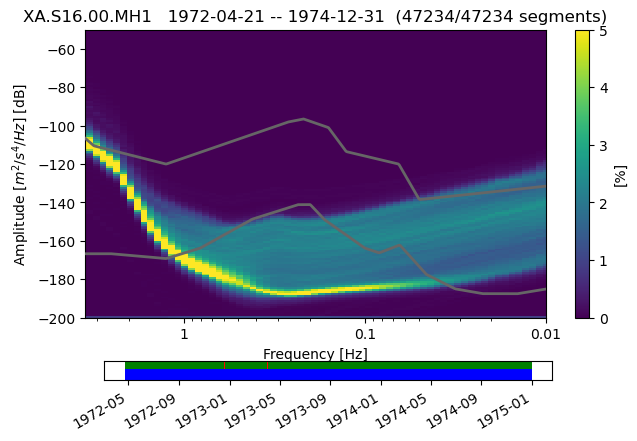

In [33]:
ppsd = PPSD.load_npz('./npz_16_MH1/1972merged.npz')
ppsd.add_npz('./npz_16_MH1/1973merged.npz')
ppsd.add_npz('./npz_16_MH1/1974merged.npz')
ppsd.plot(xaxis_frequency=True, period_lim= (3.5, 0.01), max_percentage=5, grid=False);

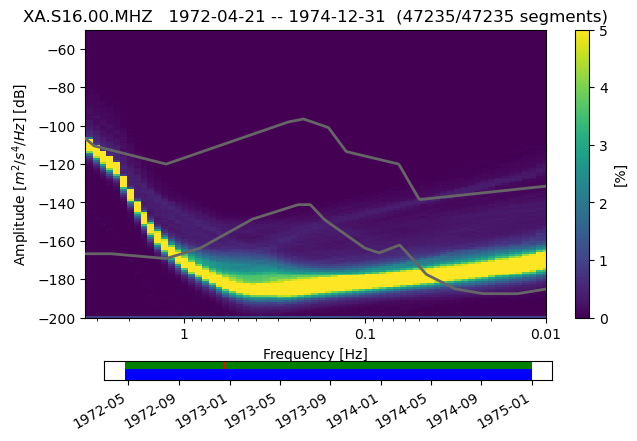

In [34]:
ppsd = PPSD.load_npz('./npz_16_MHZ/1972merged.npz')
ppsd.add_npz('./npz_16_MHZ/1973merged.npz')
ppsd.add_npz('./npz_16_MHZ/1974merged.npz')
ppsd.plot(xaxis_frequency=True, period_lim= (3.5, 0.01), max_percentage=5, grid=False);

---
# 14호, 1972~1975, 시간창 1hour, overlap 50%, 저주파수(0.01~ 0.1), percentage 15% 

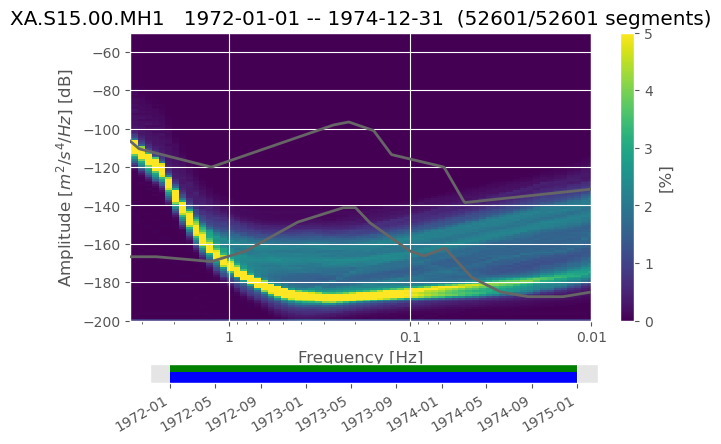

In [29]:
ppsd = PPSD.load_npz('./npz_15_MH1/1972merged.npz')
ppsd.add_npz('./npz_15_MH1/1973merged.npz')
ppsd.add_npz('./npz_15_MH1/1974merged.npz')
ppsd.plot(xaxis_frequency=True, period_lim= (3.5, 0.01), max_percentage=5, grid=False);

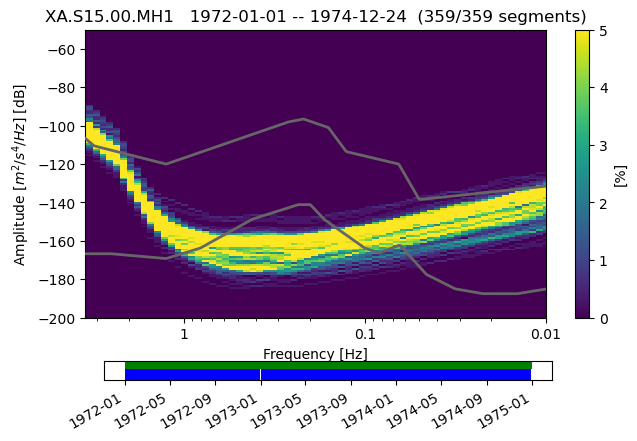

In [6]:
ppsd = PPSD.load_npz('./npz_15_MH1/1972144hrmerged.npz')
ppsd.add_npz('./npz_15_MH1/1973144hrmerged.npz')
ppsd.add_npz('./npz_15_MH1/1974144hrmerged.npz')
ppsd.plot(xaxis_frequency=True, period_lim= (3.5, 0.01), max_percentage=5, grid=False);

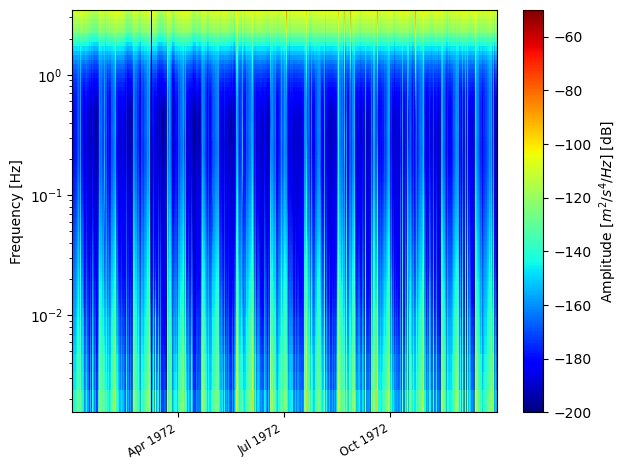

In [84]:
plot_spectrogram2(ppsd, grid=False, cmap='jet', clim = [-200, -50]);

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


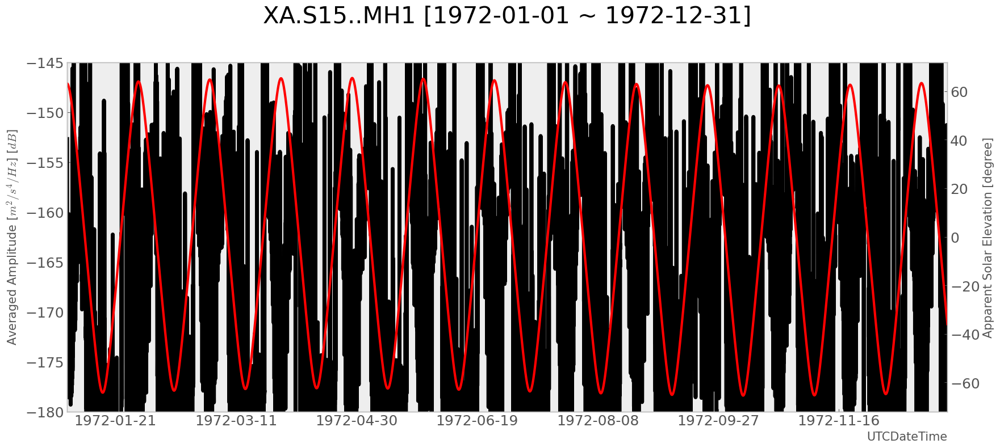

In [92]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 15, ylim_min = -180, ylim_max = -145, xlim_max = 1095, xlim_min = 730)

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


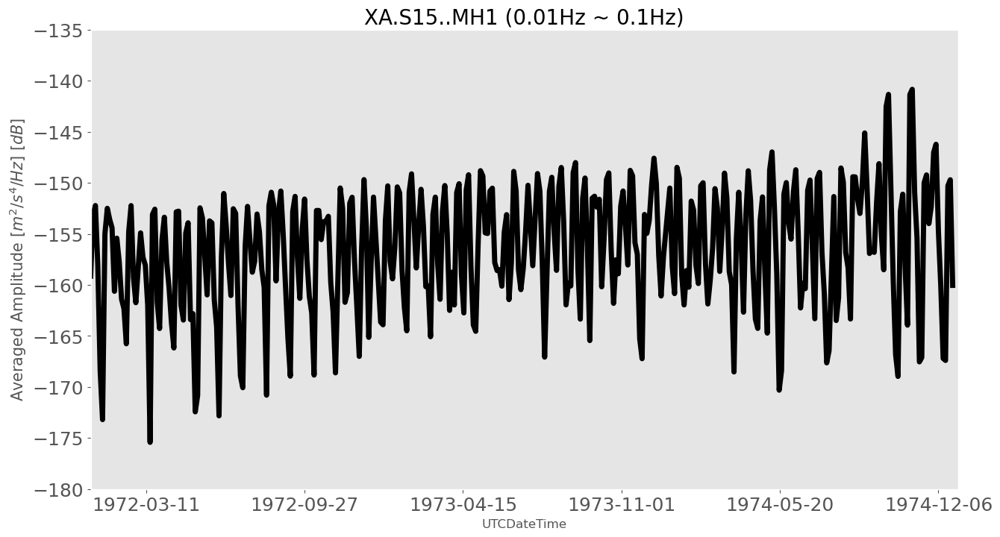

In [11]:
avg_amplitude, time = draw_periodicity2(0.01, 0.1, 15, ylim_min = -180, ylim_max = -135, xlim_max = 1095 + 365 * 2 , xlim_min = 730)

In [98]:
len(avg_amplitude)

52601

In [102]:
np.where(np.array(avg_amplitude[730:1095]) >= -160)

(array([  2,   3,  12,  13, 355, 356, 363, 364], dtype=int64),)

In [95]:
avg_amplitude[730]

-187.78103942871093

In [96]:
time[0]

730.0

C:\Users\neimb\AppData\Local\Temp\ipykernel_24112\4134508518.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))


487700.9542248203


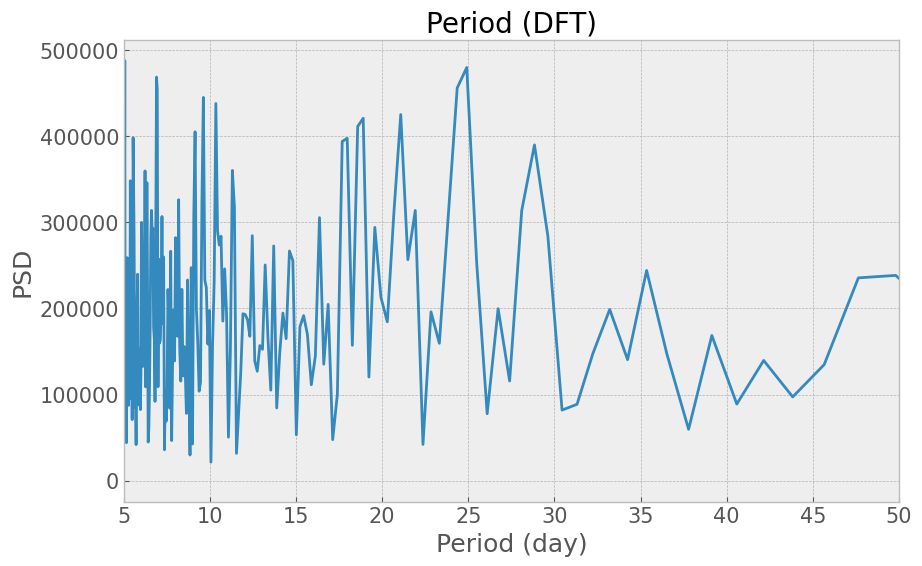

In [93]:
fft(avg_amplitude, time)

---
# 14호, 1972~1975, 시간창 1hour, overlap 50%, 저주파수(0.01~ 0.1), percentage 25% 

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


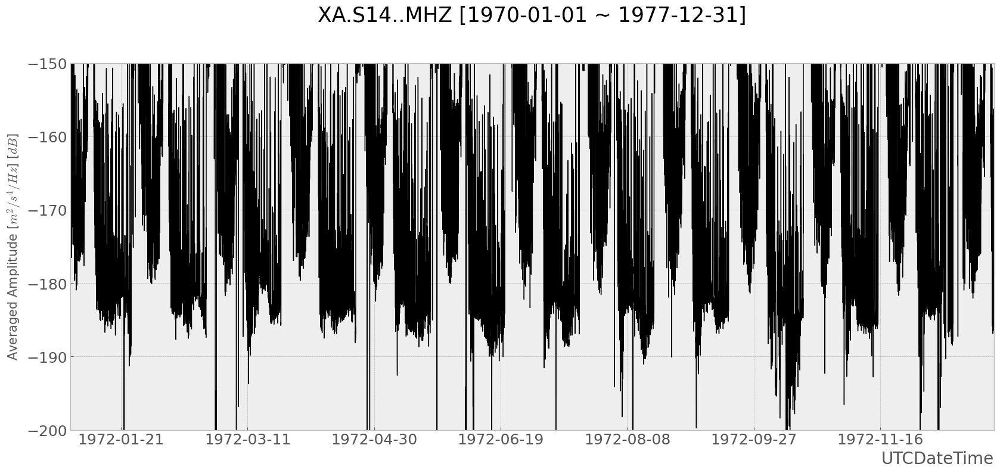

In [28]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 25, ylim_min = -200, ylim_max = -150, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22932\2153210626.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))


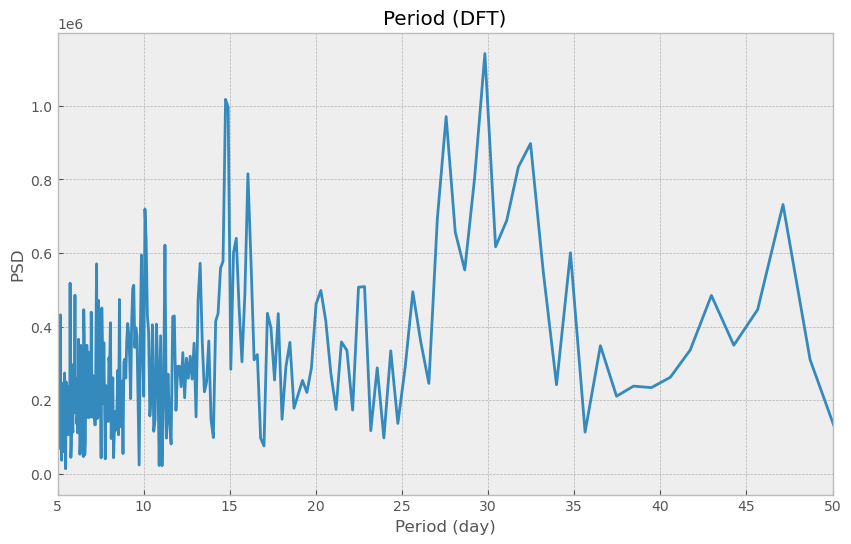

In [29]:
fft(avg_amplitude, time)

---
# 14호, 1970~1973, 시간창 24hour, overlap 50%, 저주파수(0.01~ 0.1), percentage 15% 

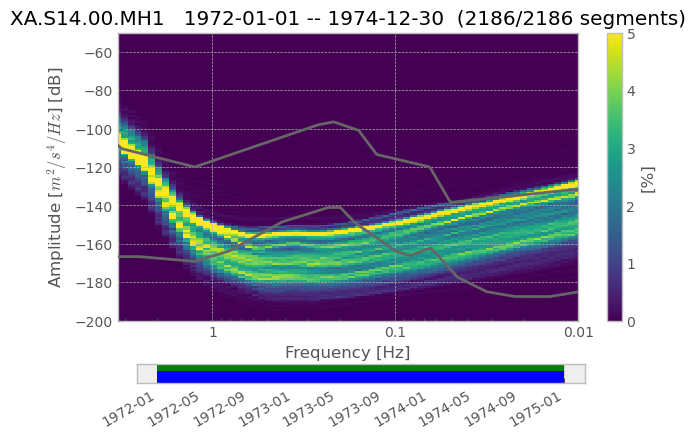

In [39]:
ppsd = PPSD.load_npz('./npz_14_MH1/197224hrmerged.npz')
ppsd.add_npz('./npz_14_MH1/197324hrmerged.npz')
ppsd.add_npz('./npz_14_MH1/197424hrmerged.npz')
ppsd.plot(xaxis_frequency=True, period_lim= (3.3, 0.01), max_percentage=5, grid=False);

c:\Users\neimb\anaconda3\Lib\site-packages\obspy\imaging\util.py:266: UserWarning: AutoDateLocator was unable to pick an appropriate interval for this date range. It may be necessary to add an interval value to the AutoDateLocator's intervald dictionary. Defaulting to 6.
  plt.setp(ax.get_xticklabels(), fontsize='small')
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\3300635716.py:58: UserWarning: AutoDateLocator was unable to pick an appropriate interval for this date range. It may be necessary to add an interval value to the AutoDateLocator's intervald dictionary. Defaulting to 6.
  fig.tight_layout()
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\3300635716.py:63: UserWarning: AutoDateLocator was unable to pick an appropriate interval for this date range. It may be necessary to add an interval value to the AutoDateLocator's intervald dictionary. Defaulting to 6.
  plt.draw()
c:\Users\neimb\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: AutoDateLocator

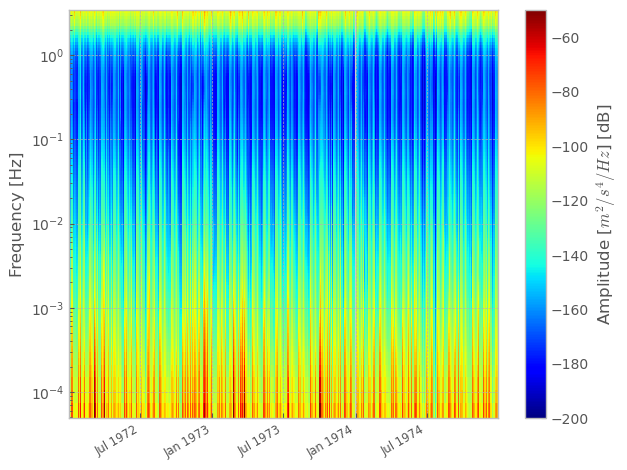

In [40]:
plot_spectrogram2(ppsd, grid=False, cmap='jet', clim = [-200, -50]);

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


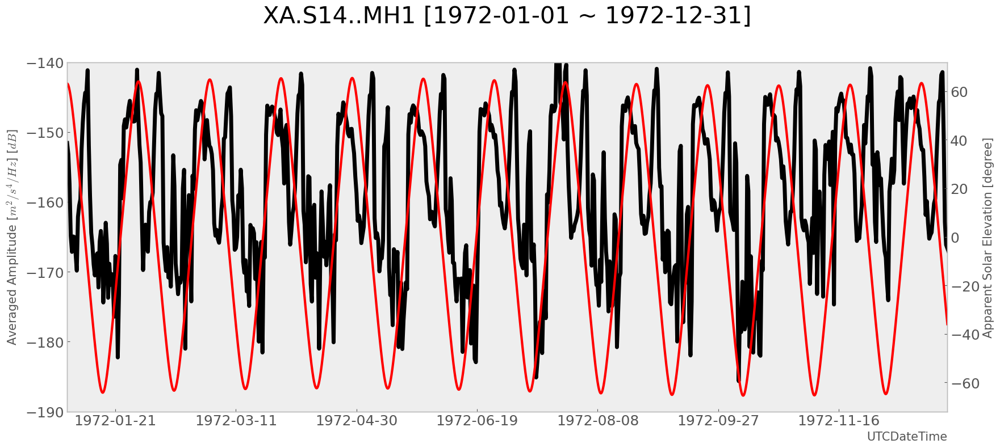

In [41]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 15, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:19: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values
c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]


8888.830000820484


posx and posy should be finite values


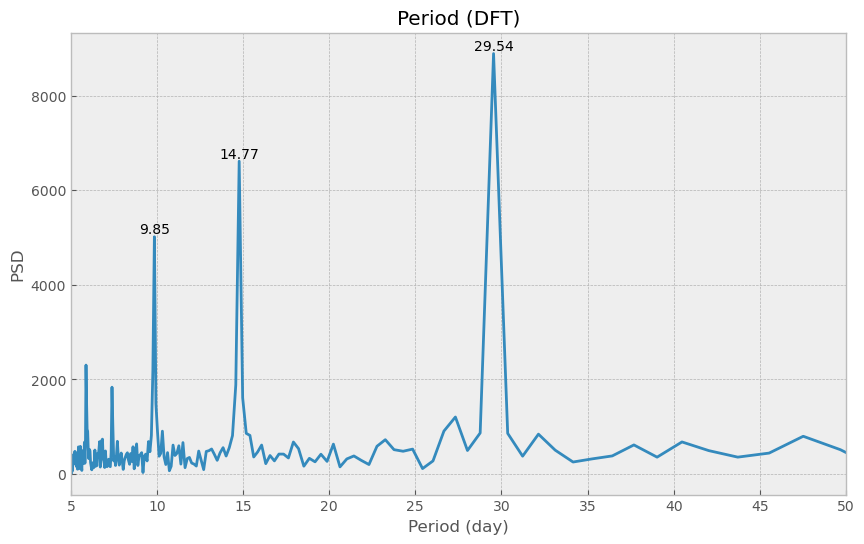

In [42]:
fft(avg_amplitude, time)

---
# 14호, 1972~1975, 시간창 24hour, overlap 50%, 저주파수(0.01~ 0.1), percentage 25% 

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


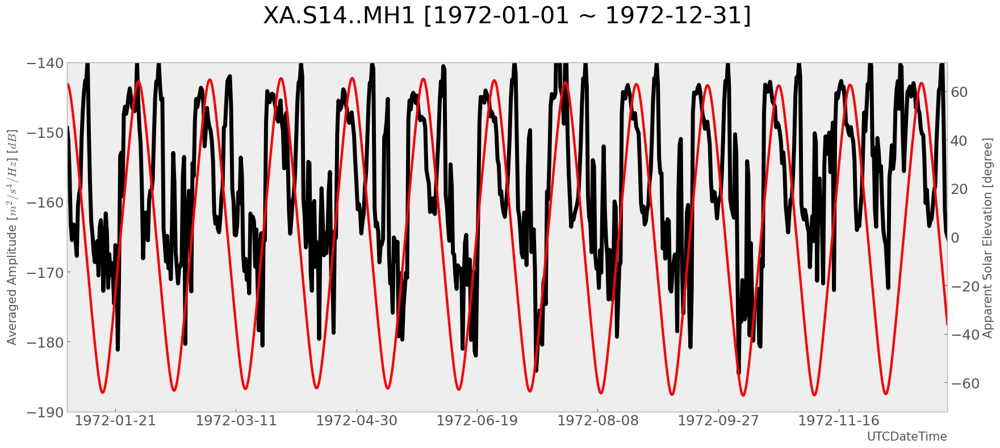

In [43]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 25, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:19: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values
c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]


9095.104422669507


posx and posy should be finite values


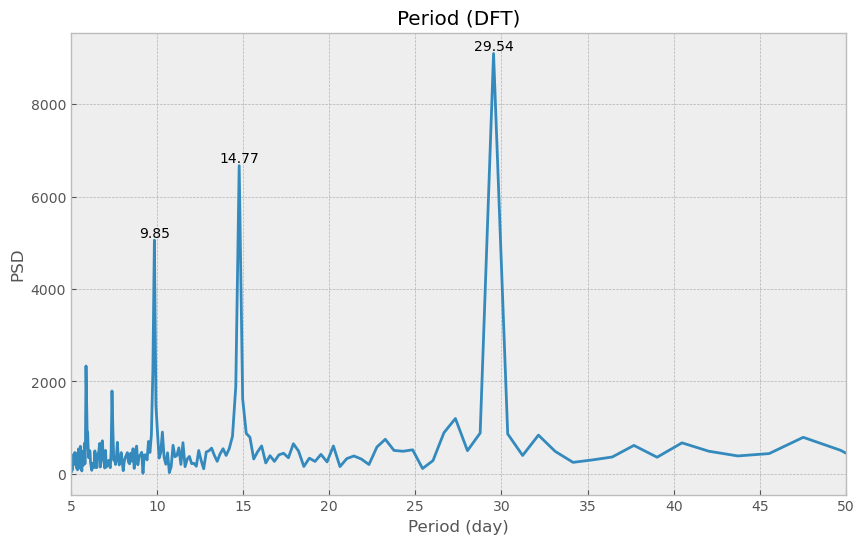

In [44]:
fft(avg_amplitude, time)

---
# 14호, 1972~1975, 시간창 48hour, overlap 50%, 저주파수(0.01~ 0.1), percentage 15% 

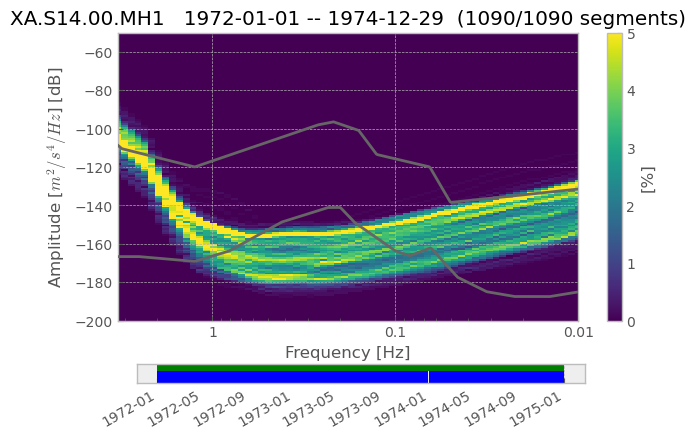

In [51]:
ppsd = PPSD.load_npz('./npz_14_MH1/197248hrmerged.npz')
ppsd.add_npz('./npz_14_MH1/197348hrmerged.npz')
ppsd.add_npz('./npz_14_MH1/197448hrmerged.npz')
ppsd.plot(xaxis_frequency=True, period_lim= (3.3, 0.01), max_percentage=5, grid=False);

c:\Users\neimb\anaconda3\Lib\site-packages\obspy\imaging\util.py:266: UserWarning: AutoDateLocator was unable to pick an appropriate interval for this date range. It may be necessary to add an interval value to the AutoDateLocator's intervald dictionary. Defaulting to 6.
  plt.setp(ax.get_xticklabels(), fontsize='small')
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\3300635716.py:58: UserWarning: AutoDateLocator was unable to pick an appropriate interval for this date range. It may be necessary to add an interval value to the AutoDateLocator's intervald dictionary. Defaulting to 6.
  fig.tight_layout()
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\3300635716.py:63: UserWarning: AutoDateLocator was unable to pick an appropriate interval for this date range. It may be necessary to add an interval value to the AutoDateLocator's intervald dictionary. Defaulting to 6.
  plt.draw()
c:\Users\neimb\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: AutoDateLocator

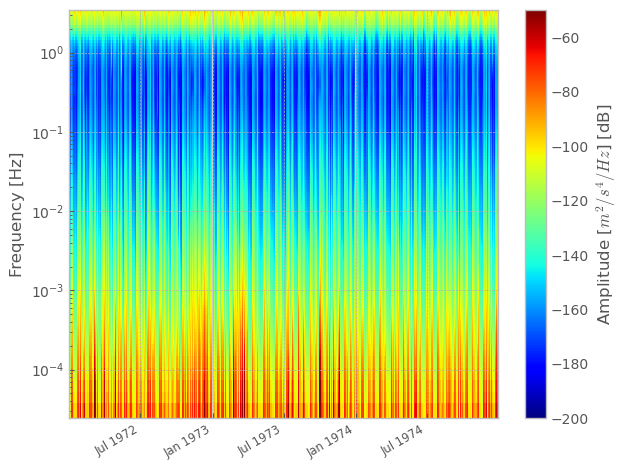

In [52]:
plot_spectrogram2(ppsd, grid=False, cmap='jet', clim = [-200, -50]);

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


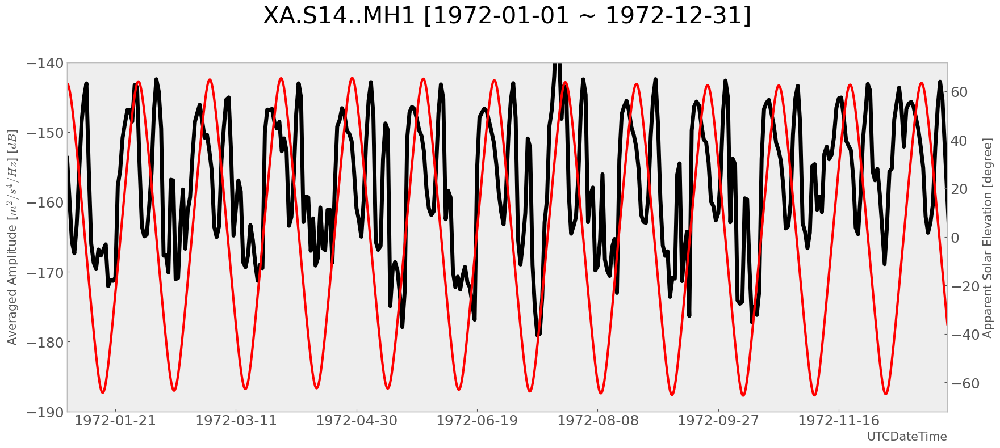

In [53]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 15, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:19: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values


3961.9480816620344


c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]
posx and posy should be finite values


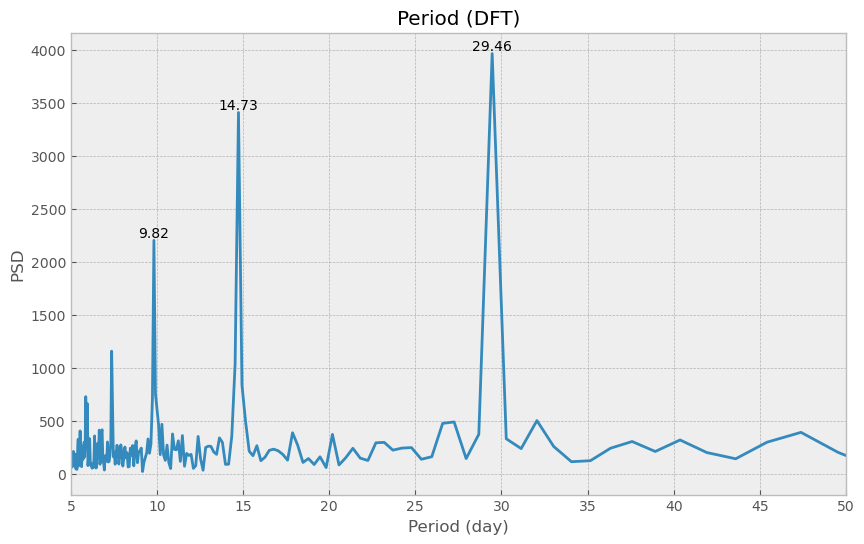

In [54]:
fft(avg_amplitude, time)

---
# 14호, 1972~1975, 시간창 48hour, overlap 50%, 저주파수(0.01~ 0.1), percentage 25% 

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


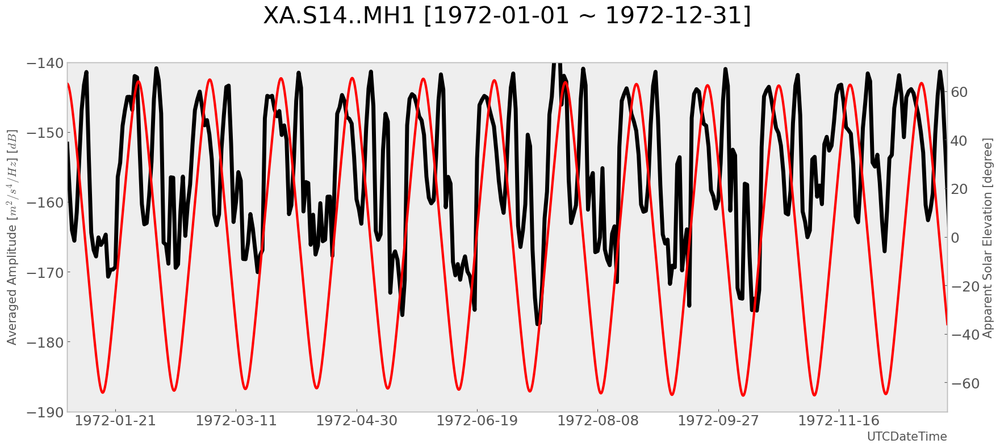

In [55]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 25, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:19: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values
c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]


4078.85491695556


posx and posy should be finite values


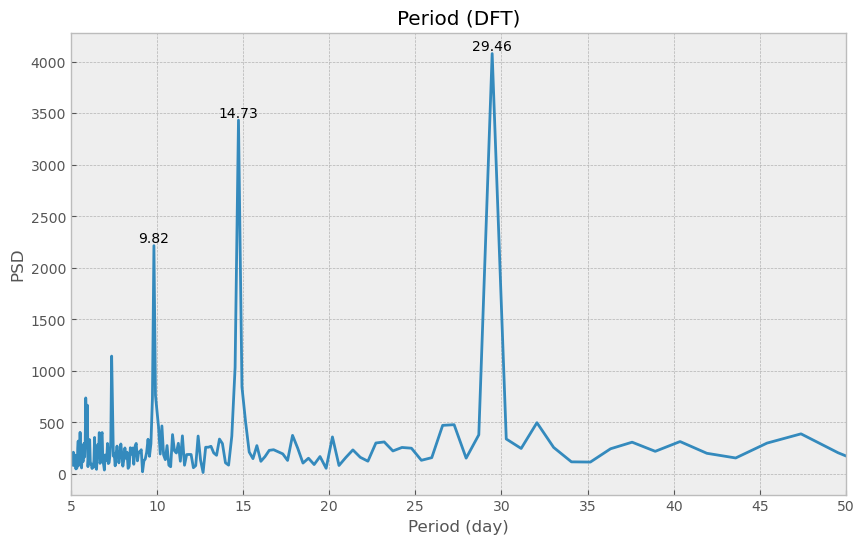

In [56]:
fft(avg_amplitude, time)

---
# 14호, 1972~1975, 시간창 48hour, overlap 75%, 저주파수(0.01~ 0.1), percentage 15% 

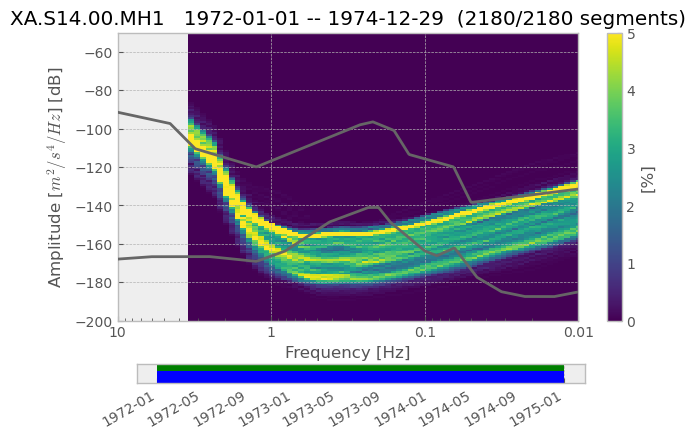

In [57]:
ppsd = PPSD.load_npz('./npz_14_MH1/197248hr75merged.npz')
ppsd.add_npz('./npz_14_MH1/197348hr75merged.npz')
ppsd.add_npz('./npz_14_MH1/197448hr75merged.npz')
ppsd.plot(xaxis_frequency=True, period_lim= (10, 0.01), max_percentage=5, grid=False);

c:\Users\neimb\anaconda3\Lib\site-packages\obspy\imaging\util.py:266: UserWarning: AutoDateLocator was unable to pick an appropriate interval for this date range. It may be necessary to add an interval value to the AutoDateLocator's intervald dictionary. Defaulting to 6.
  plt.setp(ax.get_xticklabels(), fontsize='small')
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\3300635716.py:58: UserWarning: AutoDateLocator was unable to pick an appropriate interval for this date range. It may be necessary to add an interval value to the AutoDateLocator's intervald dictionary. Defaulting to 6.
  fig.tight_layout()
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\3300635716.py:63: UserWarning: AutoDateLocator was unable to pick an appropriate interval for this date range. It may be necessary to add an interval value to the AutoDateLocator's intervald dictionary. Defaulting to 6.
  plt.draw()
c:\Users\neimb\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: AutoDateLocator

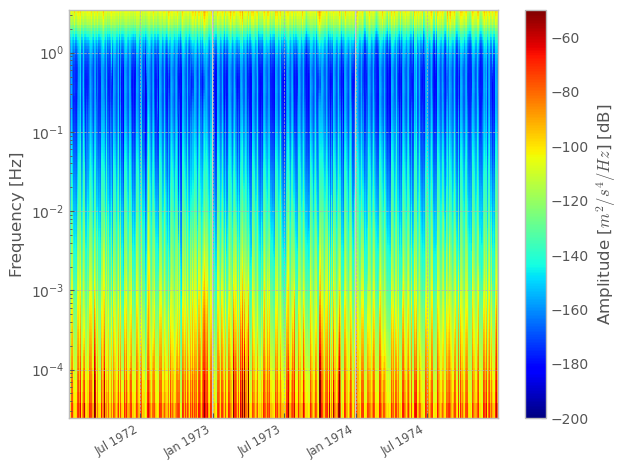

In [58]:
plot_spectrogram2(ppsd, grid=False, cmap='jet', clim = [-200, -50]);

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


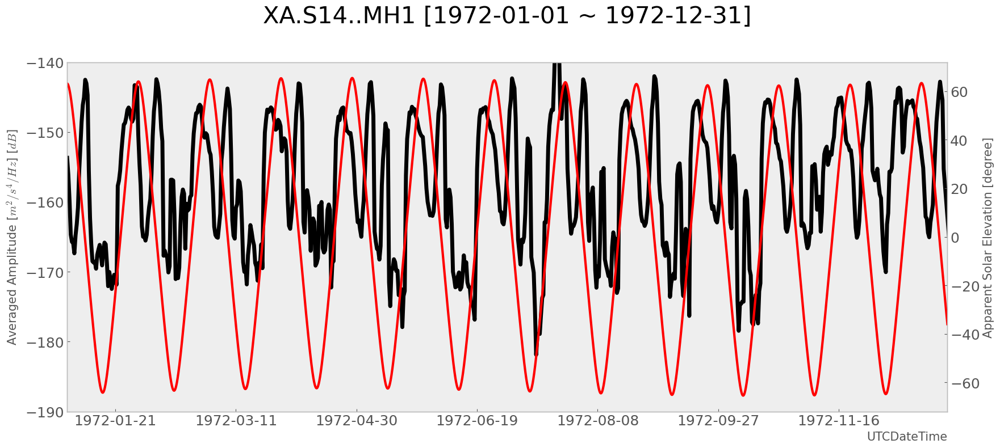

In [59]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 15, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:19: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)


7884.640316776372


posx and posy should be finite values
c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]
posx and posy should be finite values


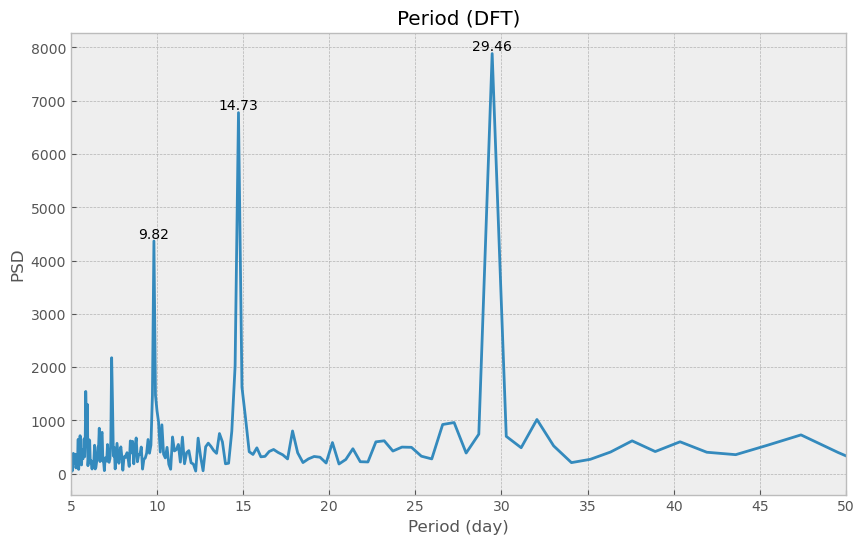

In [60]:
fft(avg_amplitude, time)

---
# 14호, 1972~1975, 시간창 48hour, overlap 75%, 저주파수(0.01~ 0.1), percentage 25% 

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


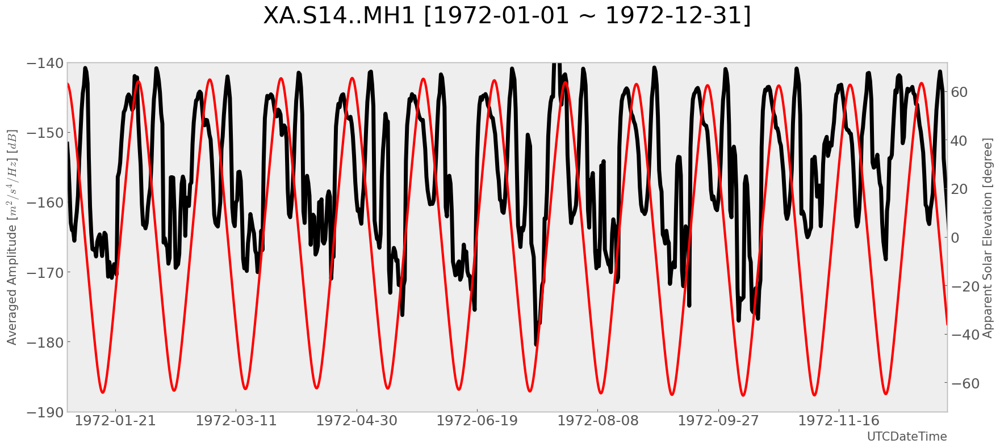

In [61]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 25, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:19: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values
c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]


8113.658412827556


posx and posy should be finite values


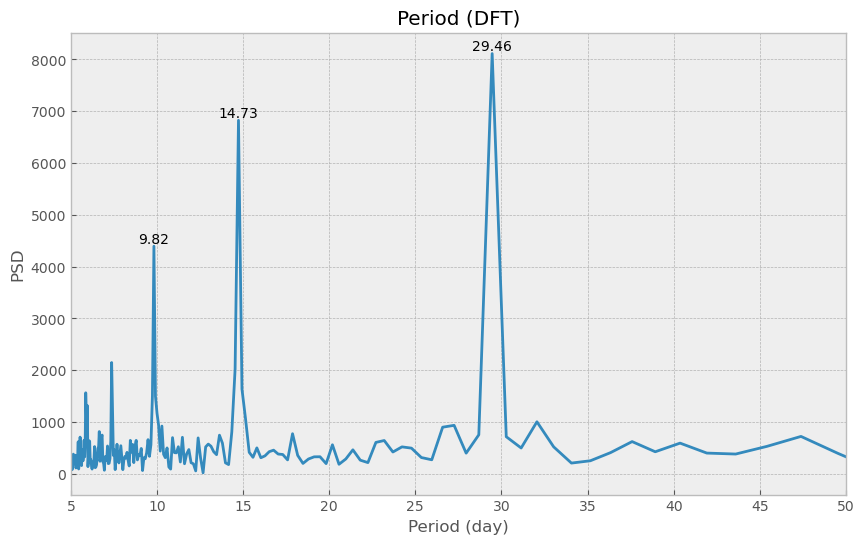

In [62]:
fft(avg_amplitude, time)

---
# 14호, 1972~1975, 시간창 48hour, overlap 80%, 저주파수(0.01~ 0.1), percentage 15% 

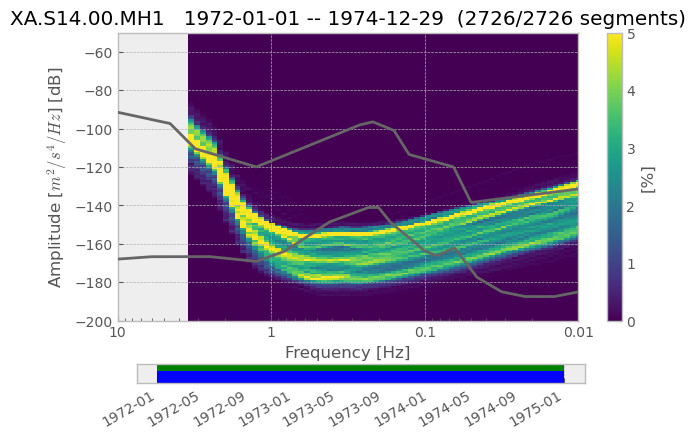

In [63]:
ppsd = PPSD.load_npz('./npz_14_MH1/197248hr80merged.npz')
ppsd.add_npz('./npz_14_MH1/197348hr80merged.npz')
ppsd.add_npz('./npz_14_MH1/197448hr80merged.npz')
ppsd.plot(xaxis_frequency=True, period_lim= (10, 0.01), max_percentage=5, grid=False);

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


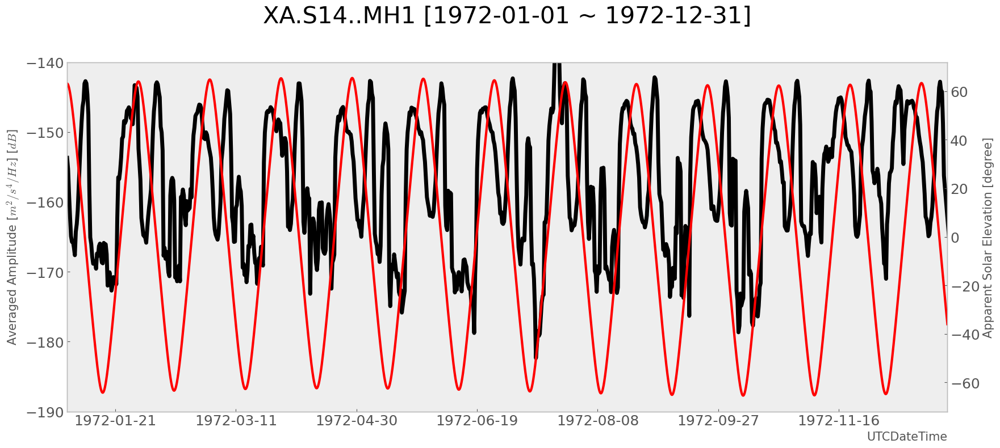

In [64]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 15, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:19: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values


9887.270392858843


c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]
posx and posy should be finite values


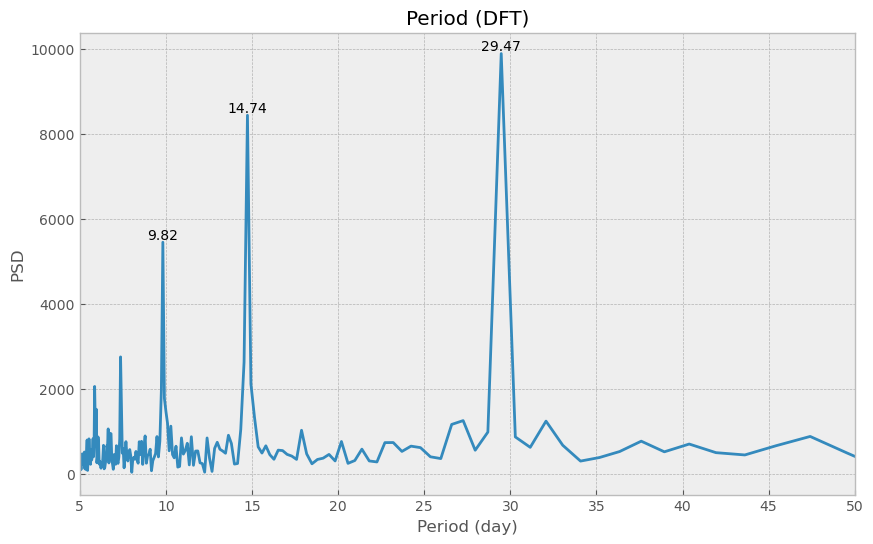

In [65]:
fft(avg_amplitude, time)

---
# 14호, 1972~1975, 시간창 48hour, overlap 80%, 저주파수(0.01~ 0.1), percentage 25% 

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


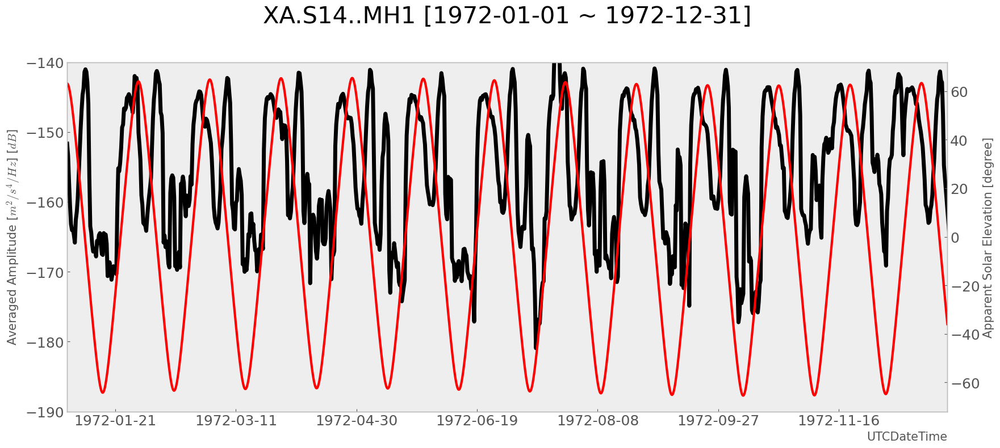

In [66]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 25, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:19: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)


10173.541215471798


posx and posy should be finite values
c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]
posx and posy should be finite values


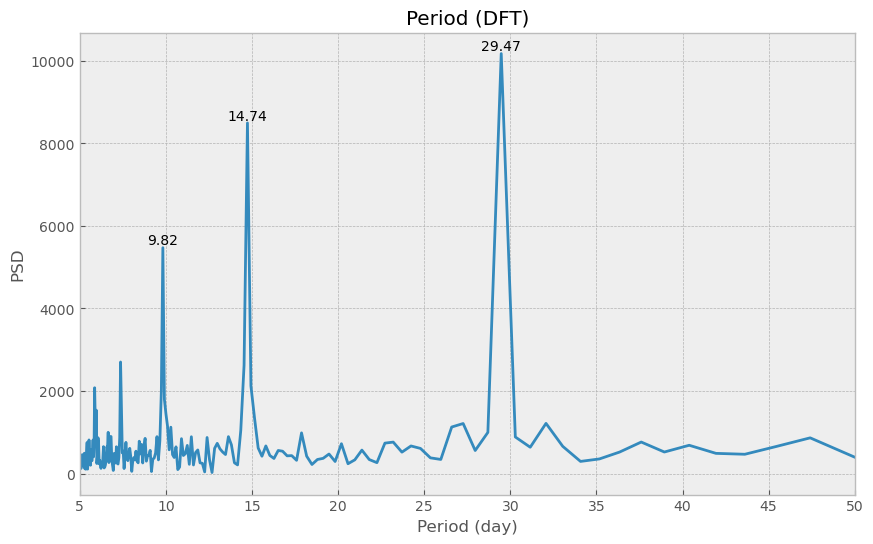

In [67]:
fft(avg_amplitude, time)

---
# 14호, 1972~1975, 시간창 72hour, overlap 50%, 저주파수(0.01~ 0.1), percentage 15% 

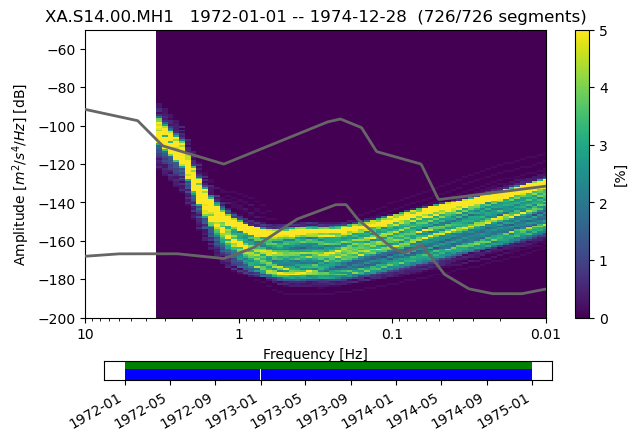

In [6]:
ppsd = PPSD.load_npz('./npz_14_MH1/197272hrmerged.npz')
ppsd.add_npz('./npz_14_MH1/197372hrmerged.npz')
ppsd.add_npz('./npz_14_MH1/197472hrmerged.npz')
ppsd.plot(xaxis_frequency=True, period_lim= (10, 0.01), max_percentage=5, grid=False);

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


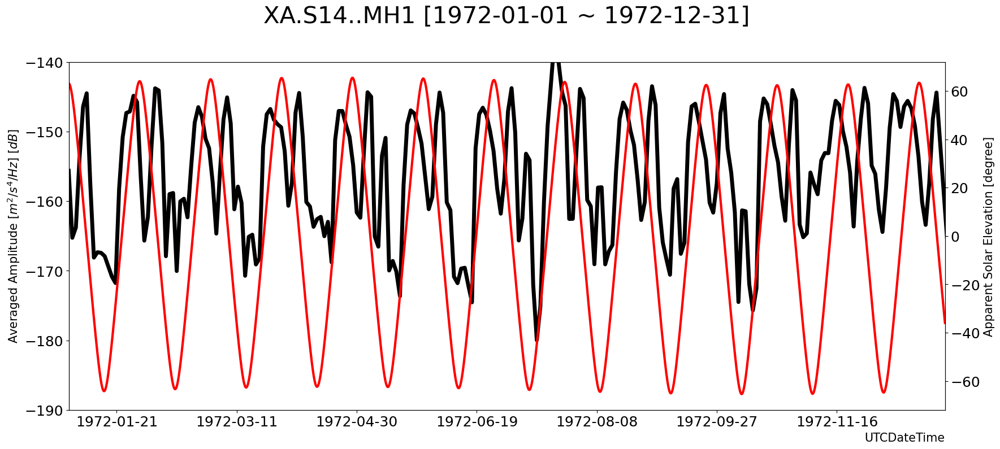

In [7]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 15, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

932.5

C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:19: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values
c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]


2475.019930552765


posx and posy should be finite values


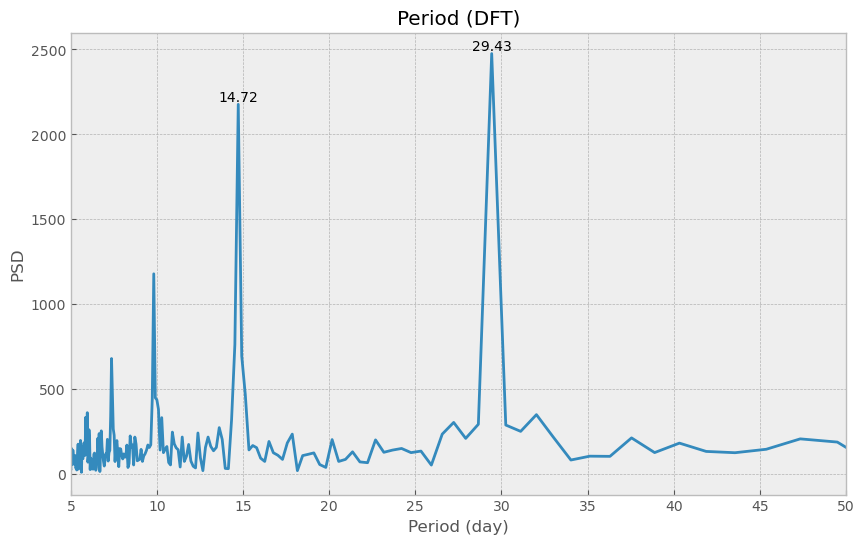

In [75]:
fft(avg_amplitude, time)

# 14호, 1972~1975, 시간창 72hour, overlap 50%, 저주파수(0.01~ 0.1), percentage 25% 

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


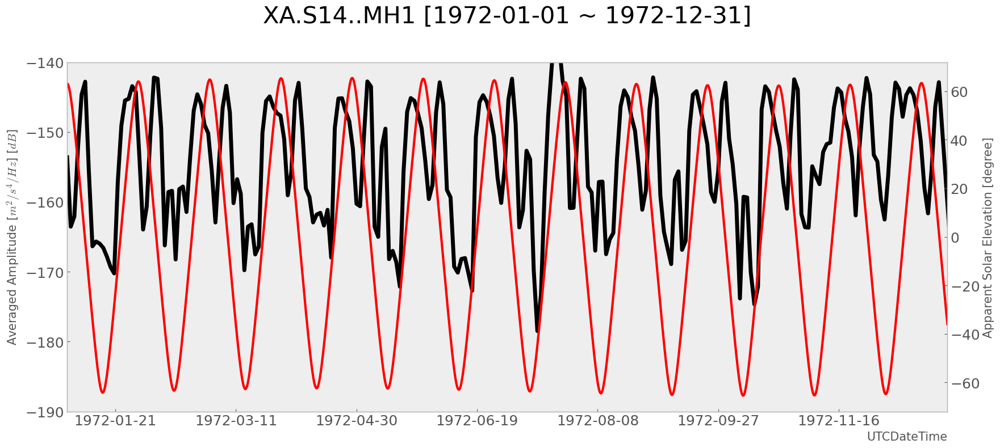

In [76]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 25, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:19: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values
c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]


2558.394020521735


posx and posy should be finite values


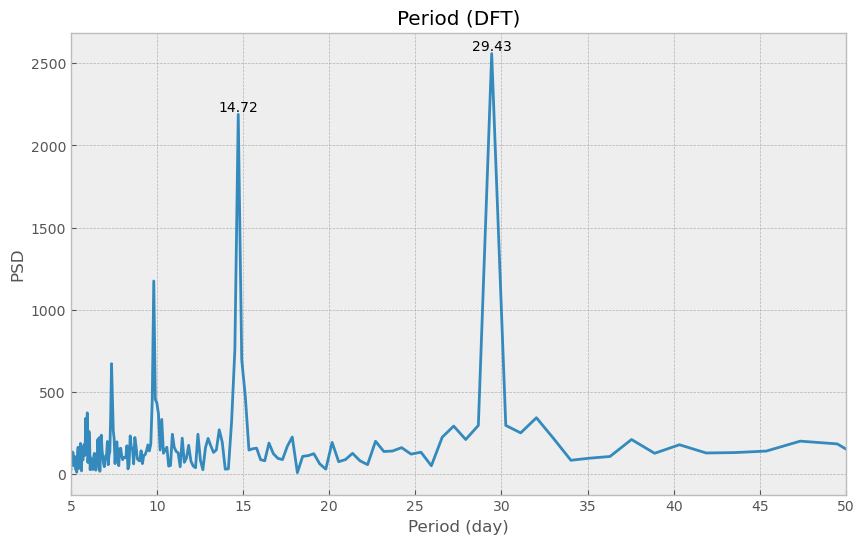

In [77]:
fft(avg_amplitude, time)

---
# 14호, 1972~1975, 시간창 72hour, overlap 75%, 저주파수(0.01~ 0.1), percentage 15% 

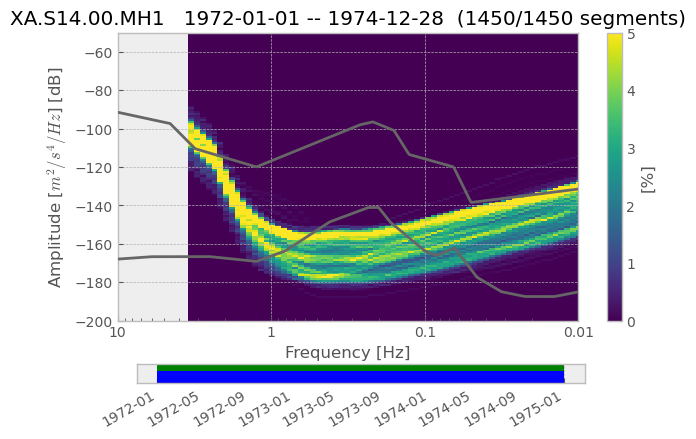

In [78]:
ppsd = PPSD.load_npz('./npz_14_MH1/197272hr75merged.npz')
ppsd.add_npz('./npz_14_MH1/197372hr75merged.npz')
ppsd.add_npz('./npz_14_MH1/197472hr75merged.npz')
ppsd.plot(xaxis_frequency=True, period_lim= (10, 0.01), max_percentage=5, grid=False);

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


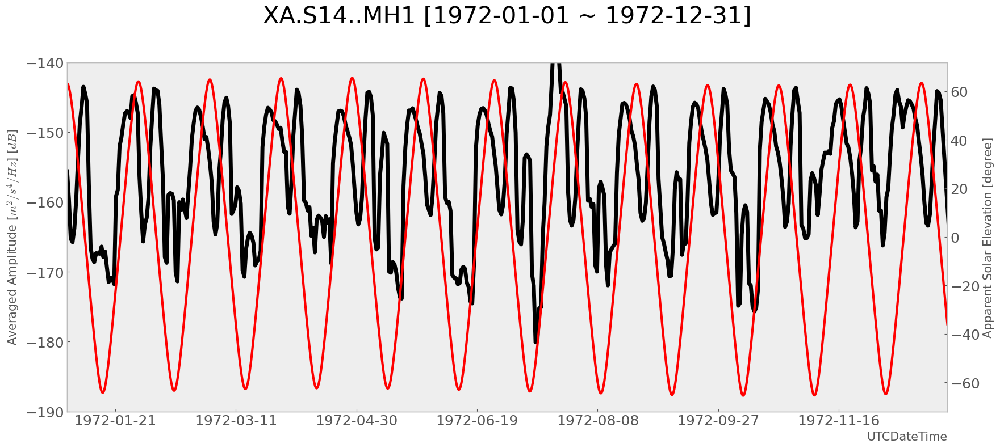

In [79]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 15, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:19: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values
c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]
posx and posy should be finite values


4963.380806160518


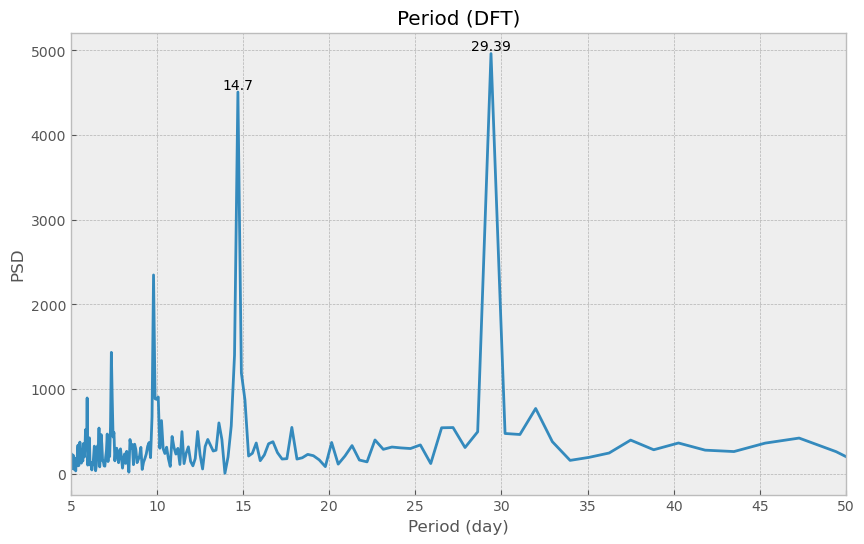

In [80]:
fft(avg_amplitude, time)

---
# 14호, 1972~1975, 시간창 72hour, overlap 75%, 저주파수(0.01~ 0.1), percentage 25% 

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


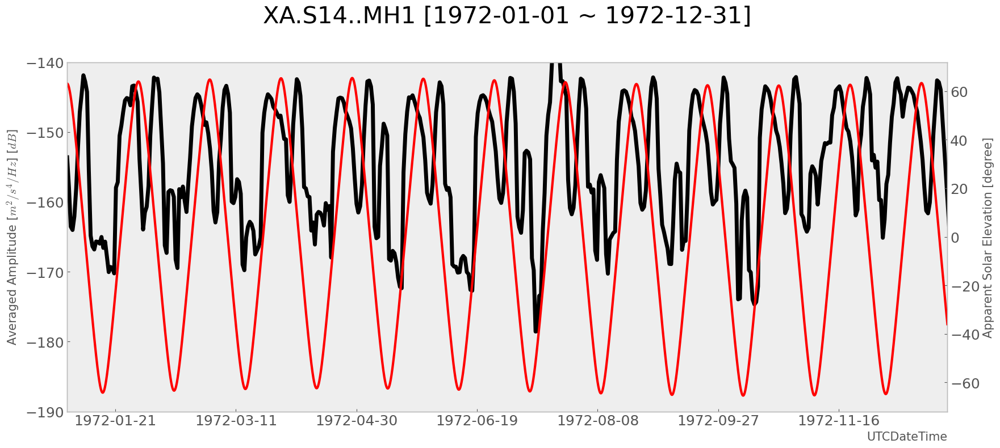

In [81]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 25, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:19: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values


5130.289076351465


c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]
posx and posy should be finite values


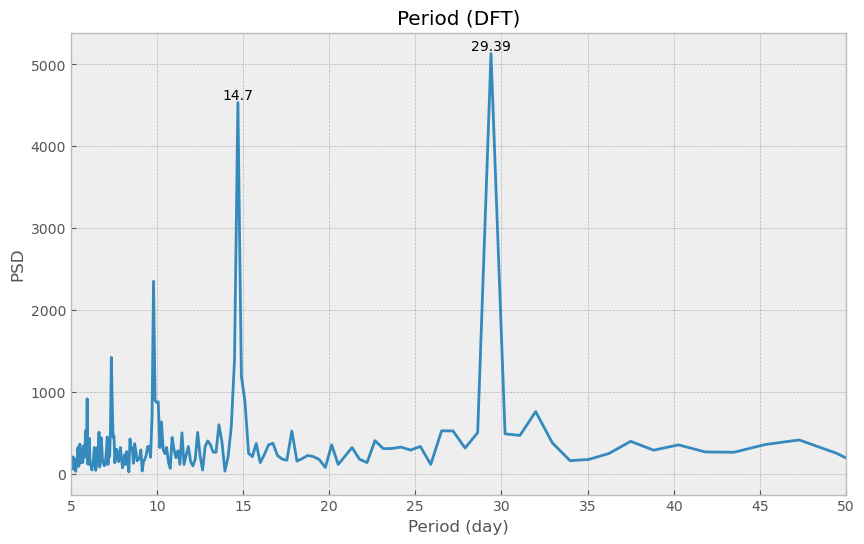

In [82]:
fft(avg_amplitude, time)

---
# 14호, 1972~1975, 시간창 72hour, overlap 80%, 저주파수(0.01~ 0.1), percentage 15% 

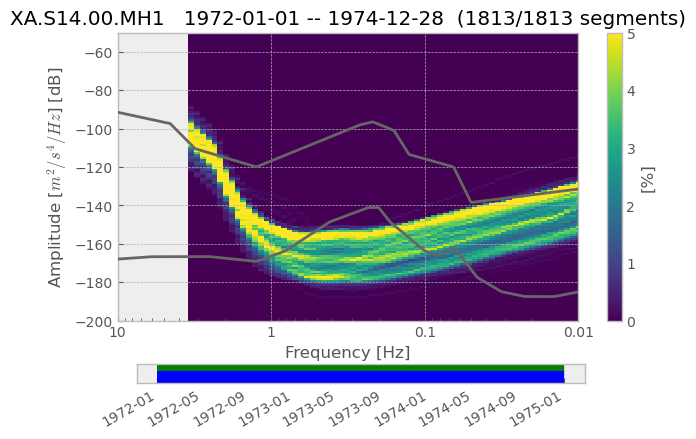

In [120]:
ppsd = PPSD.load_npz('./npz_14_MH1/197272hr80merged.npz')
ppsd.add_npz('./npz_14_MH1/197372hr80merged.npz')
ppsd.add_npz('./npz_14_MH1/197472hr80merged.npz')
ppsd.plot(xaxis_frequency=True, period_lim= (10, 0.01), max_percentage=5, grid=False);

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


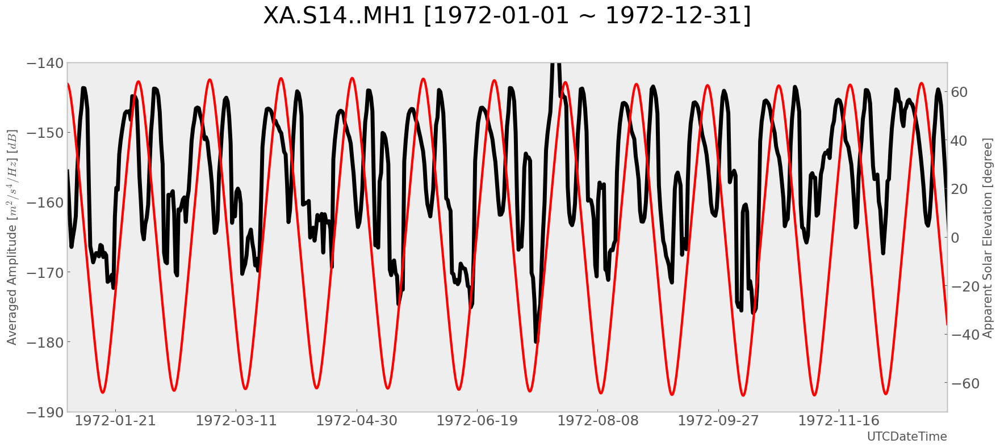

In [121]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 15, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:19: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)


6175.679452149367


posx and posy should be finite values
c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]
posx and posy should be finite values


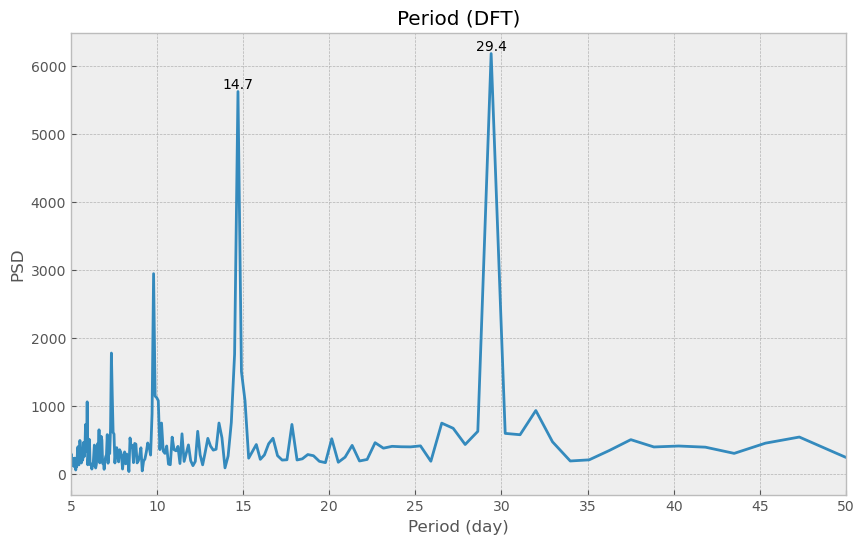

In [122]:
fft(avg_amplitude, time)

# 14호, 1972~1975, 시간창 72hour, overlap 80%, 저주파수(0.01~ 0.1), percentage 25% 

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


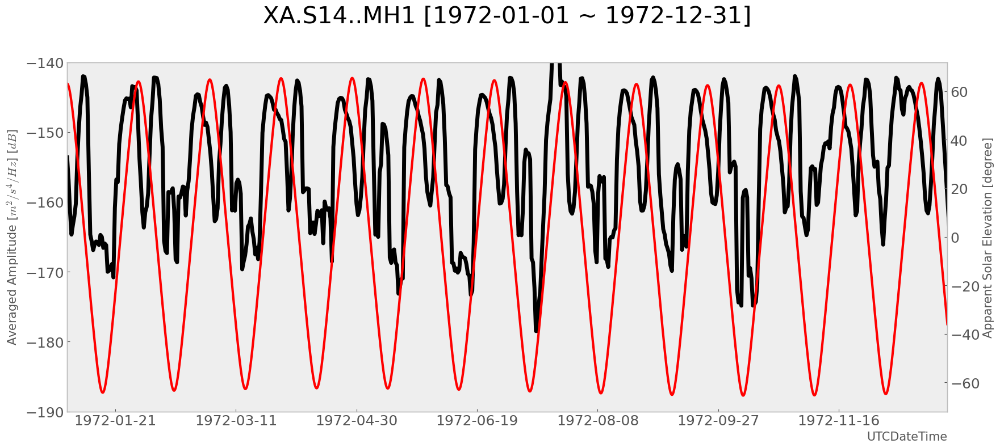

In [123]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 25, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:19: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values


6387.215509946355


c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]
posx and posy should be finite values


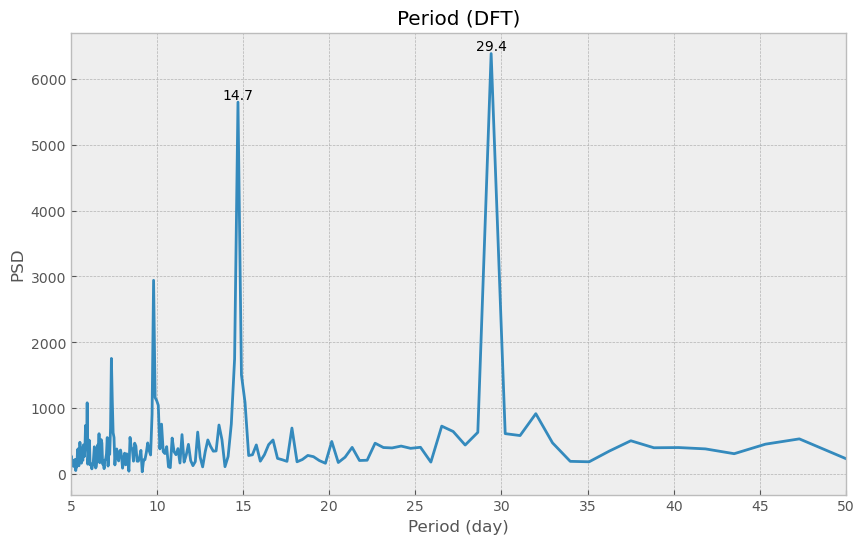

In [124]:
fft(avg_amplitude, time)

---
# 14호, 1972~1975, 시간창 96hour, overlap 50%, 저주파수(0.01~ 0.1), percentage 15% 

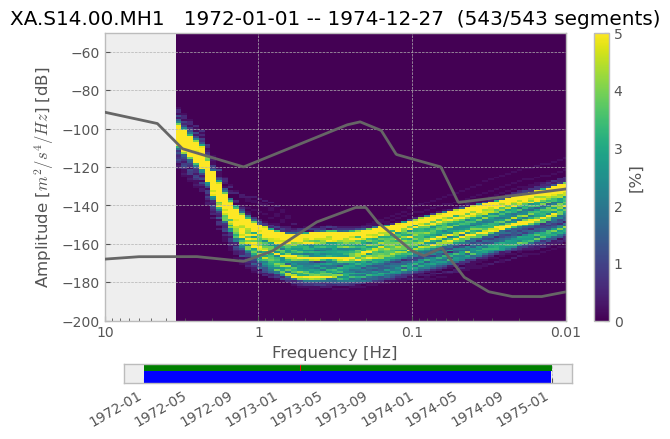

In [125]:
ppsd = PPSD.load_npz('./npz_14_MH1/197296hrmerged.npz')
ppsd.add_npz('./npz_14_MH1/197396hrmerged.npz')
ppsd.add_npz('./npz_14_MH1/197496hrmerged.npz')
ppsd.plot(xaxis_frequency=True, period_lim= (10, 0.01), max_percentage=5, grid=False);

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


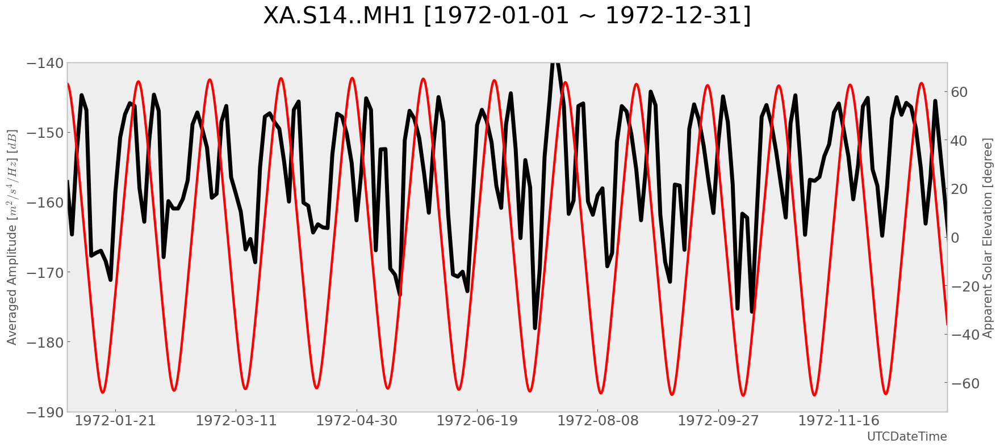

In [126]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 15, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:19: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values
c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]


1743.2251269027117


posx and posy should be finite values


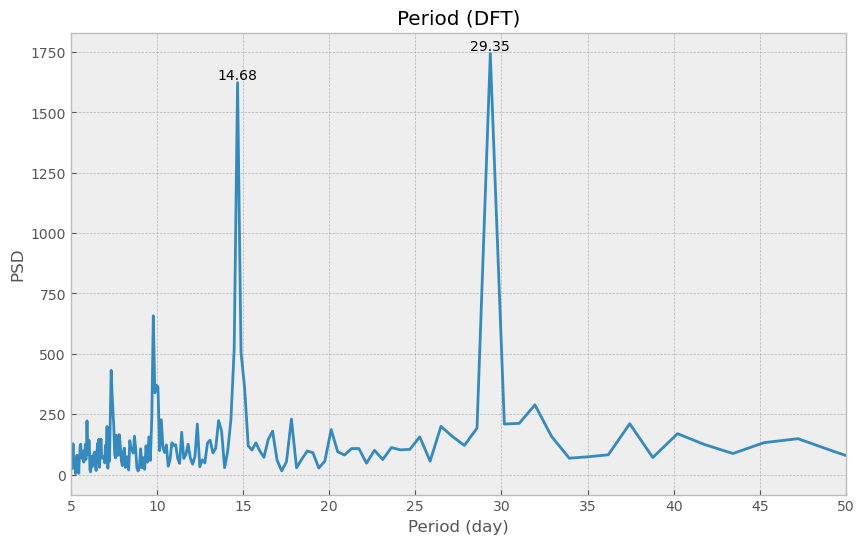

In [127]:
fft(avg_amplitude, time)

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


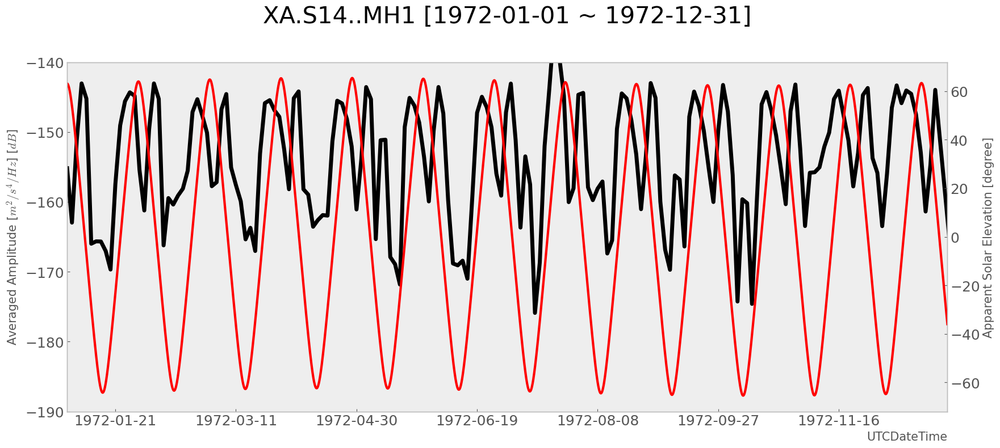

In [128]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 25, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:19: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values
c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]
posx and posy should be finite values


1810.8903228532351


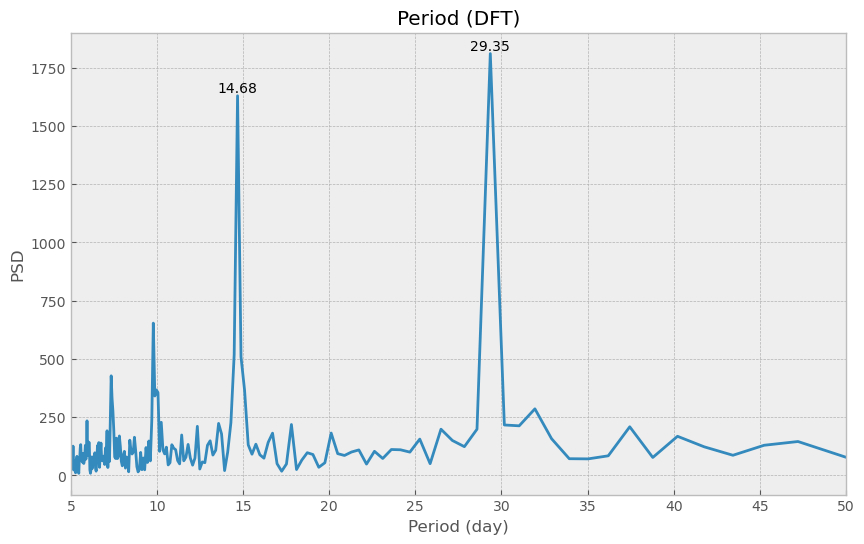

In [129]:
fft(avg_amplitude, time)

---
# 14호, 1972~1975, 시간창 96hour, overlap 75%, 저주파수(0.01~ 0.1), percentage 15%

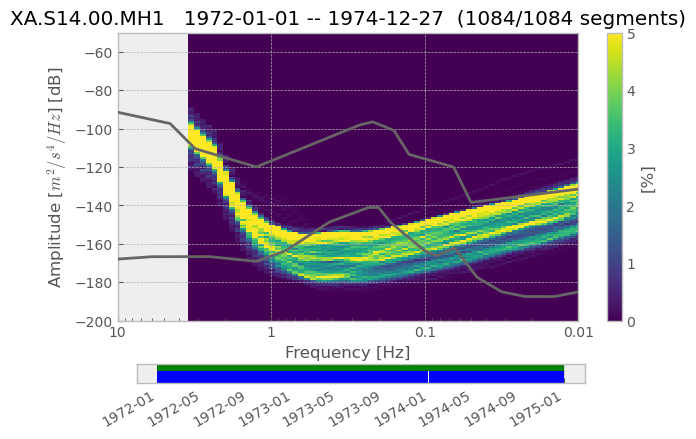

In [130]:
ppsd = PPSD.load_npz('./npz_14_MH1/197296hr75merged.npz')
ppsd.add_npz('./npz_14_MH1/197396hr75merged.npz')
ppsd.add_npz('./npz_14_MH1/197496hr75merged.npz')
ppsd.plot(xaxis_frequency=True, period_lim= (10, 0.01), max_percentage=5, grid=False);

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


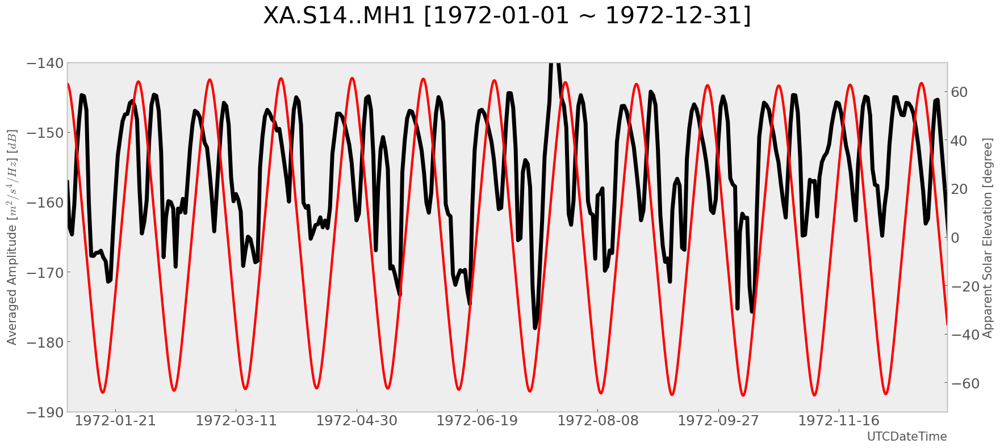

In [131]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 15, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:19: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values


c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]


3509.5301064084997


posx and posy should be finite values


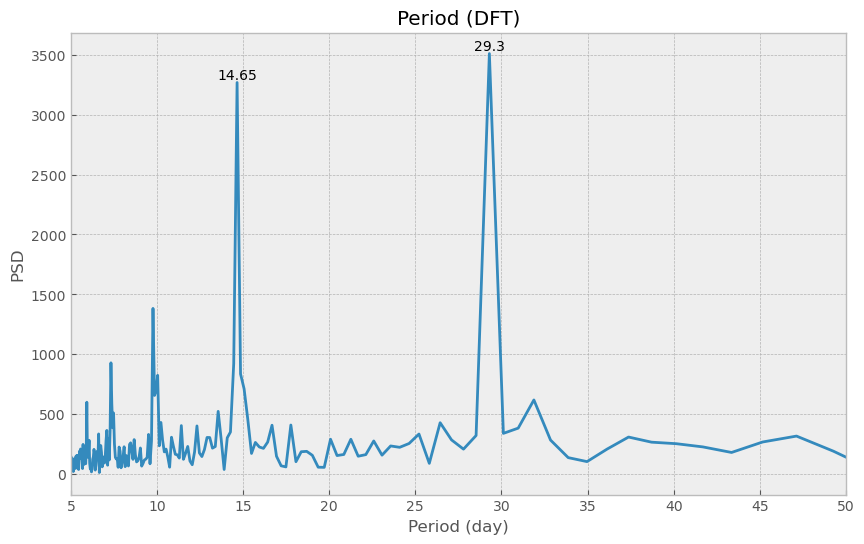

In [132]:
fft(avg_amplitude, time)

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


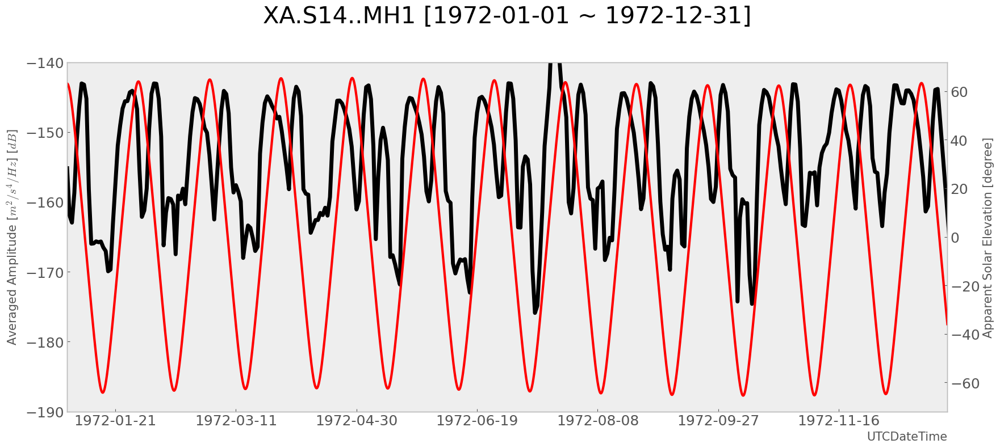

In [133]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 25, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:19: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values
c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]
posx and posy should be finite values


3641.3160717285273


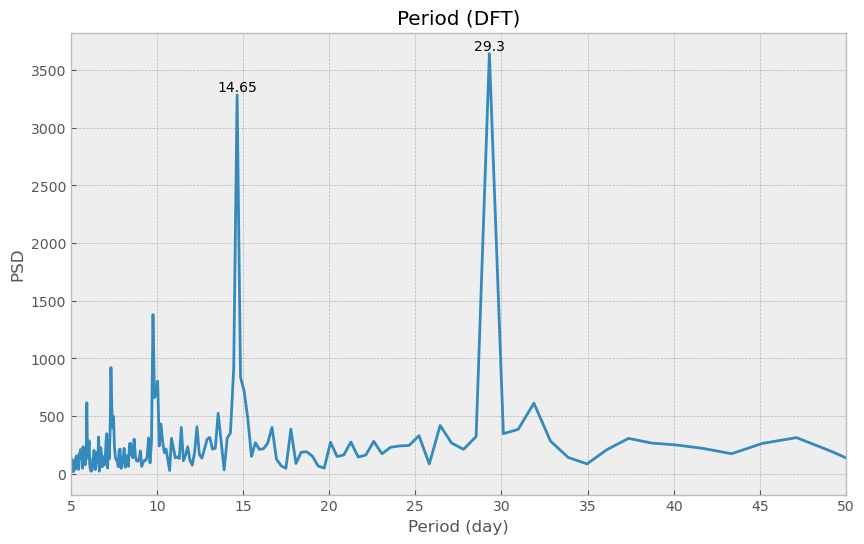

In [134]:
fft(avg_amplitude, time)

---
# 14호, 1972~1975, 시간창 96hour, overlap 80%, 저주파수(0.01~ 0.1), percentage 15% 

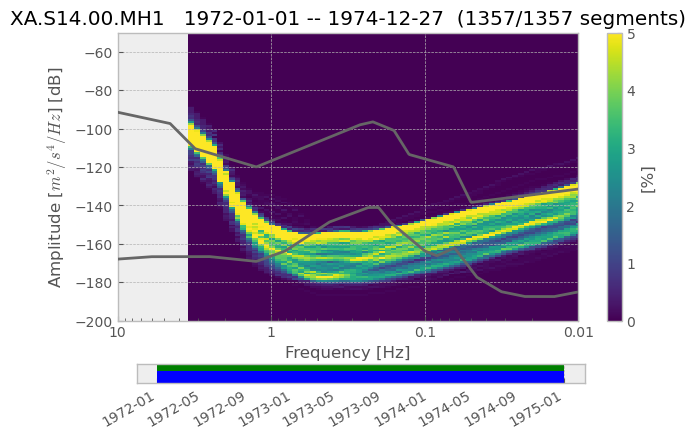

In [135]:
ppsd = PPSD.load_npz('./npz_14_MH1/197296hr80merged.npz')
ppsd.add_npz('./npz_14_MH1/197396hr80merged.npz')
ppsd.add_npz('./npz_14_MH1/197496hr80merged.npz')
ppsd.plot(xaxis_frequency=True, period_lim= (10, 0.01), max_percentage=5, grid=False);

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


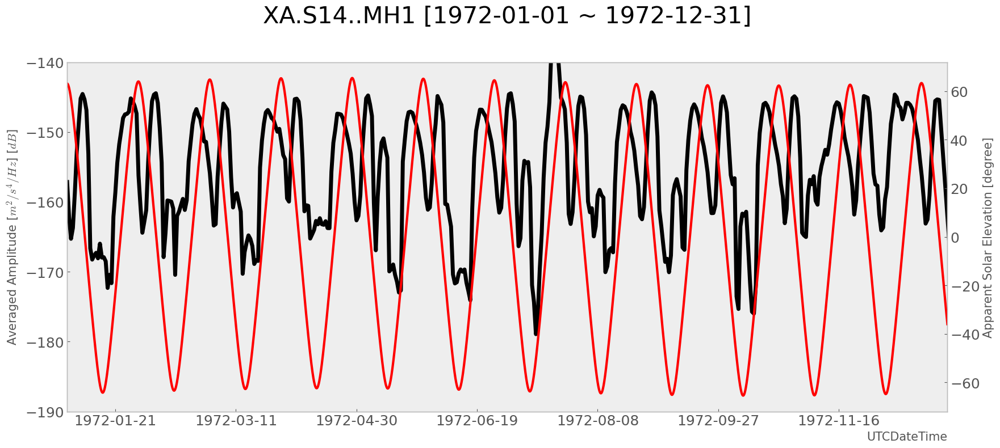

In [136]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 15, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:19: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values
c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]
posx and posy should be finite values


4396.7533205933005


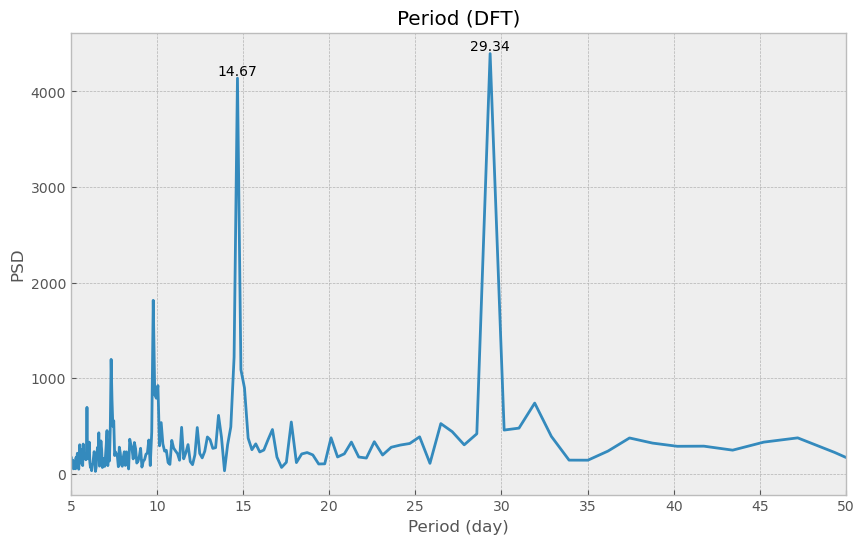

In [137]:
fft(avg_amplitude, time)

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


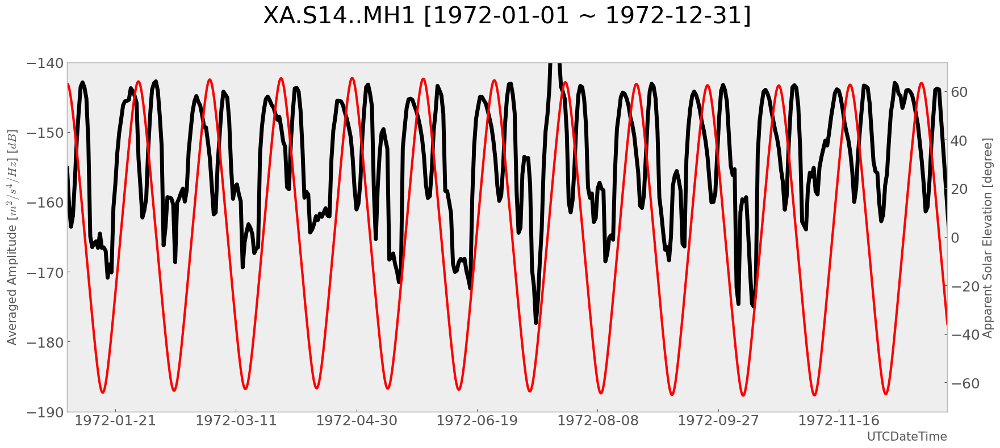

In [138]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 25, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:19: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values
c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]


4560.997531641122


posx and posy should be finite values


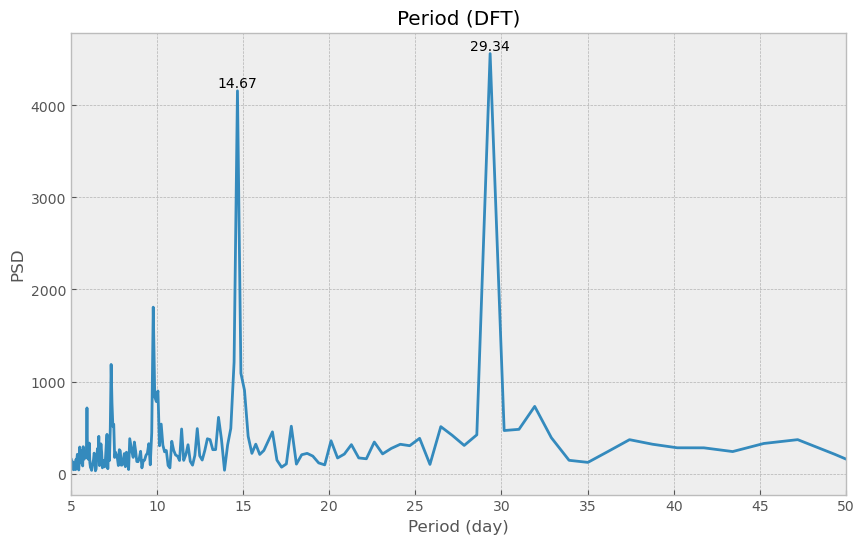

In [139]:
fft(avg_amplitude, time)

---
# 14호, 1972~1975, 시간창 120hour, overlap 50%, 저주파수(0.01~ 0.1), percentage 15% 

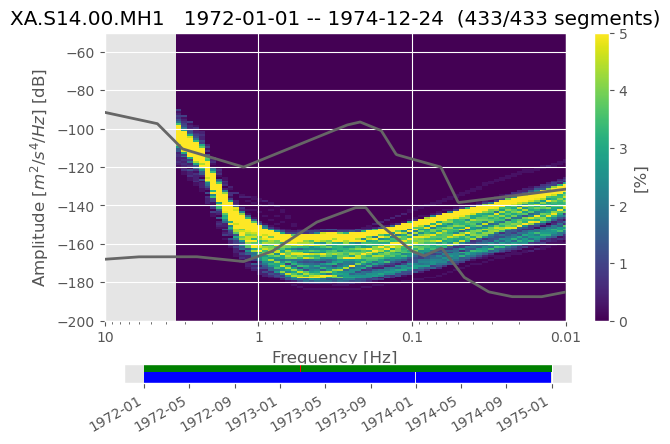

In [20]:
ppsd = PPSD.load_npz('./npz_14_MH1/1972120hrmerged.npz')
ppsd.add_npz('./npz_14_MH1/1973120hrmerged.npz')
ppsd.add_npz('./npz_14_MH1/1974120hrmerged.npz')
ppsd.plot(xaxis_frequency=True, period_lim= (10, 0.01), max_percentage=5, grid=False);

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


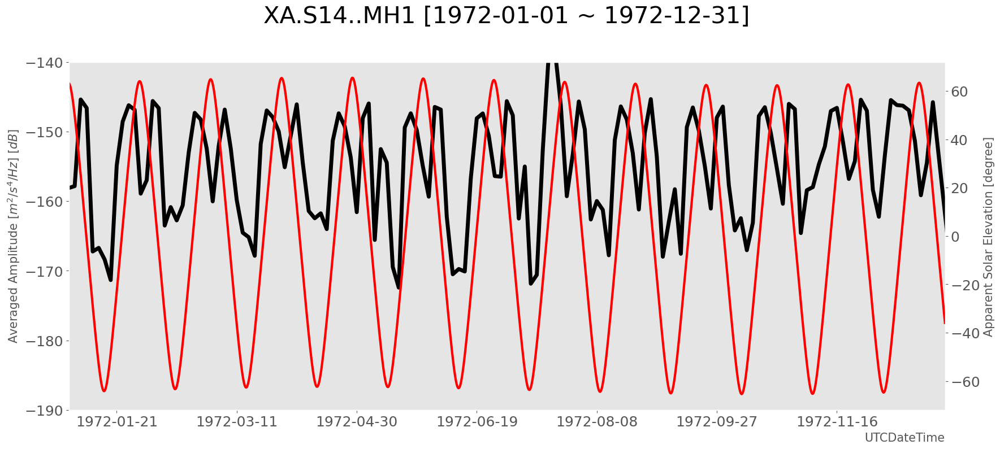

In [24]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 15, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:19: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values


1363.0571619595519


c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]
posx and posy should be finite values


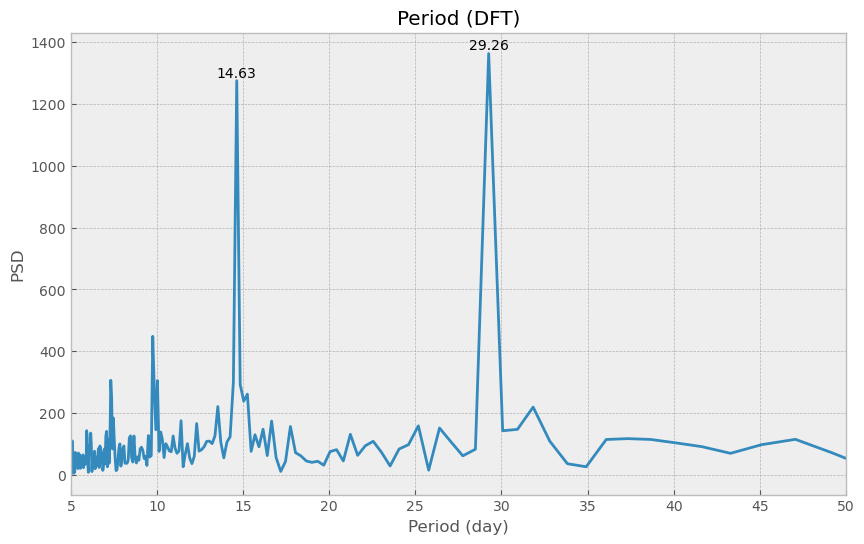

In [142]:
fft(avg_amplitude, time)

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


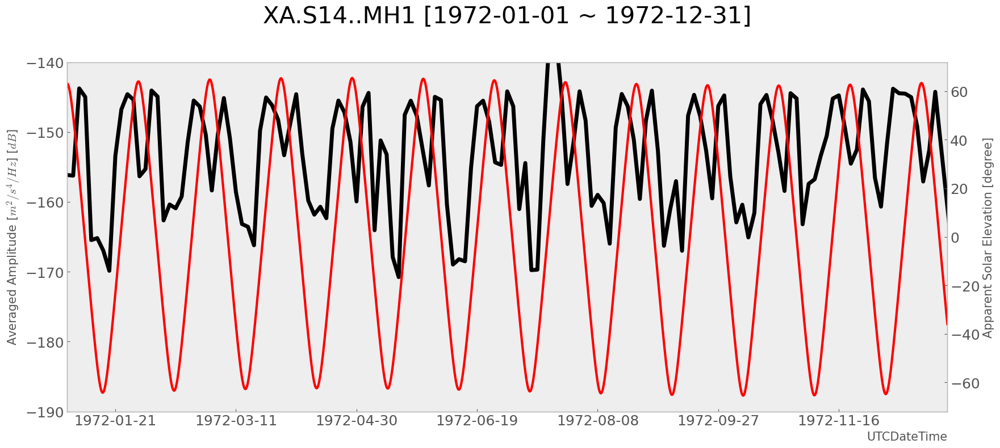

In [143]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 25, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:19: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values
c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]


1417.139974738088


posx and posy should be finite values


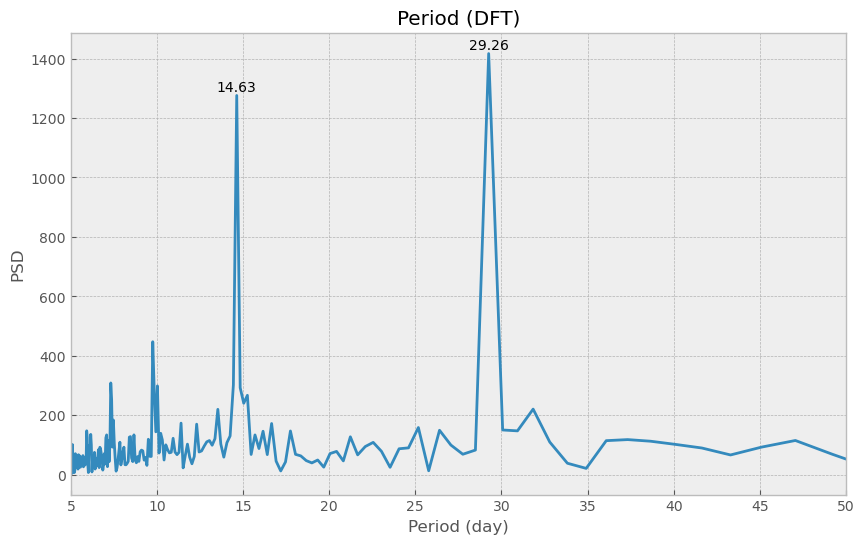

In [144]:
fft(avg_amplitude, time)

---
# 14호, 1972~1975, 시간창 120hour, overlap 75%, 저주파수(0.01~ 0.1), percentage 15% 

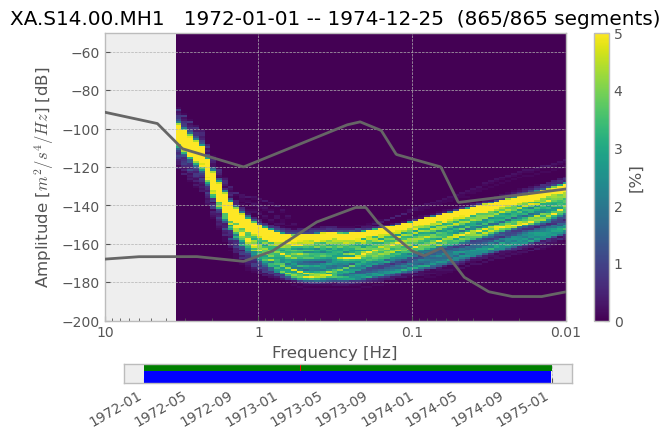

In [145]:
ppsd = PPSD.load_npz('./npz_14_MH1/1972120hr75merged.npz')
ppsd.add_npz('./npz_14_MH1/1973120hr75merged.npz')
ppsd.add_npz('./npz_14_MH1/1974120hr75merged.npz')
ppsd.plot(xaxis_frequency=True, period_lim= (10, 0.01), max_percentage=5, grid=False);

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


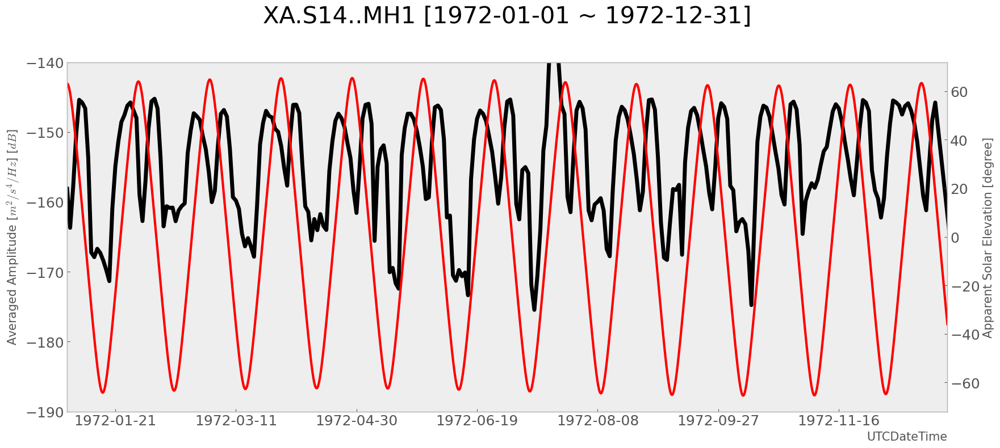

In [146]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 15, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:19: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values
c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]


2695.573382468397


posx and posy should be finite values


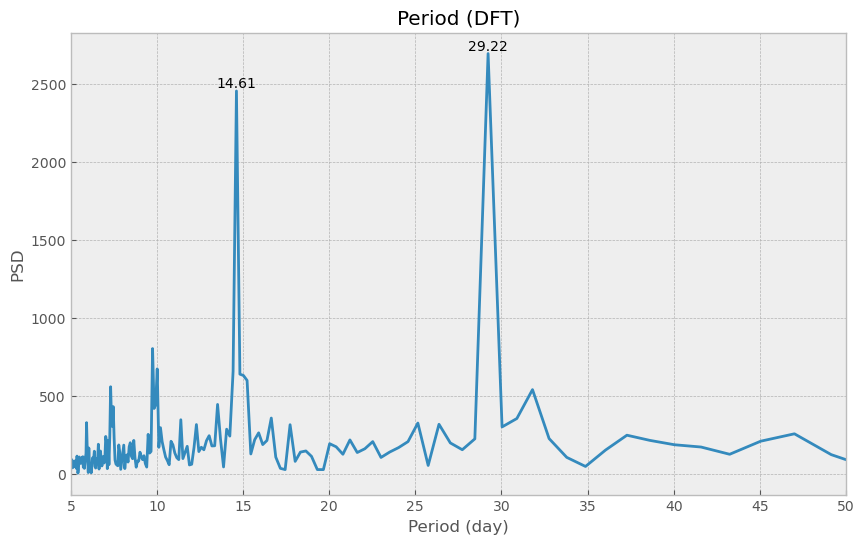

In [147]:
fft(avg_amplitude, time)

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


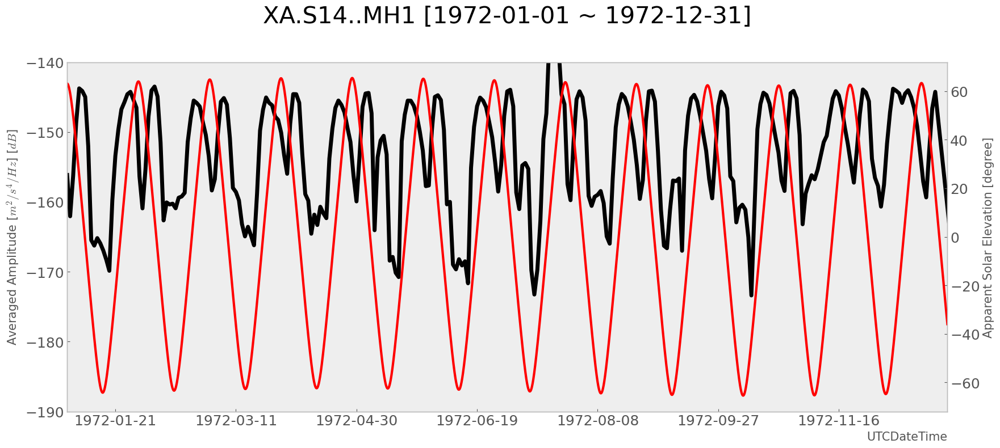

In [148]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 25, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:19: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values
c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]


2802.189274017924


posx and posy should be finite values


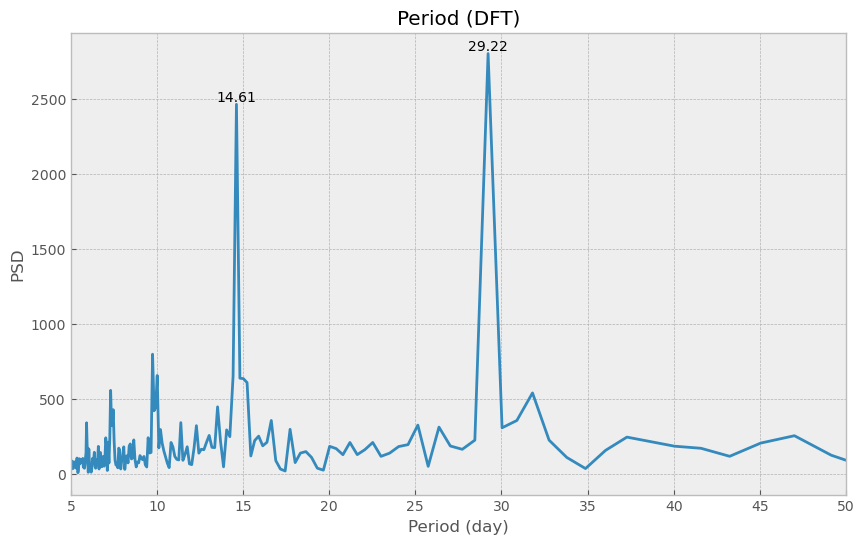

In [149]:
fft(avg_amplitude, time)

---
# 14호, 1972~1975, 시간창 120hour, overlap 80%, 저주파수(0.01~ 0.1), percentage 15% 

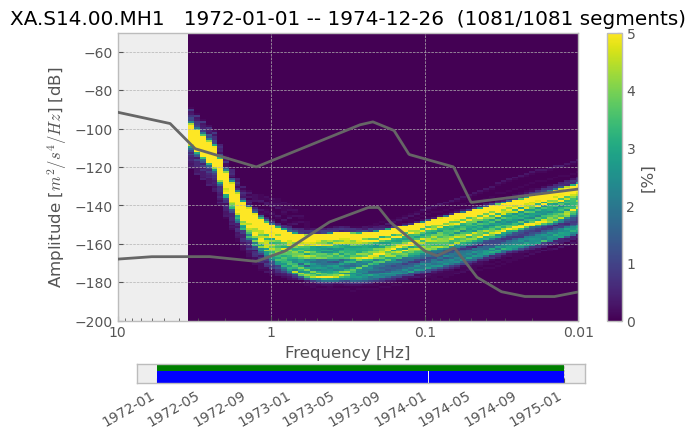

In [150]:
ppsd = PPSD.load_npz('./npz_14_MH1/1972120hr80merged.npz')
ppsd.add_npz('./npz_14_MH1/1973120hr80merged.npz')
ppsd.add_npz('./npz_14_MH1/1974120hr80merged.npz')
ppsd.plot(xaxis_frequency=True, period_lim= (10, 0.01), max_percentage=5, grid=False);

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


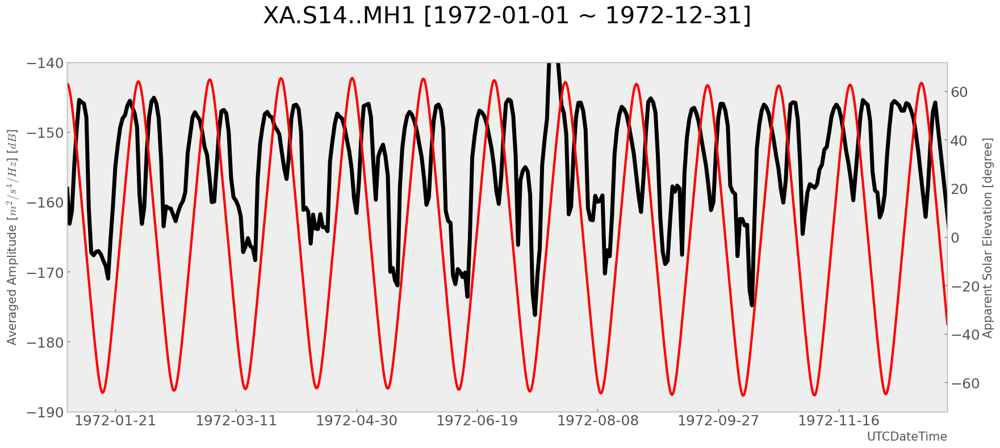

In [151]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 15, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:19: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values
c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]
posx and posy should be finite values


3342.3674572103832


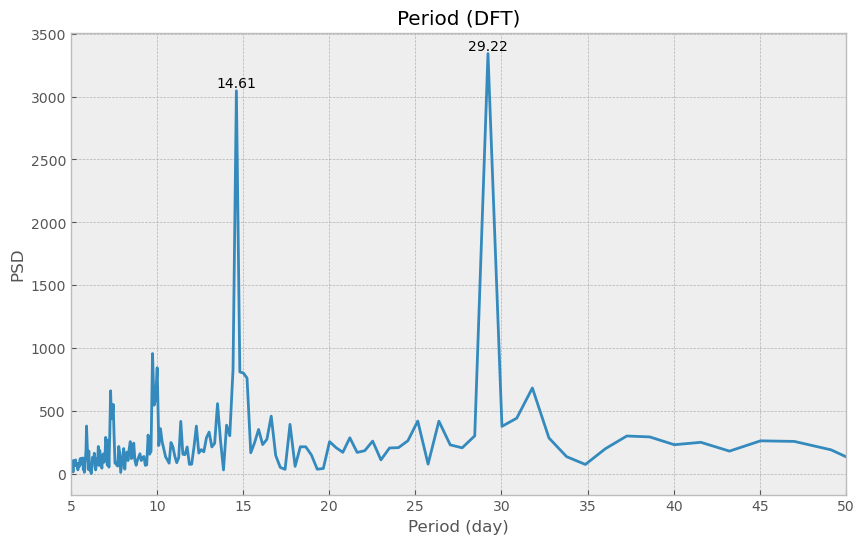

In [152]:
fft(avg_amplitude, time)

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


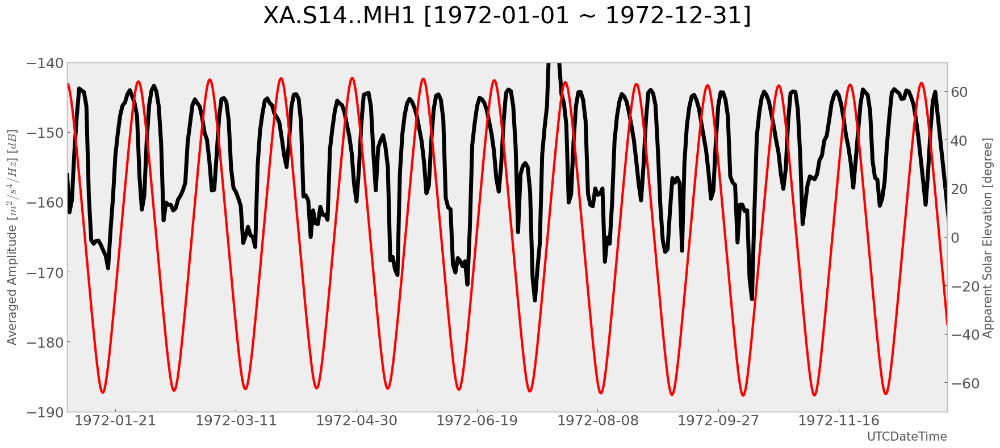

In [153]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 25, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:19: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values
c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]
posx and posy should be finite values


3478.2886002170794


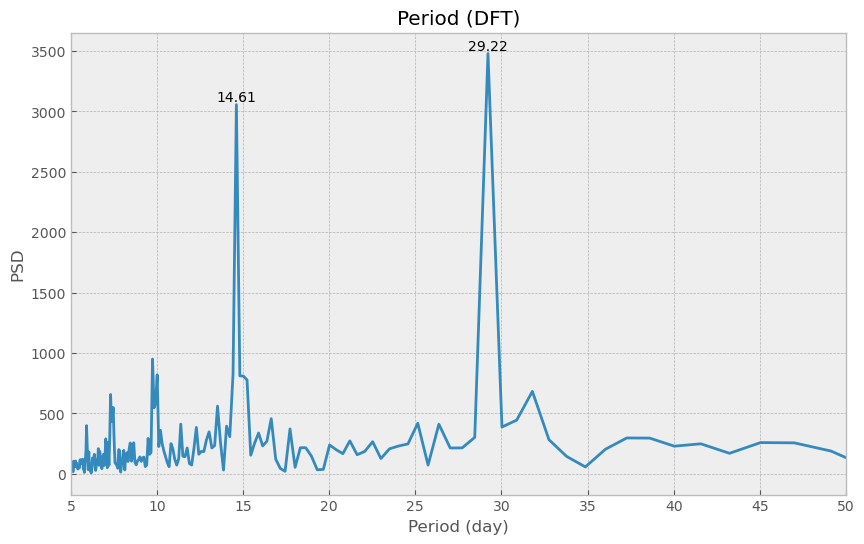

In [154]:
fft(avg_amplitude, time)

---
# 14호, 1972~1975, 시간창 144hour, overlap 50%, 저주파수(0.01~ 0.1), percentage 15% 

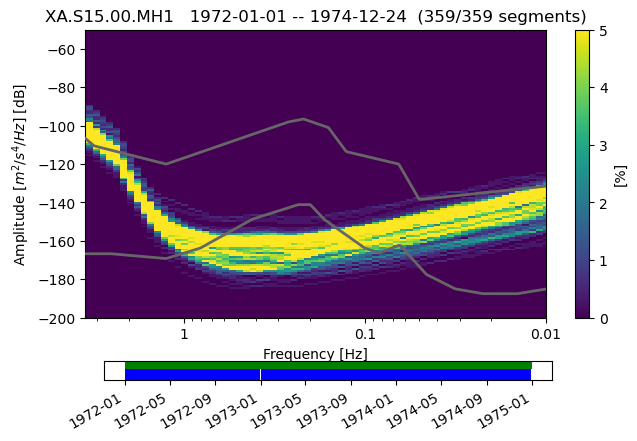

In [64]:
ppsd = PPSD.load_npz('./npz_15_MH1/1972144hrmerged.npz')
ppsd.add_npz('./npz_15_MH1/1973144hrmerged.npz')
ppsd.add_npz('./npz_15_MH1/1974144hrmerged.npz')
ppsd.plot(xaxis_frequency=True, period_lim= (3.5, 0.01), max_percentage=5, grid=False);

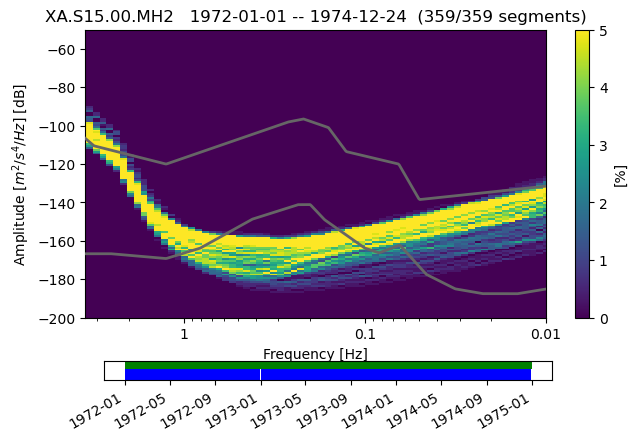

In [47]:
ppsd2 = PPSD.load_npz('./npz_15_MH2/1972144hrmerged.npz')
ppsd2.add_npz('./npz_15_MH2/1973144hrmerged.npz')
ppsd2.add_npz('./npz_15_MH2/1974144hrmerged.npz')
ppsd2.plot(xaxis_frequency=True, period_lim= (3.5, 0.01), max_percentage=5, grid=False);

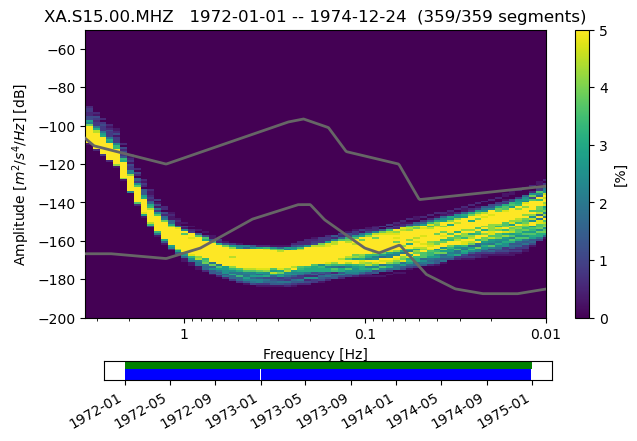

In [31]:
ppsd3 = PPSD.load_npz('./npz_15_MHZ/1972144hrmerged.npz')
ppsd3.add_npz('./npz_15_MHZ/1973144hrmerged.npz')
ppsd3.add_npz('./npz_15_MHZ/1974144hrmerged.npz')


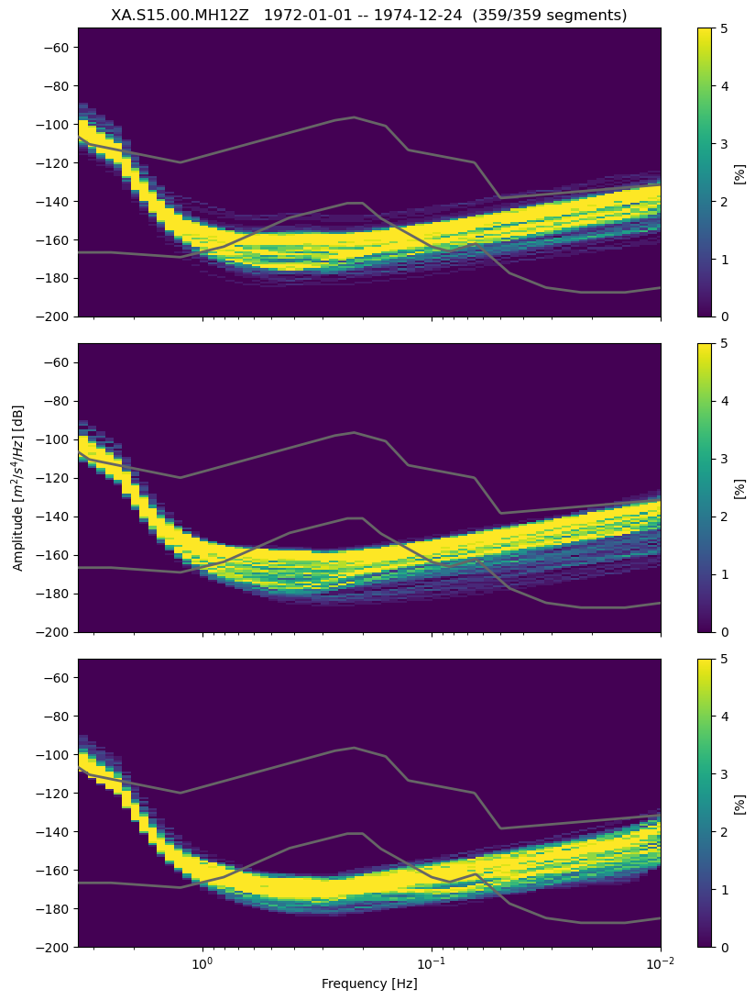

In [50]:
# obspy의 document와 포럼을 참고하여 3성분의 PSD 객체를 X축을 공유하는 subplot으로 구현하였습니다. 
# NOISE_MODEL_FILE은 obspy 깃허브에서 찾을 수 있습니다. 

# https://discourse.obspy.org/t/plotting-ppsd-of-all-station-components-as-subplots-vertically-w-new-high-low-noise-model/1100/8
# https://github.com/obspy/obspy/blob/master/obspy/signal/data/noise_models.npz

from obspy.core.util import AttribDict

NOISE_MODEL_FILE = "../noise_models.npz"

def get_nhnm():
    """
    Returns periods and psd values for the New High Noise Model.
    For information on New High/Low Noise Model see [Peterson1993]_.
    """
    data = np.load(NOISE_MODEL_FILE)
    periods = data['model_periods']
    nlnm = data['high_noise']
    return (periods, nlnm)


def get_nlnm():
    """
    Returns periods and psd values for the New Low Noise Model.
    For information on New High/Low Noise Model see [Peterson1993]_.
    """
    data = np.load(NOISE_MODEL_FILE)
    periods = data['model_periods']
    nlnm = data['low_noise']
    return (periods, nlnm)


# Start making figure
fig, axs = plt.subplots(3, 1, figsize=(9, 11))
# Initialize attribute table defaults
fig.c = AttribDict()
label = "[%]"
max_percentage = 5  # max percent of colorbar
fig.c.cumulative = False
# fig.c.cmap = obspy_sequential
fig.c.label = label
fig.c.max_percentage = max_percentage
color_limits = (0, max_percentage)
fig.c.color_limits = color_limits
fig.c.grid = True
fig.c.xaxis_frequency = True
period_lim = (3.5, 0.01)

# Iterate through different ppsd's
for ii in range(3):
    axs[ii].semilogx()

    if ii == 2:
        axs[ii].set_xlabel('Frequency [Hz]')
    
    axs[ii].set_xlim(period_lim)
    
    ## Title
    if ii == 0:
        title = "%s   %s -- %s  (%i/%i segments)"
        title = title % (str(ppsd.id)[:-1] + '12Z',
                         UTCDateTime(ns=ppsd._times_processed[0]).date,
                         UTCDateTime(ns=ppsd._times_processed[-1]).date,
                         ppsd.current_histogram_count,
                         len(ppsd._times_processed))
        axs[ii].set_title(title)
        axs[ii].set_xticklabels([])

    # Y limits
    axs[ii].set_ylim(ppsd.db_bin_edges[0], ppsd.db_bin_edges[-1])


    if ii == 1:
        axs[ii].set_ylabel('Amplitude [$m^2/s^4/Hz$] [dB]')
        axs[ii].set_xticklabels([])
    

    if ii == 0 :
        # format data
        data = (
            ppsd.current_histogram * 100.0 /
            (ppsd.current_histogram_count or 1))
    
        xedges = 1.0 / ppsd.period_xedges
        fig.c.meshgrid = np.meshgrid(xedges, ppsd.db_bin_edges)
        c = axs[ii].pcolormesh(
            fig.c.meshgrid[0], fig.c.meshgrid[1], data.T,
            zorder=-1, vmax=max_percentage)
        fig.c.quadmesh = c


        models = (get_nhnm(), get_nlnm())

        for periods, noise_model in models:
            xdata = 1.0 / periods

            axs[ii].plot(xdata, noise_model, '0.4', linewidth=2, zorder=10)

    if ii == 1 :

            # format data
        data = (
            ppsd2.current_histogram * 100.0 /
            (ppsd2.current_histogram_count or 1))
    

        xedges = 1.0 / ppsd2.period_xedges
        fig.c.meshgrid = np.meshgrid(xedges, ppsd2.db_bin_edges)
        c = axs[ii].pcolormesh(
            fig.c.meshgrid[0], fig.c.meshgrid[1], data.T,
            zorder=-1, vmax=max_percentage)
        fig.c.quadmesh = c
    
    
        models = (get_nhnm(), get_nlnm())
            
        for periods, noise_model in models:
            xdata = 1.0 / periods
         
            axs[ii].plot(xdata, noise_model, '0.4', linewidth=2, zorder=10)


    if ii == 2 :

        # format data
        data = (
            ppsd3.current_histogram * 100.0 /
            (ppsd3.current_histogram_count or 1))
    

        xedges = 1.0 / ppsd3.period_xedges
        fig.c.meshgrid = np.meshgrid(xedges, ppsd3.db_bin_edges)
        c = axs[ii].pcolormesh(
            fig.c.meshgrid[0], fig.c.meshgrid[1], data.T,
            zorder=-1, vmax=max_percentage)
        fig.c.quadmesh = c
    
    
        models = (get_nhnm(), get_nlnm())
            
        for periods, noise_model in models:
            xdata = 1.0 / periods
         
            axs[ii].plot(xdata, noise_model, '0.4', linewidth=2, zorder=10)

    # Grid
    #color = {}
    #axs[ii].grid(b=True, which="major", **color)
    #axs[ii].grid(b=True, which="minor", **color)
    
    
    #Colorbar
    cb = plt.colorbar(c, ax=axs[ii])
    # cb.set_clim(*fig.c.color_limits)
    cb.set_label(fig.c.label)

    fig.c.colorbar = cb
    fig.tight_layout()

c:\Users\neimb\anaconda3\Lib\site-packages\obspy\imaging\util.py:266: UserWarning: AutoDateLocator was unable to pick an appropriate interval for this date range. It may be necessary to add an interval value to the AutoDateLocator's intervald dictionary. Defaulting to 6.
  plt.setp(ax.get_xticklabels(), fontsize='small')
C:\Users\neimb\AppData\Local\Temp\ipykernel_27876\2589653541.py:59: UserWarning: AutoDateLocator was unable to pick an appropriate interval for this date range. It may be necessary to add an interval value to the AutoDateLocator's intervald dictionary. Defaulting to 6.
  fig.tight_layout()
C:\Users\neimb\AppData\Local\Temp\ipykernel_27876\2589653541.py:64: UserWarning: AutoDateLocator was unable to pick an appropriate interval for this date range. It may be necessary to add an interval value to the AutoDateLocator's intervald dictionary. Defaulting to 6.
  plt.draw()
c:\Users\neimb\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: AutoDateLocator

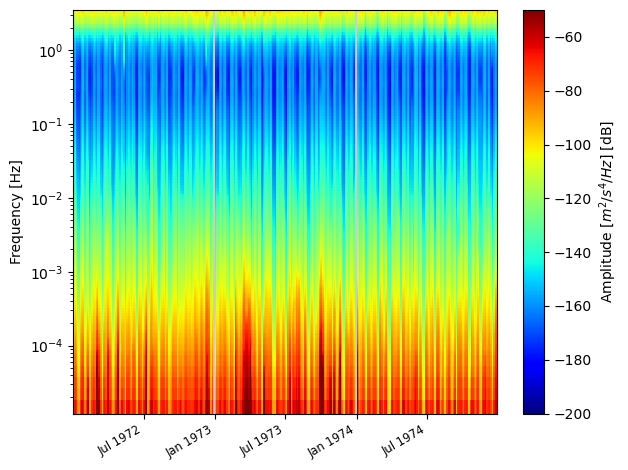

In [56]:
plot_spectrogram2(ppsd, grid=False, cmap='jet', clim = [-200, -50]);

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


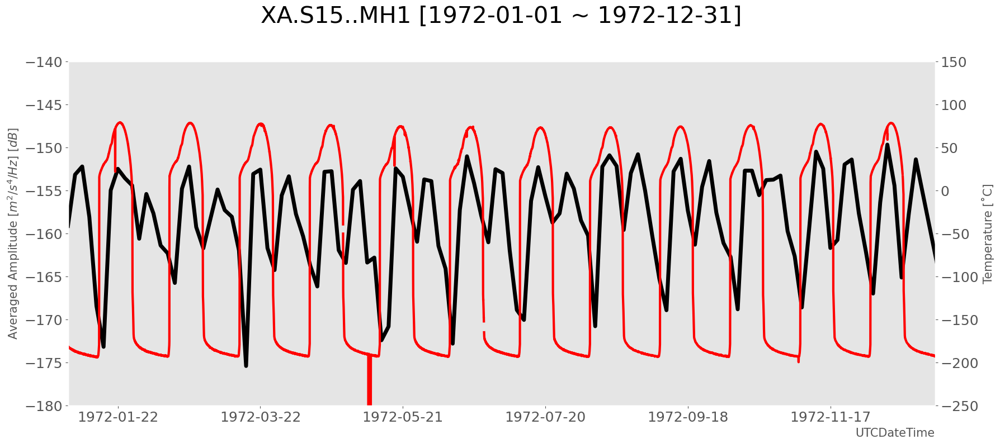

In [103]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 15, ylim_min = -180, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


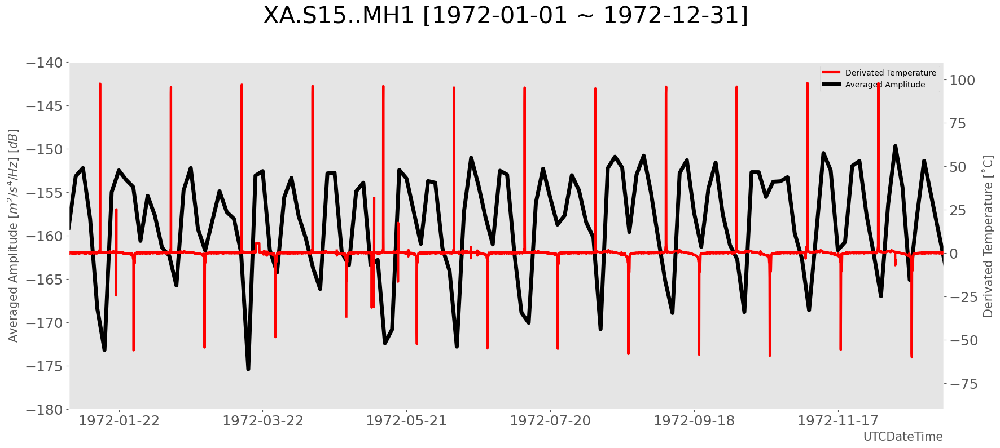

In [110]:
avg_amplitude, time = draw_periodicity3(0.01, 0.1, 15, ylim_min = -180, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


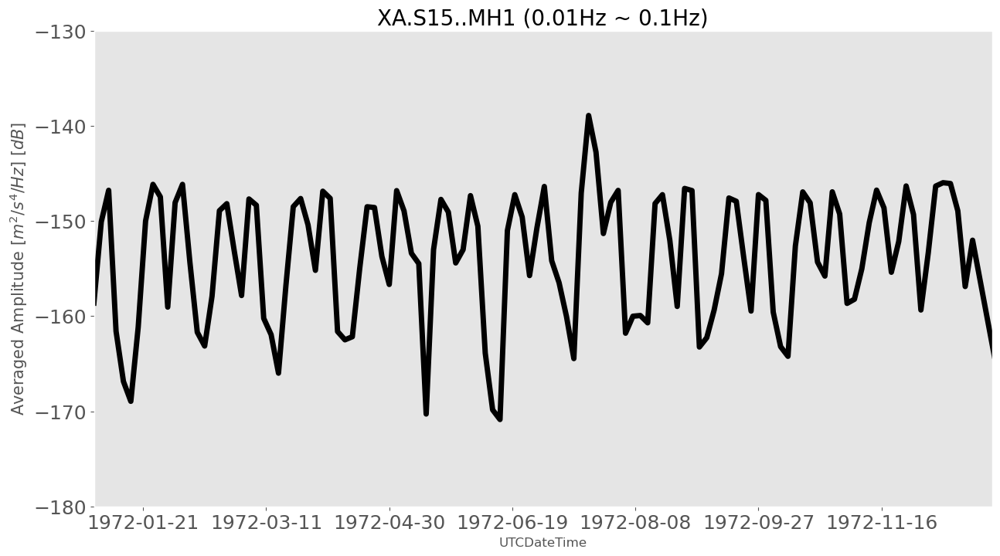

In [24]:
plt.style.use(['ggplot'])

avg_amplitude, time = draw_periodicity2(0.01, 0.1, 15, ylim_min = -180, ylim_max = -130, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_3212\4134508518.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))


1041.6694569339243


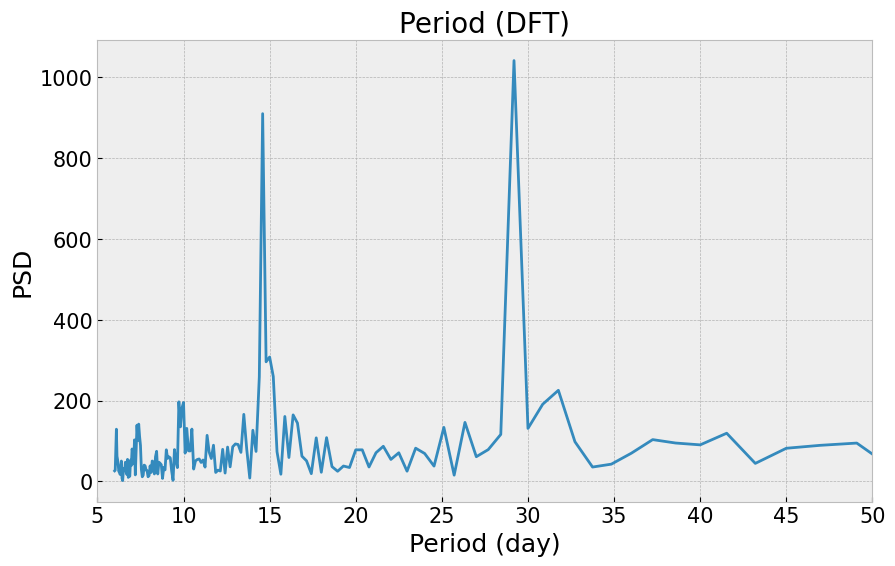

In [20]:
plt.style.use(['default'])
fft(avg_amplitude, time)

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


IndexError: list index out of range

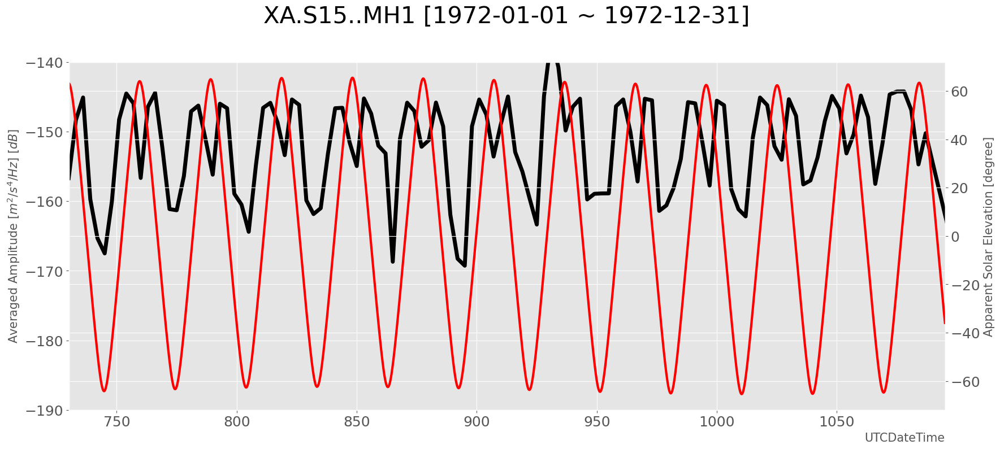

In [28]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 25, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:19: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values
c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]
posx and posy should be finite values


1088.5432775081345


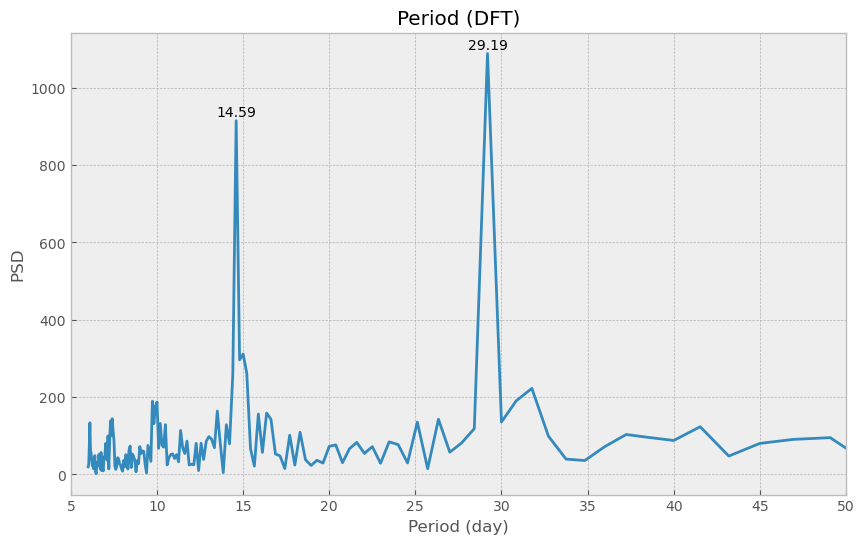

In [159]:
fft(avg_amplitude, time)

---
# 14호, 1972~1975, 시간창 144hour, overlap 75%, 저주파수(0.01~ 0.1), percentage 15% 

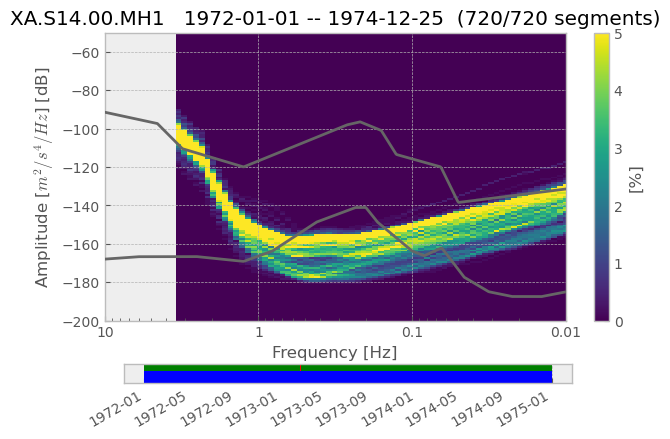

In [160]:
ppsd = PPSD.load_npz('./npz_14_MH1/1972144hr75merged.npz')
ppsd.add_npz('./npz_14_MH1/1973144hr75merged.npz')
ppsd.add_npz('./npz_14_MH1/1974144hr75merged.npz')
ppsd.plot(xaxis_frequency=True, period_lim= (10, 0.01), max_percentage=5, grid=False);

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


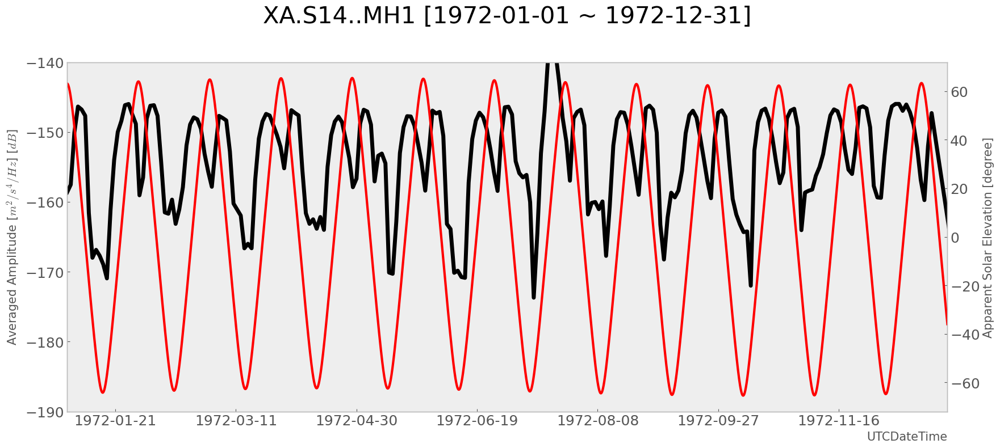

In [161]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 15, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:19: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values
c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]
posx and posy should be finite values


2133.5288361180937


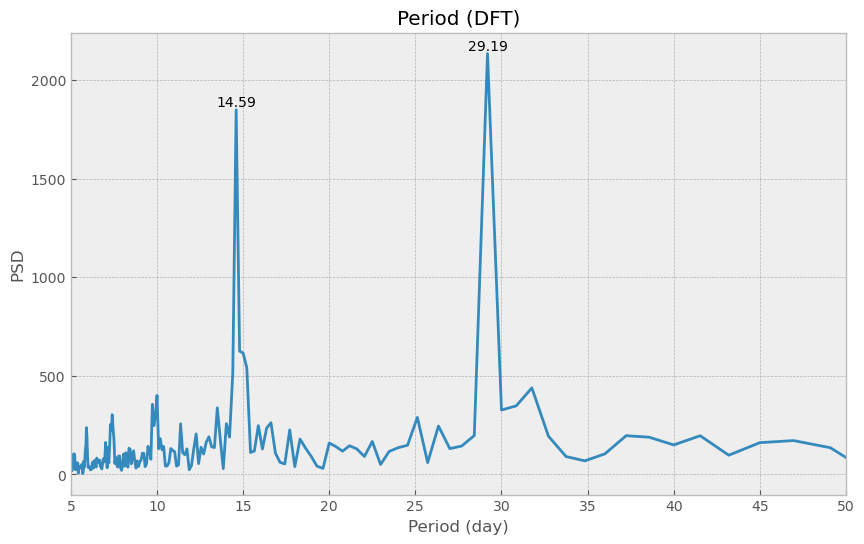

In [162]:
fft(avg_amplitude, time)

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


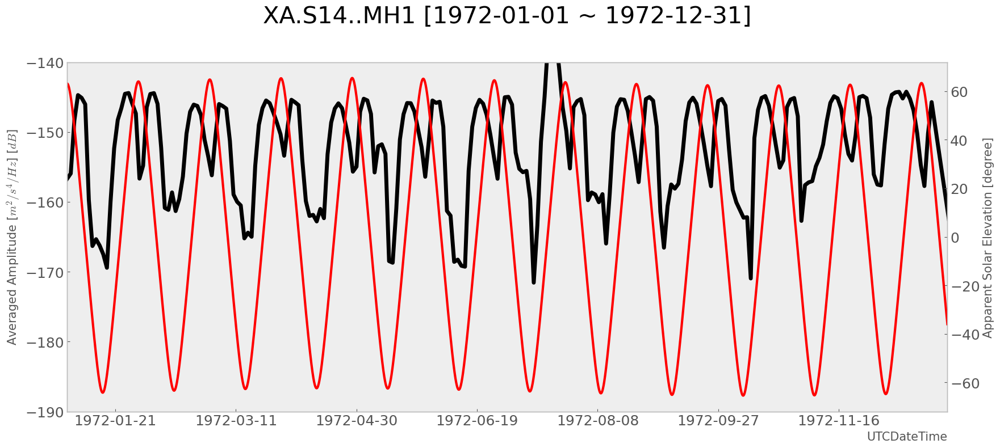

In [163]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 25, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:19: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values
c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]
posx and posy should be finite values


2225.0875314072728


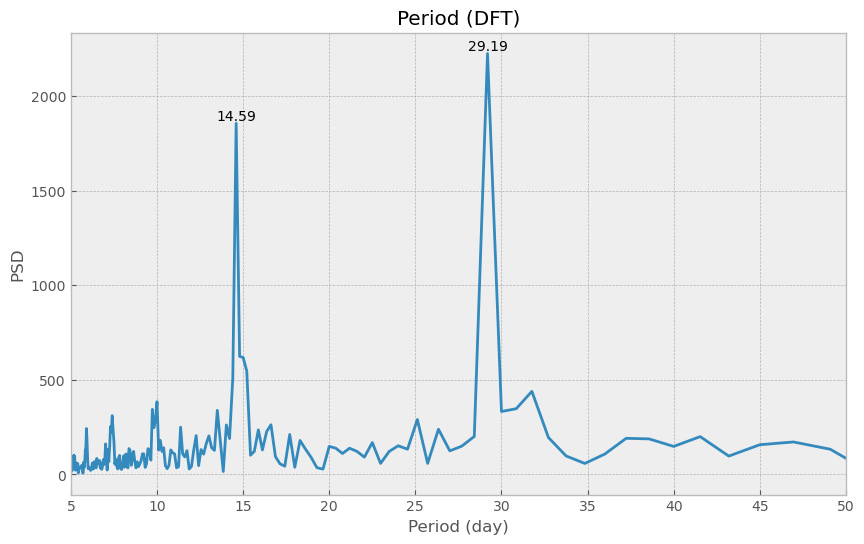

In [164]:
fft(avg_amplitude, time)

---
# 14호, 1972~1975, 시간창 144hour, overlap 80%, 저주파수(0.01~ 0.1), percentage 15% 

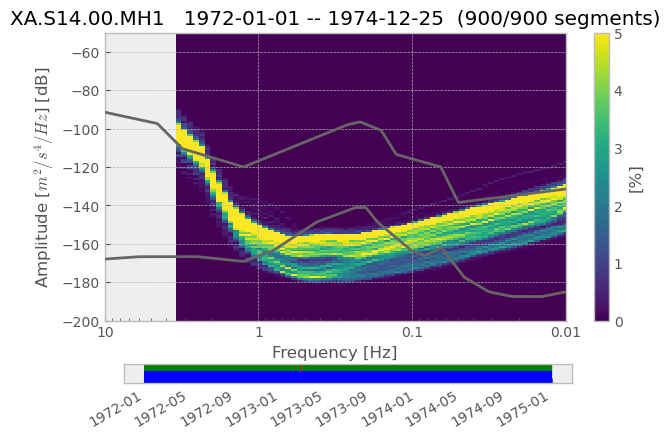

In [165]:
ppsd = PPSD.load_npz('./npz_14_MH1/1972144hr80merged.npz')
ppsd.add_npz('./npz_14_MH1/1973144hr80merged.npz')
ppsd.add_npz('./npz_14_MH1/1974144hr80merged.npz')
ppsd.plot(xaxis_frequency=True, period_lim= (10, 0.01), max_percentage=5, grid=False);

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


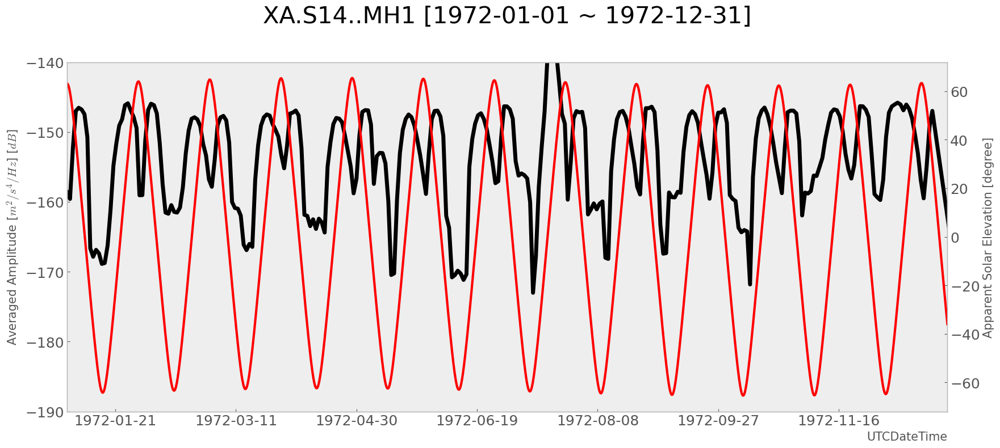

In [166]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 15, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:19: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values
c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]
posx and posy should be finite values


2646.166554617337


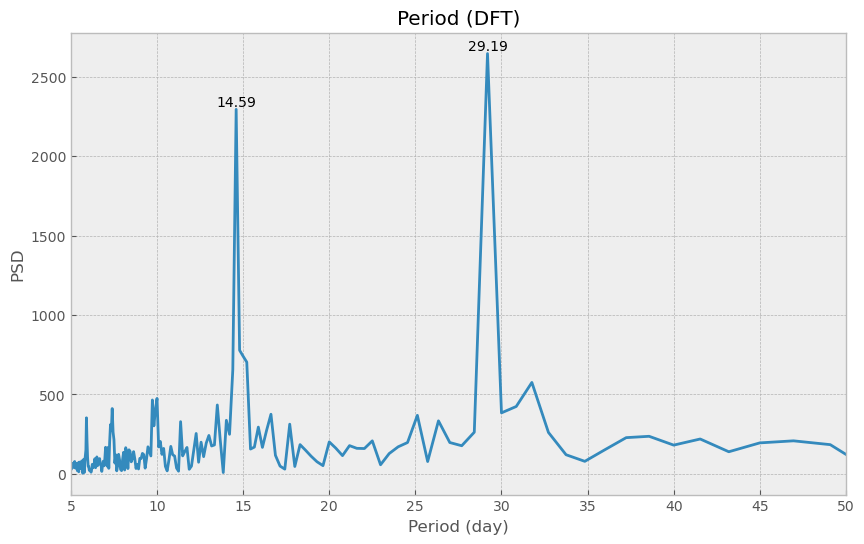

In [167]:
fft(avg_amplitude, time)

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


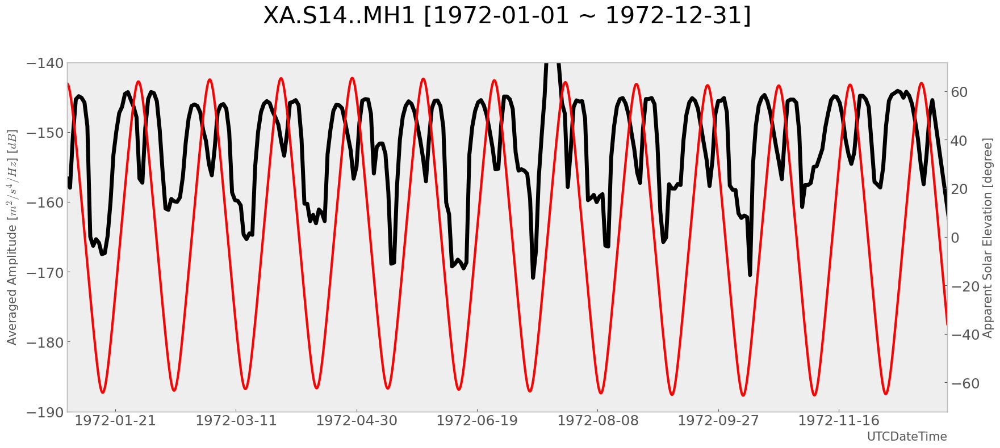

In [168]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 25, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:19: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22084\2858329238.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values
c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]
posx and posy should be finite values


2762.1495369443455


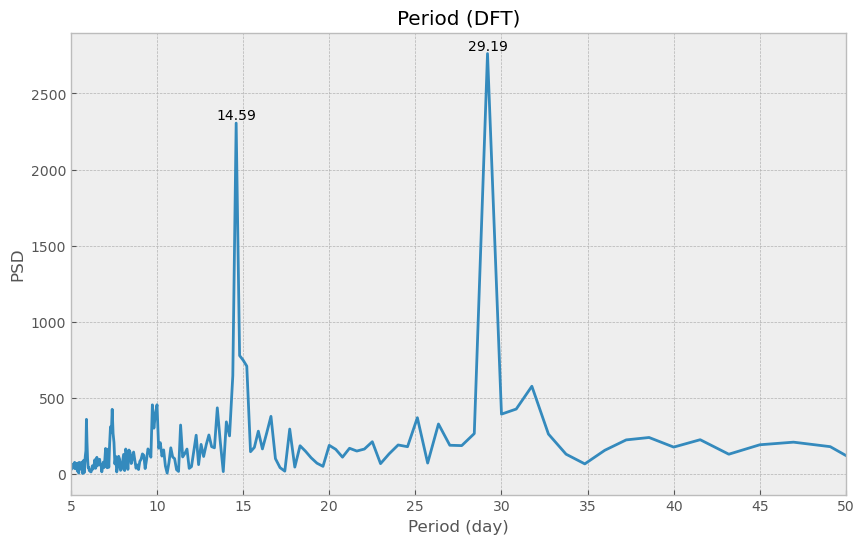

In [169]:
fft(avg_amplitude, time)

---
# 14호, 1972~1975, 시간창 168hour, overlap 50%, 저주파수(0.01~ 0.1), percentage 15% 

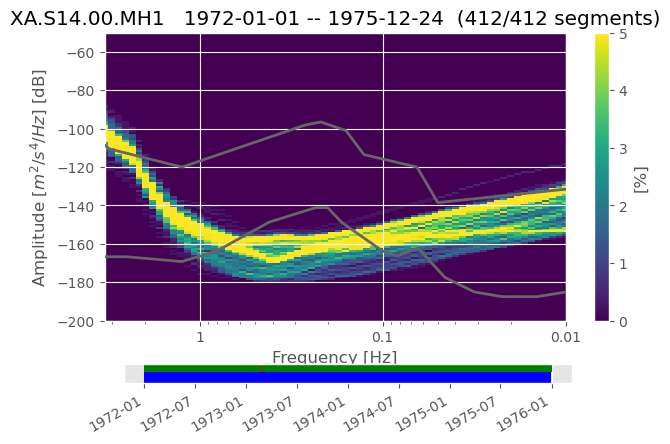

In [22]:
ppsd = PPSD.load_npz('./npz_14_MH1/1972168hrmerged.npz')
ppsd.add_npz('./npz_14_MH1/1973168hrmerged.npz')
ppsd.add_npz('./npz_14_MH1/1974168hrmerged.npz')
ppsd.add_npz('./npz_14_MH1/1975168hrmerged.npz')
ppsd.plot(xaxis_frequency=True, period_lim= (3.3, 0.01), max_percentage=5, grid=False);


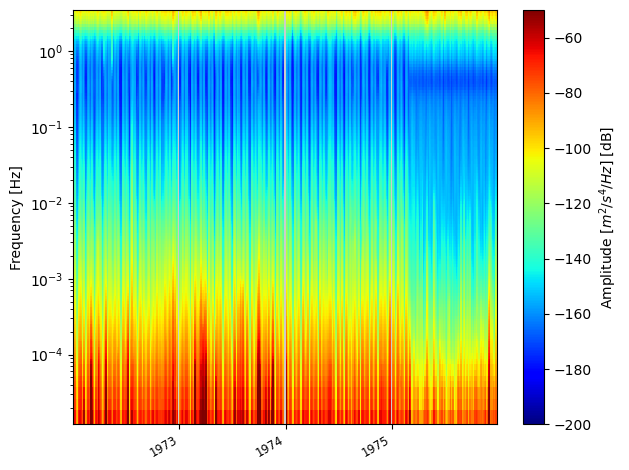

In [7]:
plot_spectrogram2(ppsd, grid=False, cmap='jet', clim = [-200, -50]);

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


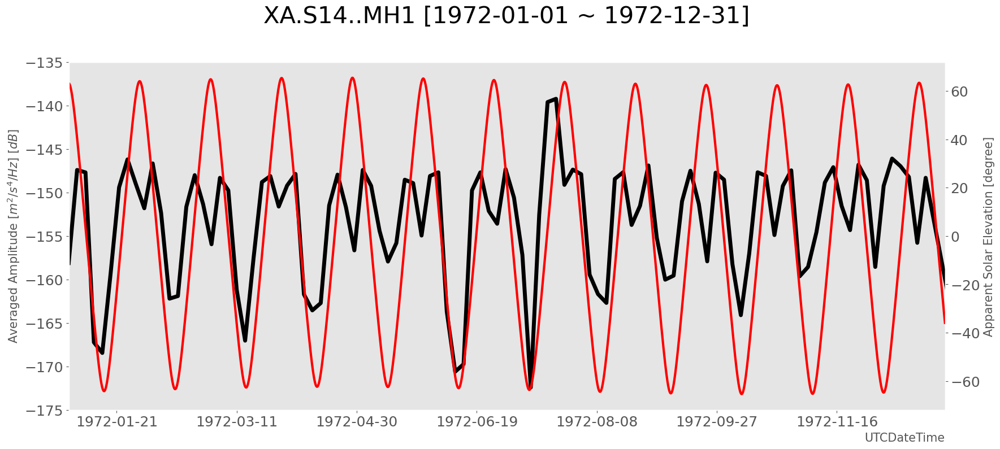

In [23]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 15, ylim_min = -175, ylim_max = -135, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_25256\3825266902.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_25256\3825266902.py:18: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_25256\3825266902.py:21: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values


c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]
posx and posy should be finite values


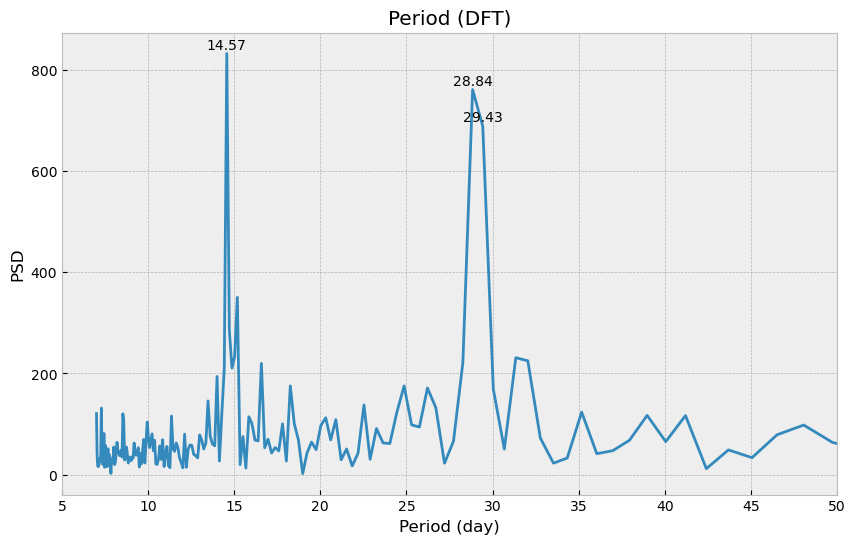

In [36]:
fft(avg_amplitude, time)

In [24]:
a = np.convolve(avg_amplitude, np.ones(3), mode = 'valid') / 3
print(len(a))
b = np.convolve(avg_amplitude, np.ones(5), mode = 'valid') / 5
print(len(b))
c = np.convolve(avg_amplitude, np.ones(7), mode = 'valid') / 7
print(len(c))

410
408
406


In [89]:

(UTCDateTime('1972-03-11T00:00:00.0') - UTCDateTime('1972-01-21T00:00:00.0')) / 60 / 60 / 24

50.0

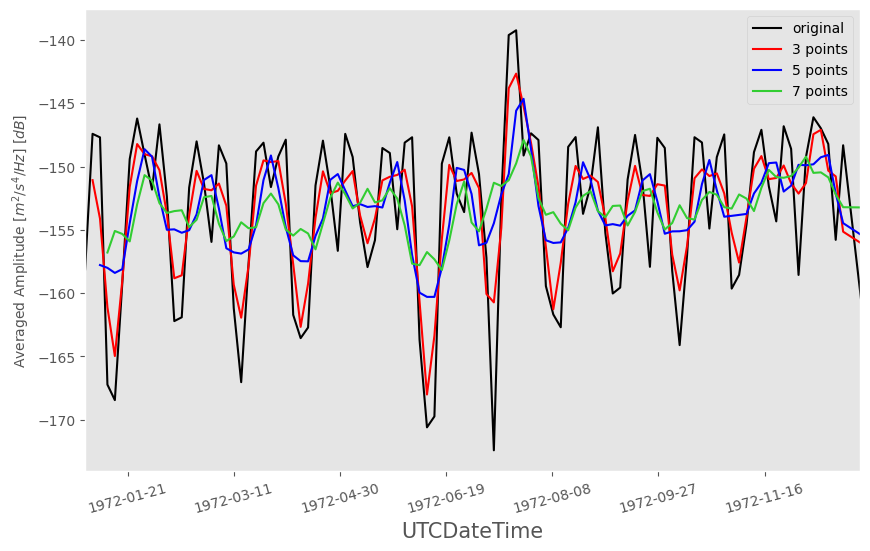

In [35]:
plt.style.use(['ggplot'])
plt.figure(figsize = (10,6))
plt.plot(time, avg_amplitude, label = 'original', color='black')
plt.plot(time[1:-1], a, label = '3 points', color = 'red')
plt.plot(time[2:-2], b, label = '5 points', color = 'blue')
plt.plot(time[3:-3], c, label = '7 points', color = 'limegreen')
plt.legend(loc = 'best')
plt.xlabel('UTCDateTime', size = 15)
plt.ylabel('Averaged Amplitude [$m^2 / s^4 / Hz$] [$dB$]', size = 10)
plt.xlim(730,1095)
plt.xticks([750, 800, 850, 900, 950, 1000, 1050], 
           labels = ['1972-01-21','1972-03-11','1972-04-30','1972-06-19','1972-08-08','1972-09-27','1972-11-16'], rotation = 15, fontsize = 10)
plt.grid(False)
plt.show()

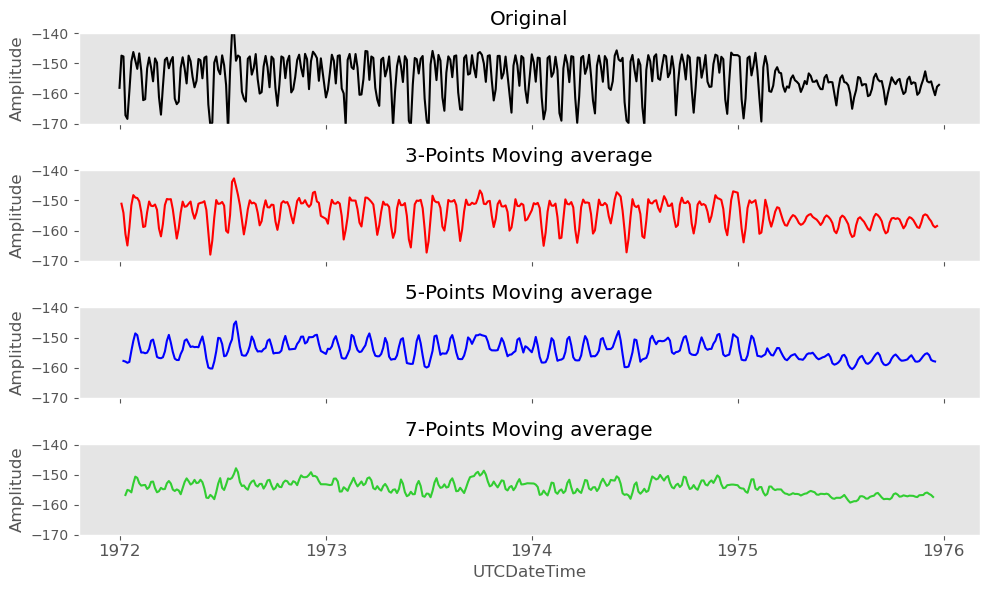

In [36]:
fig, ax = plt.subplots(4, 1, sharex=True, figsize = (10,6))
plt.style.use(['ggplot'])

ax[0].plot(time, avg_amplitude, 'black')
ax[1].plot(time[1:-1], a, 'red')
ax[2].plot(time[2:-2], b, 'blue')
ax[3].plot(time[3:-3], c, 'limegreen')

ax[0].set_title('Original')
ax[1].set_title('3-Points Moving average')
ax[2].set_title('5-Points Moving average')
ax[3].set_title('7-Points Moving average')

ax[0].set_ylabel('Amplitude')
ax[1].set_ylabel('Amplitude')
ax[2].set_ylabel('Amplitude')
ax[3].set_ylabel('Amplitude')
ax[3].set_xlabel('UTCDateTime')

ax[0].set_ylim(-170, -140)
ax[1].set_ylim(-170, -140)
ax[2].set_ylim(-170, -140)
ax[3].set_ylim(-170, -140)

ax[0].grid(False)
ax[1].grid(False)
ax[2].grid(False)
ax[3].grid(False)

ax[3].set_xticks([730, 1096, 1096+365, 1096+365+365, 1096+365+365+365])
ax[3].set_xticklabels(['1972', '1973', '1974', '1975','1976'], fontsize = 12)

plt.tight_layout()
plt.show()

C:\Users\neimb\AppData\Local\Temp\ipykernel_25256\3935406928.py:7: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_25256\3935406928.py:16: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_25256\3935406928.py:19: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values
c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]
posx and posy should be finite values


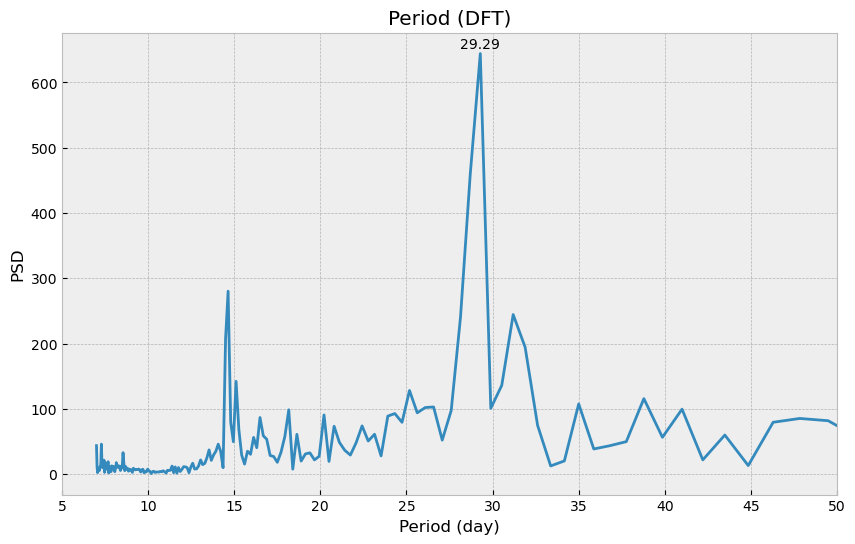

In [115]:
# 3점평귡
plt.style.use(['bmh'])
dft = np.fft.rfft(a)
freqs = np.fft.rfftfreq(len(a), d=time[1]-time[0])

plt.figure(figsize=(10, 6))
plt.plot(1/freqs, np.abs(dft))
plt.title('Period (DFT)')
plt.xlabel('Period (day)')
plt.ylabel('PSD')
#plt.xticks([0.25, 0.50, 0.75, 1.00, 1.25, 1.50, 1.75, 2.00])
#plt.xscale('log')
plt.xlim(5, 50.0)
plt.grid(True)

for i in range(len(1/freqs)):
        height = np.abs(dft)[i]
        if height >= 500: 
            plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
plt.show()

---
# 14호, 1972~1975, 시간창 168hour, overlap 50%, 저주파수(0.01~ 0.1), percentage 25% 

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


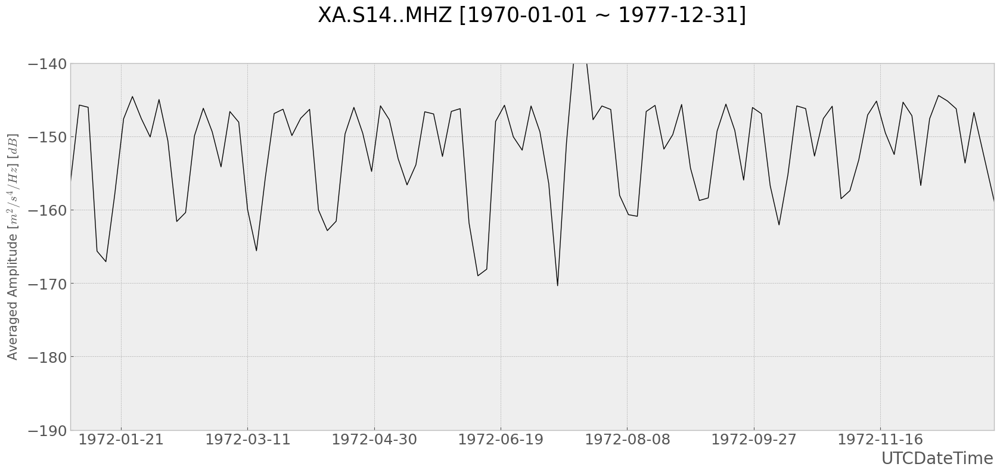

In [39]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 25, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22932\2153210626.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))


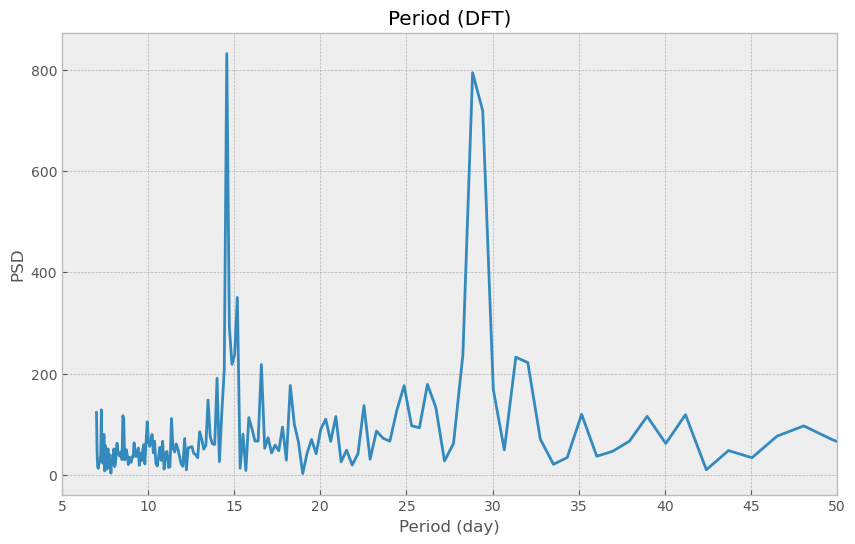

In [40]:
fft(avg_amplitude, time)

In [41]:
a = np.convolve(avg_amplitude, np.ones(3), mode = 'valid') / 3
print(len(a))
b = np.convolve(avg_amplitude, np.ones(5), mode = 'valid') / 5
print(len(b))
c = np.convolve(avg_amplitude, np.ones(7), mode = 'valid') / 7
print(len(c))

410
408
406


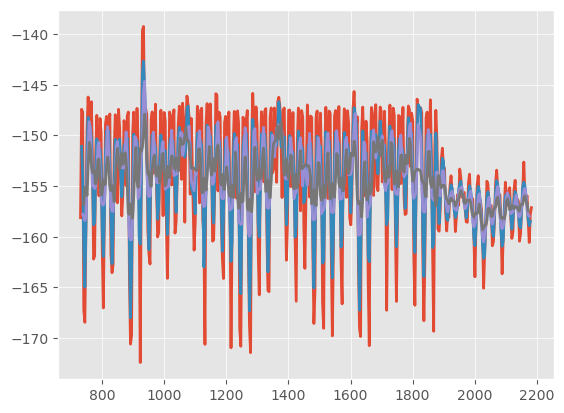

In [89]:
plt.plot(time, avg_amplitude)
plt.plot(time[1:-1], a)
plt.plot(time[2:-2], b)
plt.plot(time[3:-3], c)

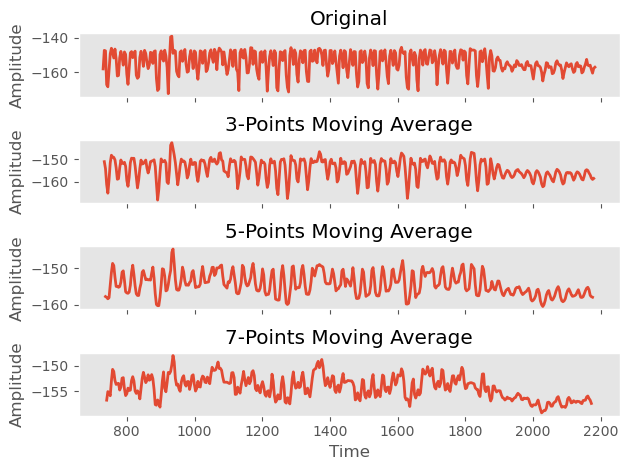

In [91]:
fig, ax = plt.subplots(4, 1, sharex=True)

ax[0].plot(time, avg_amplitude)
ax[1].plot(time[1:-1], a)
ax[2].plot(time[2:-2], b)
ax[3].plot(time[3:-3], c)

ax[0].set_title('Original')
ax[1].set_title('3-Points Moving Average')
ax[2].set_title('5-Points Moving Average')
ax[3].set_title('7-Points Moving Average')

ax[0].set_ylabel('Amplitude')
ax[1].set_ylabel('Amplitude')
ax[2].set_ylabel('Amplitude')
ax[3].set_ylabel('Amplitude')
ax[3].set_xlabel('Time')

ax[0].grid(False)
ax[1].grid(False)
ax[2].grid(False)
ax[3].grid(False)

plt.tight_layout()
plt.show()

C:\Users\neimb\AppData\Local\Temp\ipykernel_22932\3935406928.py:7: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22932\3935406928.py:16: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_22932\3935406928.py:19: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values
c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]
posx and posy should be finite values


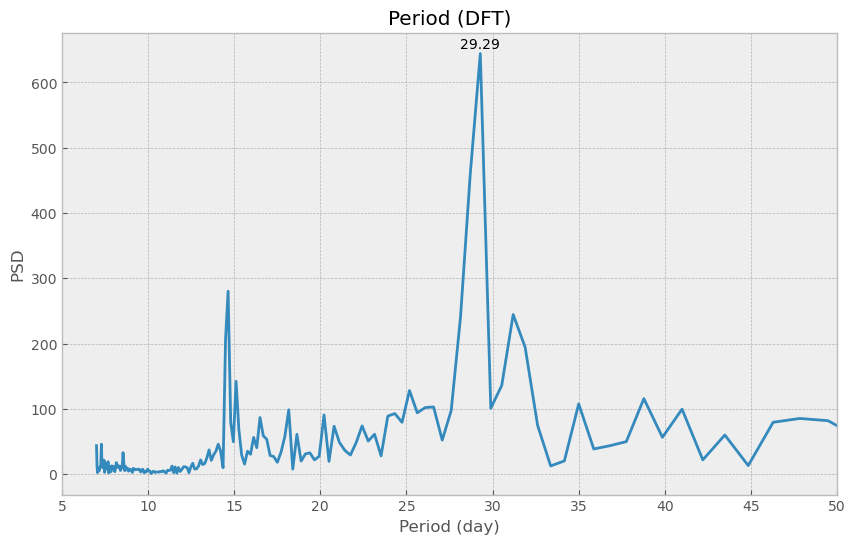

In [93]:
# 3점평귡
plt.style.use(['bmh'])
dft = np.fft.rfft(a)
freqs = np.fft.rfftfreq(len(a), d=time[1]-time[0])

plt.figure(figsize=(10, 6))
plt.plot(1/freqs, np.abs(dft))
plt.title('Period (DFT)')
plt.xlabel('Period (day)')
plt.ylabel('PSD')
#plt.xticks([0.25, 0.50, 0.75, 1.00, 1.25, 1.50, 1.75, 2.00])
#plt.xscale('log')
plt.xlim(5, 50.0)
plt.grid(True)

for i in range(len(1/freqs)):
        height = np.abs(dft)[i]
        if height >= 500: 
            plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
plt.show()

C:\Users\neimb\AppData\Local\Temp\ipykernel_22932\1718314151.py:6: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22932\1718314151.py:12: UserWarning: Attempt to set non-positive xlim on a log-scaled axis will be ignored.
  plt.xlim(0, 100.0)


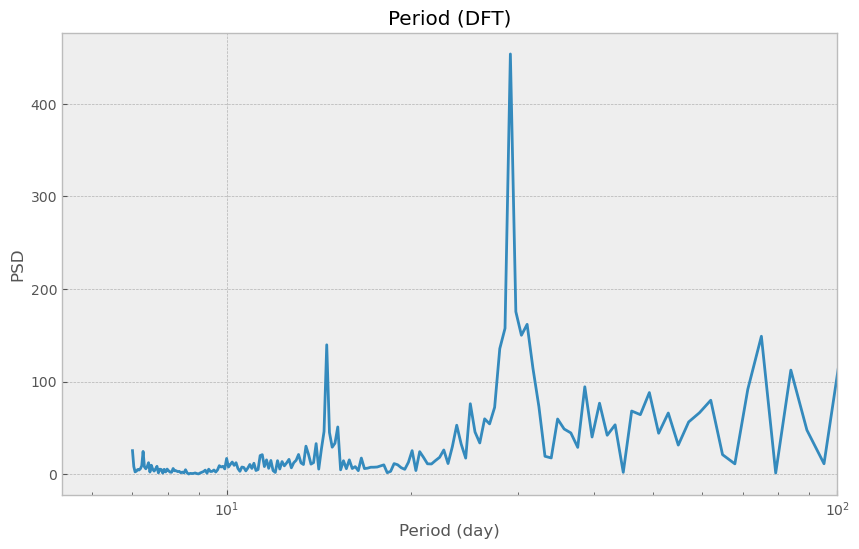

In [44]:
# 5점평귡
dft = np.fft.rfft(b)
freqs = np.fft.rfftfreq(len(b), d=time[1]-time[0])

plt.figure(figsize=(10, 6))
plt.plot(1/freqs, np.abs(dft))
plt.title('Period (DFT)')
plt.xlabel('Period (day)')
plt.ylabel('PSD')
#plt.xticks([0.25, 0.50, 0.75, 1.00, 1.25, 1.50, 1.75, 2.00])
#plt.xscale('log')
plt.xlim(5, 50.0)
plt.grid(True)
plt.show()

C:\Users\neimb\AppData\Local\Temp\ipykernel_22932\410978052.py:6: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))
C:\Users\neimb\AppData\Local\Temp\ipykernel_22932\410978052.py:12: UserWarning: Attempt to set non-positive xlim on a log-scaled axis will be ignored.
  plt.xlim(0, 100.0)


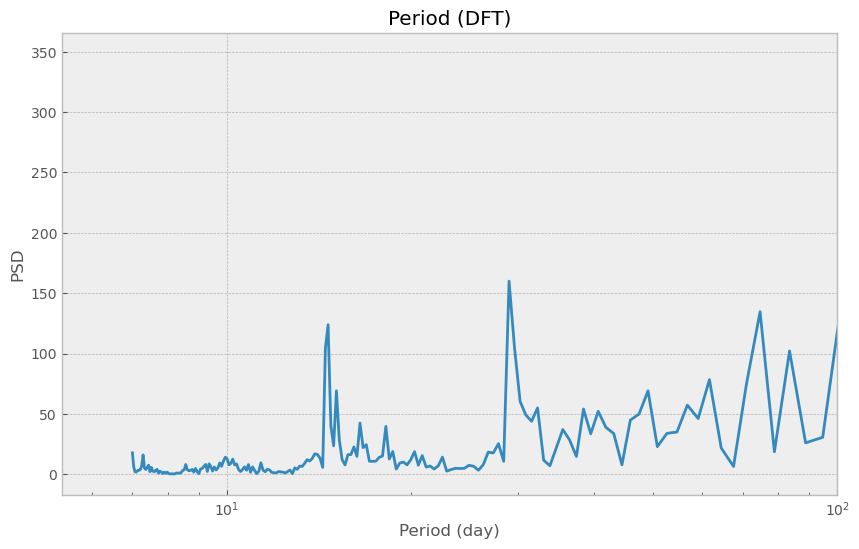

In [45]:
# 7점평귡
dft = np.fft.rfft(c)
freqs = np.fft.rfftfreq(len(c), d=time[1]-time[0])

plt.figure(figsize=(10, 6))
plt.plot(1/freqs, np.abs(dft))
plt.title('Period (DFT)')
plt.xlabel('Period (day)')
plt.ylabel('PSD')
#plt.xticks([0.25, 0.50, 0.75, 1.00, 1.25, 1.50, 1.75, 2.00])
#plt.xscale('log')
plt.xlim(5, 50.0)
plt.grid(True)
plt.show()

---
# 14호, 1972~1975, 시간창 168hour, overlap 75%, 저주파수(0.01~ 0.1), percentage 15% 

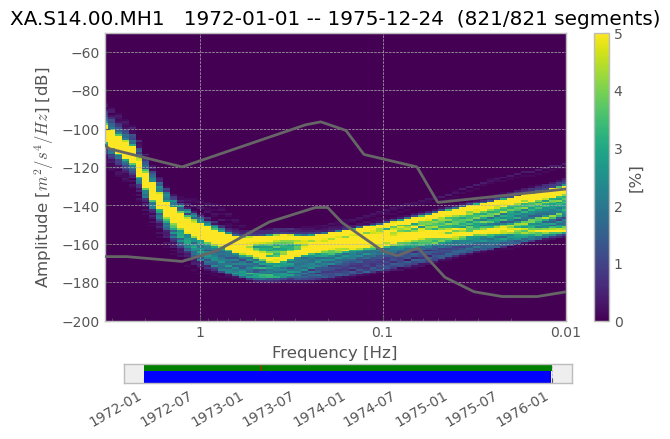

In [47]:
ppsd = PPSD.load_npz('./npz_14_MH1/1972168hr75merged.npz')
ppsd.add_npz('./npz_14_MH1/1973168hr75merged.npz')
ppsd.add_npz('./npz_14_MH1/1974168hr75merged.npz')
ppsd.add_npz('./npz_14_MH1/1975168hr75merged.npz')
ppsd.plot(xaxis_frequency=True, period_lim= (3.3, 0.01), max_percentage=5, grid=False);

In [ ]:
plot_spectrogram2(ppsd, grid=False, cmap='jet', clim = [-200, -50]);

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


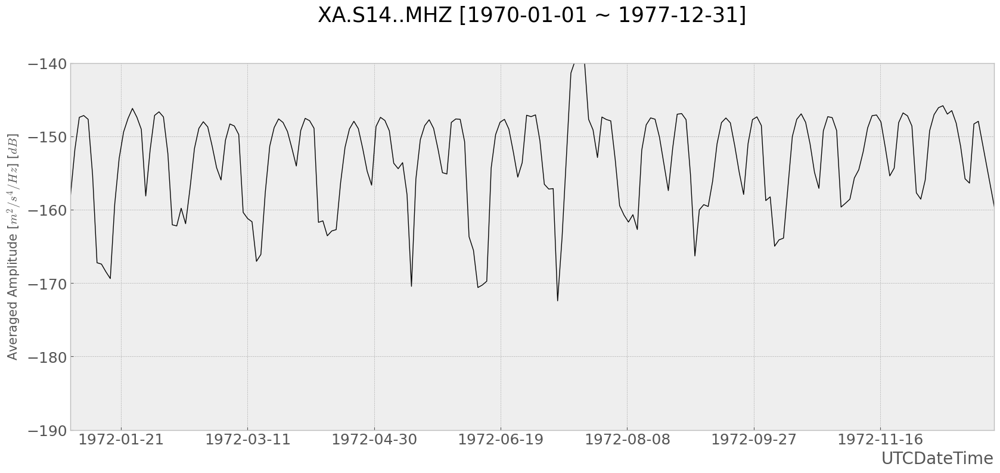

In [48]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 15, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22932\2153210626.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))


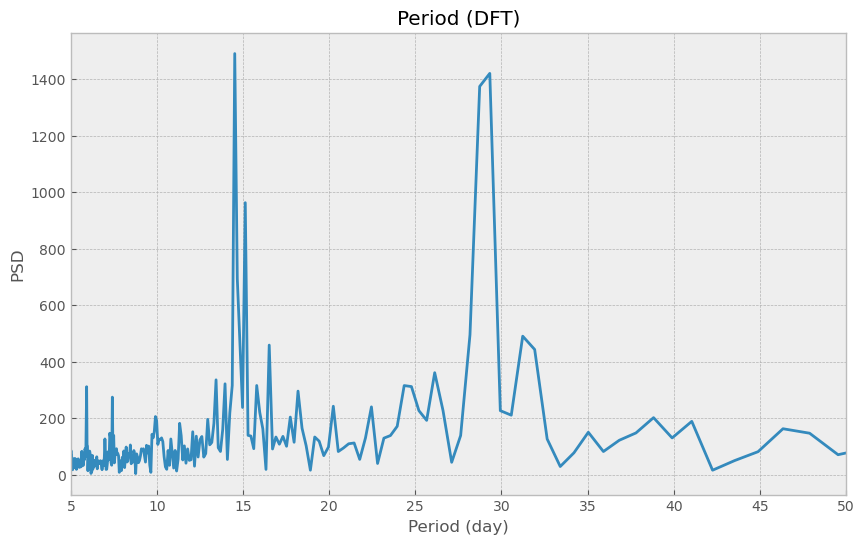

In [49]:
fft(avg_amplitude, time)

---
# 14호, 1972~1975, 시간창 168hour, overlap 75%, 저주파수(0.01~ 0.1), percentage 25% 

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


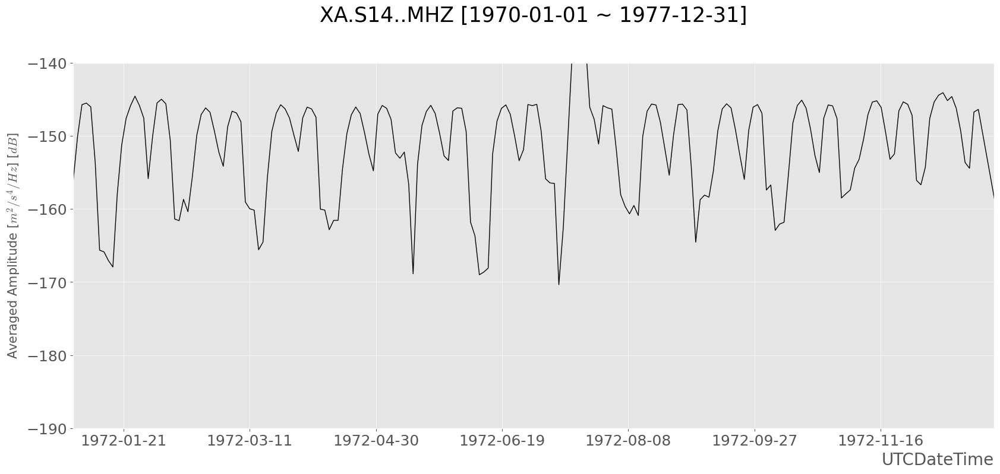

In [51]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 25, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_22932\2153210626.py:8: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft))


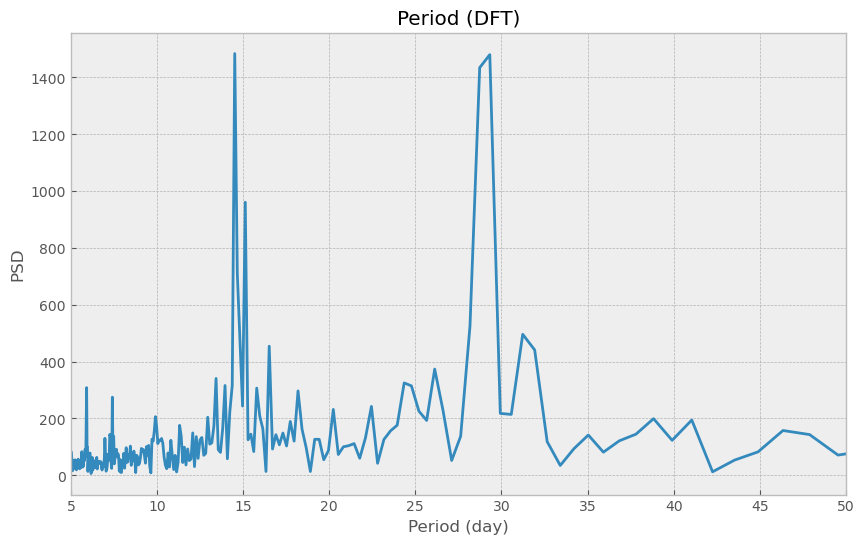

In [52]:
fft(avg_amplitude, time)

---
# 12호, 1970~1973, 시간창 168hour, overlap 80%, 저주파수(0.01~ 0.1), percentage 15% 

In [53]:
ppsd = PPSD.load_npz('./npz_14_MH1/1972168hr80merged.npz')
ppsd.add_npz('./npz_14_MH1/1973168hr80merged.npz')
ppsd.add_npz('./npz_14_MH1/1974168hr80merged.npz')
ppsd.add_npz('./npz_14_MH1/1975168hr80merged.npz')
ppsd.plot(xaxis_frequency=True, period_lim= (3.3, 0.01), max_percentage=5, grid=False);

FileNotFoundError: [Errno 2] No such file or directory: './npz_14_MH1/1972168hr80merged.npz'

In [ ]:
plot_spectrogram2(ppsd, grid=False, cmap='jet', clim = [-200, -50]);

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


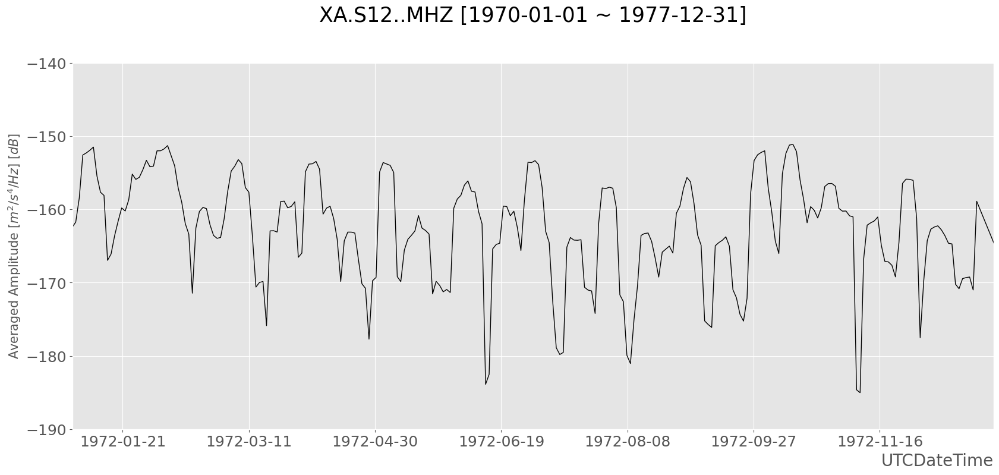

In [160]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 15, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_18980\82587432.py:6: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft), 'ro--')
C:\Users\neimb\AppData\Local\Temp\ipykernel_18980\82587432.py:16: RuntimeWarning: divide by zero encountered in divide
  for i in range(len(1/freqs)):
C:\Users\neimb\AppData\Local\Temp\ipykernel_18980\82587432.py:19: RuntimeWarning: divide by zero encountered in scalar divide
  plt.text(1/freqs[i], height + 3, np.round(1/freqs[i],2), ha='center', va='bottom', size = 10)
posx and posy should be finite values
c:\Users\neimb\anaconda3\Lib\site-packages\matplotlib\transforms.py:354: RuntimeWarning: invalid value encountered in scalar subtract
  return points[1, 0] - points[0, 0]
posx and posy should be finite values


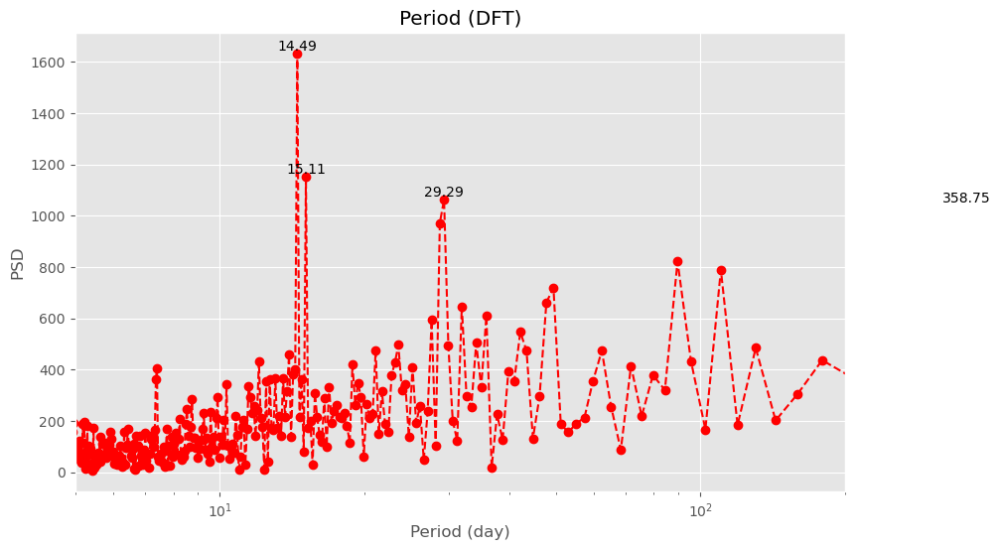

In [161]:
fft(avg_amplitude, time)

---
# 12호, 1970~1973, 시간창 168hour, overlap 80%, 저주파수(0.01~ 0.1), percentage 25% 

(array([41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57,
       58, 59, 60, 61, 62, 63, 64, 65, 66], dtype=int64),)


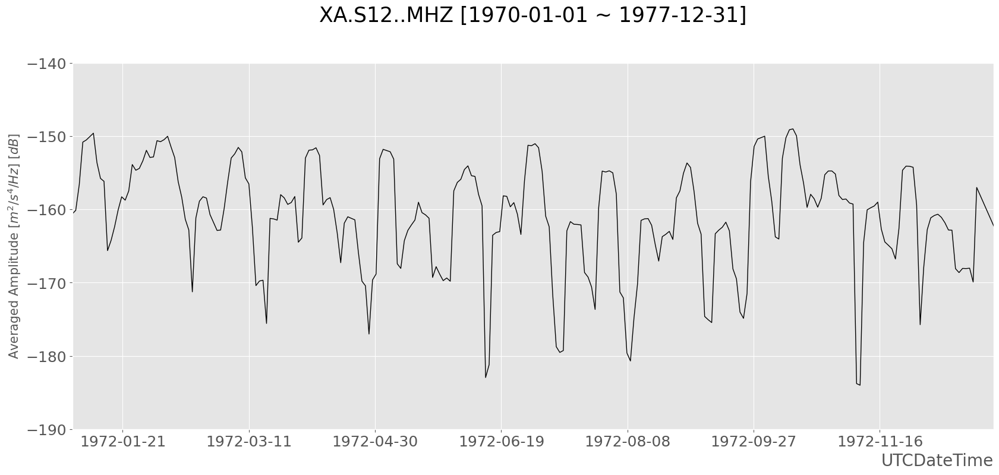

In [155]:
avg_amplitude, time = draw_periodicity(0.01, 0.1, 25, ylim_min = -190, ylim_max = -140, xlim_max = 1095, xlim_min = 730)

C:\Users\neimb\AppData\Local\Temp\ipykernel_18980\2708949311.py:6: RuntimeWarning: divide by zero encountered in divide
  plt.plot(1/freqs, np.abs(dft), 'ro--')


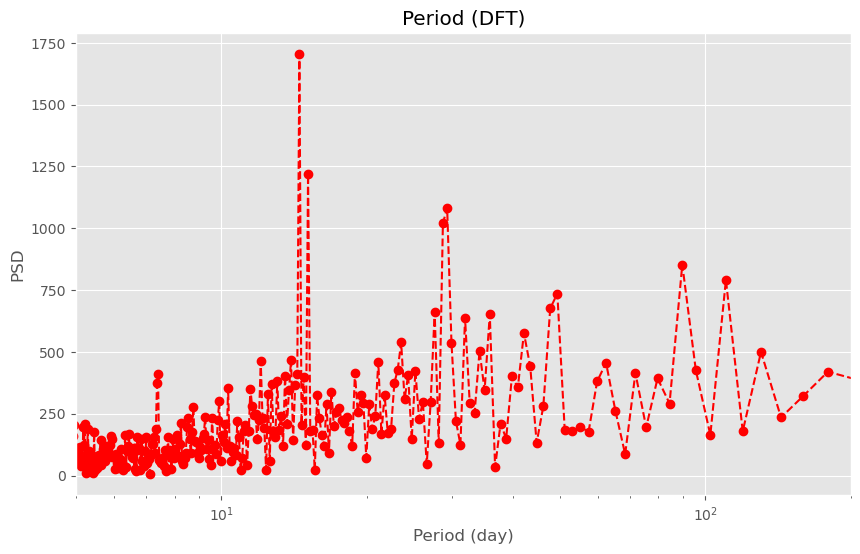

In [156]:
fft(avg_amplitude, time)